<div style="text-align:center">
    <h1>
        Deep Q-Learning
    </h1>
</div>

<br><br>

<div style="text-align:center">

In this notebook, we extend the Q-Learning algorithm to use function approximators (Neural Networks). The resulting algorithm is known as Deep Q-Learning.
</div>



<br>

In [1]:
# @title Setup code (not important) - Run this cell by pressing "Shift + Enter"



# !pip install -qq gym==0.23.0


from typing import Tuple, Dict, Optional, Iterable, Callable

import numpy as np
import seaborn as sns
import matplotlib
import torch
from matplotlib import animation
import matplotlib.patches as mpatches

from IPython.display import HTML

import gym
from gym import spaces
from gym.error import DependencyNotInstalled

import pygame
from pygame import gfxdraw


class Maze(gym.Env):

    def __init__(self, exploring_starts: bool = False,
                 shaped_rewards: bool = False, size: int = 5) -> None:
        super().__init__()
        self.exploring_starts = exploring_starts
        self.shaped_rewards = shaped_rewards
        self.state = (size - 1, size - 1)
        self.goal = (size - 1, size - 1)
        self.maze = self._create_maze(size=size)
        self.distances = self._compute_distances(self.goal, self.maze)
        self.action_space = spaces.Discrete(n=4)
        self.action_space.action_meanings = {0: 'UP', 1: 'RIGHT', 2: 'DOWN', 3: "LEFT"}
        self.observation_space = spaces.MultiDiscrete([size, size])

        self.screen = None
        self.agent_transform = None

    def step(self, action: int) -> Tuple[Tuple[int, int], float, bool, Dict]:
        reward = self.compute_reward(self.state, action)
        self.state = self._get_next_state(self.state, action)
        done = self.state == self.goal
        info = {}
        return self.state, reward, done, info

    def reset(self) -> Tuple[int, int]:
        if self.exploring_starts:
            while self.state == self.goal:
                self.state = tuple(self.observation_space.sample())
        else:
            self.state = (0, 0)
        return self.state

    def render(self, mode: str = 'human') -> Optional[np.ndarray]:
        assert mode in ['human', 'rgb_array']

        screen_size = 600
        scale = screen_size / 5

        if self.screen is None:
            pygame.init()
            self.screen = pygame.Surface((screen_size, screen_size))

        surf = pygame.Surface((screen_size, screen_size))
        surf.fill((22, 36, 71))


        for row in range(5):
            for col in range(5):

                state = (row, col)
                for next_state in [(row + 1, col), (row - 1, col), (row, col + 1), (row, col - 1)]:
                    if next_state not in self.maze[state]:

                        # Add the geometry of the edges and walls (i.e. the boundaries between
                        # adjacent squares that are not connected).
                        row_diff, col_diff = np.subtract(next_state, state)
                        left = (col + (col_diff > 0)) * scale - 2 * (col_diff != 0)
                        right = ((col + 1) - (col_diff < 0)) * scale + 2 * (col_diff != 0)
                        top = (5 - (row + (row_diff > 0))) * scale - 2 * (row_diff != 0)
                        bottom = (5 - ((row + 1) - (row_diff < 0))) * scale + 2 * (row_diff != 0)

                        gfxdraw.filled_polygon(surf, [(left, bottom), (left, top), (right, top), (right, bottom)], (255, 255, 255))

        # Add the geometry of the goal square to the viewer.
        left, right, top, bottom = scale * 4 + 10, scale * 5 - 10, scale - 10, 10
        gfxdraw.filled_polygon(surf, [(left, bottom), (left, top), (right, top), (right, bottom)], (40, 199, 172))

        # Add the geometry of the agent to the viewer.
        agent_row = int(screen_size - scale * (self.state[0] + .5))
        agent_col = int(scale * (self.state[1] + .5))
        gfxdraw.filled_circle(surf, agent_col, agent_row, int(scale * .6 / 2), (228, 63, 90))

        surf = pygame.transform.flip(surf, False, True)
        self.screen.blit(surf, (0, 0))

        return np.transpose(
                np.array(pygame.surfarray.pixels3d(self.screen)), axes=(1, 0, 2)
            )

    def close(self) -> None:
        if self.screen is not None:
            pygame.display.quit()
            pygame.quit()
            self.screen = None

    def compute_reward(self, state: Tuple[int, int], action: int) -> float:
        next_state = self._get_next_state(state, action)
        if self.shaped_rewards:
            return - (self.distances[next_state] / self.distances.max())
        return - float(state != self.goal)

    def simulate_step(self, state: Tuple[int, int], action: int):
        reward = self.compute_reward(state, action)
        next_state = self._get_next_state(state, action)
        done = next_state == self.goal
        info = {}
        return next_state, reward, done, info

    def _get_next_state(self, state: Tuple[int, int], action: int) -> Tuple[int, int]:
        if action == 0:
            next_state = (state[0] - 1, state[1])
        elif action == 1:
            next_state = (state[0], state[1] + 1)
        elif action == 2:
            next_state = (state[0] + 1, state[1])
        elif action == 3:
            next_state = (state[0], state[1] - 1)
        else:
            raise ValueError("Action value not supported:", action)
        if next_state in self.maze[state]:
            return next_state
        return state

    @staticmethod
    def _create_maze(size: int) -> Dict[Tuple[int, int], Iterable[Tuple[int, int]]]:
        maze = {(row, col): [(row - 1, col), (row + 1, col), (row, col - 1), (row, col + 1)]
                for row in range(size) for col in range(size)}

        left_edges = [[(row, 0), (row, -1)] for row in range(size)]
        right_edges = [[(row, size - 1), (row, size)] for row in range(size)]
        upper_edges = [[(0, col), (-1, col)] for col in range(size)]
        lower_edges = [[(size - 1, col), (size, col)] for col in range(size)]
        walls = [
            [(1, 0), (1, 1)], [(2, 0), (2, 1)], [(3, 0), (3, 1)],
            [(1, 1), (1, 2)], [(2, 1), (2, 2)], [(3, 1), (3, 2)],
            [(3, 1), (4, 1)], [(0, 2), (1, 2)], [(1, 2), (1, 3)],
            [(2, 2), (3, 2)], [(2, 3), (3, 3)], [(2, 4), (3, 4)],
            [(4, 2), (4, 3)], [(1, 3), (1, 4)], [(2, 3), (2, 4)],
        ]

        obstacles = upper_edges + lower_edges + left_edges + right_edges + walls

        for src, dst in obstacles:
            maze[src].remove(dst)

            if dst in maze:
                maze[dst].remove(src)

        return maze

    @staticmethod
    def _compute_distances(goal: Tuple[int, int],
                           maze: Dict[Tuple[int, int], Iterable[Tuple[int, int]]]) -> np.ndarray:
        distances = np.full((5, 5), np.inf)
        visited = set()
        distances[goal] = 0.

        while visited != set(maze):
            sorted_dst = [(v // 5, v % 5) for v in distances.argsort(axis=None)]
            closest = next(x for x in sorted_dst if x not in visited)
            visited.add(closest)

            for neighbour in maze[closest]:
                distances[neighbour] = min(distances[neighbour], distances[closest] + 1)
        return distances


def display_video(frames):
    # Copied from: https://colab.research.google.com/github/deepmind/dm_control/blob/master/tutorial.ipynb
    orig_backend = matplotlib.get_backend()
    matplotlib.use('Agg')
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    matplotlib.use(orig_backend)
    ax.set_axis_off()
    ax.set_aspect('equal')
    ax.set_position([0, 0, 1, 1])
    im = ax.imshow(frames[0])
    def update(frame):
        im.set_data(frame)
        return [im]
    anim = animation.FuncAnimation(fig=fig, func=update, frames=frames,
                                    interval=50, blit=True, repeat=False)
    return HTML(anim.to_html5_video())


def test_agent(env, policy, episodes=10):
    frames = []
    for episode in range(episodes):
        state = env.reset()
        done = False
        frames.append(env.render(mode="rgb_array"))

        while not done:
            p = policy(state)
            if isinstance(p, np.ndarray):
                action = np.random.choice(4, p=p)
            else:
                action = p
            next_state, reward, done, extra_info = env.step(action)
            img = env.render(mode="rgb_array")
            frames.append(img)
            state = next_state

    return display_video(frames)


def seed_everything(env: gym.Env, seed: int = 42) -> None:
    env.seed(seed)
    env.action_space.seed(seed)
    env.observation_space.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.use_deterministic_algorithms(True)


def plot_stats(stats):
    rows = len(stats)
    cols = 1

    fig, ax = plt.subplots(rows, cols, figsize=(12, 6))

    for i, key in enumerate(stats):
        vals = stats[key]
        vals = [np.mean(vals[i-10:i+10]) for i in range(10, len(vals)-10)]
        if len(stats) > 1:
            ax[i].plot(range(len(vals)), vals)
            ax[i].set_title(key, size=18)
        else:
            ax.plot(range(len(vals)), vals)
            ax.set_title(key, size=18)
    plt.tight_layout()
    plt.show()


def plot_cost_to_go(env, q_network, xlabel=None, ylabel=None):
    highx, highy = env.observation_space.high
    lowx, lowy = env.observation_space.low
    X = torch.linspace(lowx, highx, 100)
    Y = torch.linspace(lowy, highy, 100)
    X, Y = torch.meshgrid(X, Y)

    q_net_input = torch.stack([X.flatten(), Y.flatten()], dim=-1)
    Z = - q_network(q_net_input).max(dim=-1, keepdim=True)[0]
    Z = Z.reshape(100, 100).detach().numpy()
    X = X.numpy()
    Y = Y.numpy()

    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(X, Y, Z, cmap='jet', linewidth=0, antialiased=False)
    fig.colorbar(surf, shrink=0.5, aspect=5)
    ax.set_xlabel(xlabel, size=14)
    ax.set_ylabel(ylabel, size=14)
    ax.set_title("Estimated cost-to-go", size=18)
    plt.tight_layout()
    plt.show()


def plot_max_q(env, q_network, xlabel=None, ylabel=None, action_labels=[]):
    highx, highy = env.observation_space.high
    lowx, lowy = env.observation_space.low
    X = torch.linspace(lowx, highx, 100)
    Y = torch.linspace(lowy, highy, 100)
    X, Y = torch.meshgrid(X, Y)
    q_net_input = torch.stack([X.flatten(), Y.flatten()], dim=-1)
    Z = q_network(q_net_input).argmax(dim=-1, keepdim=True)
    Z = Z.reshape(100, 100).T.detach().numpy()
    values = np.unique(Z.ravel())
    values.sort()

    plt.figure(figsize=(5, 5))
    plt.xlabel(xlabel, size=14)
    plt.ylabel(ylabel, size=14)
    plt.title("Optimal action", size=18)

    im = plt.imshow(Z, cmap='jet')
    colors = [im.cmap(im.norm(value)) for value in values]
    patches = [mpatches.Patch(color=color, label=label) for color, label in zip(colors, action_labels)]
    plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.tight_layout()



d:\anaconda3\Lib\site-packages\pygame\pkgdata.py:25: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources import resource_stream, resource_exists
d:\anaconda3\Lib\site-packages\pkg_resources\__init__.py:3117: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('mpl_toolkits')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptools.pypa.io/en/latest/references/keywords.html#keyword-namespace-packages
  declare_namespace(pkg)
d:\anaconda3\Lib\site-packages\pkg_resources\__init__.py:3117: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('ruamel')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptools.pypa.io/en/latest/references/keywords.html#keyword-namespace-packages
  declare_namespace(

## Import the necessary software libraries:

In [2]:
import random
import copy
import gym
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch import nn as nn
from torch.optim import AdamW
from tqdm import tqdm

## Create and prepare the environment

### Create the environment

d:\anaconda3\Lib\site-packages\gym\envs\registration.py:505: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1` with the environment ID `CartPole-v1`.
  logger.warn(
d:\anaconda3\Lib\site-packages\gym\core.py:172: DeprecationWarning: WARN: Function `env.seed(seed)` is marked as deprecated and will be removed in the future. Please use `env.reset(seed=seed) instead.
  deprecation(


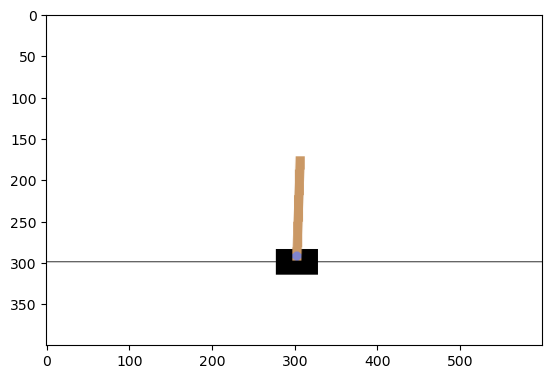

In [3]:
env = gym.make('CartPole-v0')
seed_everything(env)
env.reset()
plt.imshow(env.render(mode='rgb_array'))

In [4]:
state_dims = env.observation_space.shape[0]
num_actions = env.action_space.n
print(f"CartPole env: State dimensions: {state_dims}, Number of actions: {num_actions}")

CartPole env: State dimensions: 4, Number of actions: 2


### Prepare the environment to work with PyTorch

In [5]:
class PreprocessEnv(gym.Wrapper):

    def __init__(self, env):
        gym.Wrapper.__init__(self, env)

    def reset(self):
        obs = self.env.reset()
        return torch.from_numpy(obs).unsqueeze(dim=0).float()

    def step(self, action):
        action = action.item()
        next_state, reward, done, info = self.env.step(action)
        next_state = torch.from_numpy(next_state).unsqueeze(dim=0).float()
        reward = torch.tensor(reward).view(1, -1).float()
        done = torch.tensor(done).view(1, -1)
        return next_state, reward, done, info

In [6]:
env = PreprocessEnv(env)

In [7]:
state = env.reset()
action = torch.tensor(0)
next_state, reward, done, _ = env.step(action)
print(f"Sample state: {state}")
print(f"Next state: {next_state}, Reward: {reward}, Done: {done}")

Sample state: tensor([[-0.0406,  0.0476,  0.0261,  0.0286]])
Next state: tensor([[-0.0396, -0.1479,  0.0267,  0.3294]]), Reward: tensor([[1.]]), Done: tensor([[False]])


## Create the Q-Network and policy

<br><br>

### Create the Q-Network: $\hat q(s,a| \theta)$

In [8]:
q_network = nn.Sequential(
    nn.Linear(state_dims, 128),
    nn.ReLU(),
    nn.Linear(128, 64),
    nn.ReLU(),
    nn.Linear(64, num_actions))

### Create the target Q-Network: $\hat q(s, a|\theta_{targ})$

In [9]:
target_q_network = copy.deepcopy(q_network).eval()

### Create the exploratory policy: $b(s)$

In [10]:
def policy(state, epsilon=0.):
    if torch.rand(1) < epsilon:
        return torch.randint(num_actions, (1, 1))
    else:
        av = q_network(state).detach()
        return torch.argmax(av, dim=-1, keepdim=True)

## Create the Experience Replay buffer

<br>
<div style="text-align:center">
    <p>A simple buffer that stores transitions of arbitrary values, adapted from
    <a href="https://pytorch.org/tutorials/intermediate/reinforcement_q_learning.html#training">this source.</a></p>
</div>


In [11]:
class ReplayMemory:

    def __init__(self, capacity=100000):
        self.capacity = capacity
        self.memory = []
        self.position = 0

    def insert(self, transition):
        if len(self.memory) < self.capacity:
            self.memory.append(None)
        self.memory[self.position] = transition
        self.position = (self.position + 1) % self.capacity

    def sample(self, batch_size):
        assert self.can_sample(batch_size)

        batch = random.sample(self.memory, batch_size)
        batch = zip(*batch)
        return [torch.cat(items) for items in batch]

    def can_sample(self, batch_size):
        return len(self.memory) >= batch_size * 10

    def __len__(self):
        return len(self.memory)

## Implement the algorithm

</br></br>

In [12]:
def deep_q_learning(q_network, policy, episodes,
                    alpha=0.0001, batch_size=32, gamma=0.99, epsilon=0.2):

    optim = AdamW(q_network.parameters(), lr=alpha)
    memory = ReplayMemory()
    stats = {'MSE Loss': [], 'Returns': []}

    for episode in tqdm(range(1, episodes + 1)):
        state = env.reset()
        done = False
        ep_return = 0
        while not done:
            action = policy(state, epsilon)
            next_state, reward, done, _ = env.step(action)

            memory.insert([state, action, reward, done, next_state])

            if memory.can_sample(batch_size):
                state_b, action_b, reward_b, done_b, next_state_b = memory.sample(batch_size)
                print(f"This is state_b {state_b}")
                print(f"This is action_b {action_b}")
                print(f"This is done_b {done_b}")
                print(f"This is next_state_b {next_state_b}")
                print(f"This is reward_b {reward_b}")
                qsa_b_1=q_network(state_b)
                print(f"This is without gather functionality {qsa_b_1}")
                qsa_b = q_network(state_b).gather(1, action_b)
                print(f"This is qsa_b : {qsa_b}")

                next_qsa_b = target_q_network(next_state_b)
                print(f"This is next_qsa_b {next_qsa_b}")
                next_qsa_b = torch.max(next_qsa_b, dim=-1, keepdim=True)[0]

                target_b = reward_b + ~done_b * gamma * next_qsa_b
                loss = F.mse_loss(qsa_b, target_b)
                q_network.zero_grad()
                loss.backward()
                optim.step()

                stats['MSE Loss'].append(loss.item())

            state = next_state
            ep_return += reward.item()


        stats['Returns'].append(ep_return)

        if episode % 10 == 0:
            target_q_network.load_state_dict(q_network.state_dict())

    return stats

In [13]:
stats = deep_q_learning(q_network, policy, 500)

  0%|          | 1/500 [00:01<11:29,  1.38s/it]

This is state_b tensor([[ 1.0825e-01,  1.5957e+00, -1.4595e-01, -2.4106e+00],
        [-2.7631e-02,  7.3854e-01, -1.2378e-02, -1.1536e+00],
        [-3.4847e-02,  4.3064e-01, -1.1494e-02, -6.1810e-01],
        [-2.7399e-02,  5.9553e-01, -4.8558e-02, -8.6721e-01],
        [ 5.4585e-03, -4.3618e-02,  3.2763e-02,  1.3166e-02],
        [ 2.0625e-02,  3.8716e-01,  1.7713e-03, -5.5457e-01],
        [ 1.0999e-02,  1.1680e+00, -1.2067e-01, -1.8547e+00],
        [-3.3481e-02,  3.8564e-01, -1.7148e-02, -5.5052e-01],
        [ 1.4520e-02,  5.4038e-01,  1.6625e-02, -8.3493e-01],
        [-1.4148e-02,  7.7649e-01, -4.5129e-02, -1.1500e+00],
        [-2.0317e-02,  2.1123e-01,  6.2710e-03, -2.6249e-01],
        [ 5.6257e-03,  5.7437e-01, -3.6998e-02, -8.8519e-01],
        [-4.3261e-02,  3.8471e-01, -3.4938e-02, -6.1230e-01],
        [ 2.7875e-02,  2.1689e-02, -5.0638e-03, -2.2776e-02],
        [ 1.1626e-01,  1.1620e+00, -1.2326e-01, -1.8144e+00],
        [-3.9660e-02,  8.7645e-03, -3.2941e-02,  4.251

  7%|▋         | 33/500 [00:02<00:25, 18.40it/s]

This is state_b tensor([[ 3.8882e-02,  6.0767e-01, -2.3714e-02, -8.7332e-01],
        [ 3.5711e-02,  9.8566e-01, -1.0087e-01, -1.5778e+00],
        [-3.7008e-02, -2.4295e-03, -2.7309e-02,  1.6981e-02],
        [-4.3261e-02,  3.8471e-01, -3.4938e-02, -6.1230e-01],
        [ 2.6075e-02,  1.1883e+00, -5.5800e-02, -1.6941e+00],
        [ 3.6182e-02,  1.3691e+00, -1.4856e-01, -2.1874e+00],
        [ 1.1386e-01,  1.3452e+00, -1.7720e-01, -2.2291e+00],
        [ 1.8250e-02, -3.6025e-02, -3.0009e-02, -4.9264e-02],
        [ 1.2188e-01,  1.4032e+00, -1.6815e-01, -2.2111e+00],
        [ 8.0413e-03,  5.9382e-01, -5.6567e-02, -9.5253e-01],
        [-9.7344e-03,  7.9762e-01, -5.9799e-03, -1.0982e+00],
        [ 1.1295e-01,  1.0004e+00, -1.3321e-01, -1.5651e+00],
        [-1.4032e-02, -1.2858e-02, -1.0159e-02, -3.3170e-02],
        [ 1.4586e-03,  9.7933e-01, -8.9053e-02, -1.5277e+00],
        [ 1.9918e-02,  7.8966e-01, -7.5618e-02, -1.2624e+00],
        [-3.5567e-02,  5.8030e-01, -4.7184e-02, -9.157

  7%|▋         | 36/500 [00:02<00:30, 15.28it/s]

This is next_qsa_b tensor([[-0.0950,  0.4412],
        [-0.0449,  0.2152],
        [-0.0907,  0.4332],
        [-0.0770,  0.3721],
        [-0.0649,  0.3109],
        [-0.0362,  0.2018],
        [-0.0523,  0.2559],
        [-0.0854,  0.4180],
        [ 0.0008,  0.1409],
        [-0.0438,  0.2140],
        [-0.0445,  0.2186],
        [-0.0582,  0.2740],
        [-0.0732,  0.3396],
        [-0.1067,  0.5334],
        [-0.0707,  0.3271],
        [-0.0970,  0.4773],
        [-0.0845,  0.4653],
        [-0.0562,  0.2642],
        [-0.0675,  0.3216],
        [-0.0064,  0.1520],
        [-0.0134,  0.1722],
        [-0.0035,  0.1494],
        [-0.0250,  0.1882],
        [-0.0743,  0.4132],
        [-0.0932,  0.4372],
        [-0.0153,  0.1760],
        [-0.0723,  0.3281],
        [-0.0735,  0.3295],
        [-0.0667,  0.3452],
        [-0.0705,  0.3516],
        [-0.0589,  0.2709],
        [-0.0734,  0.3408]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 8.7920e-02,  1.3522e+00, -1.2078

  8%|▊         | 38/500 [00:02<00:34, 13.38it/s]

This is action_b tensor([[1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [1],
        [1],
        [0],
        [1],
        [1],
        [1],
        [1]])
This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False]])
This i

  8%|▊         | 40/500 [00:03<00:36, 12.45it/s]

This is state_b tensor([[ 1.5608e-01,  1.4026e+00, -1.9792e-01, -2.2431e+00],
        [-3.5567e-02,  5.8030e-01, -4.7184e-02, -9.1578e-01],
        [ 3.7307e-02,  7.8586e-01, -3.0592e-02, -1.1909e+00],
        [ 4.7976e-02,  7.6342e-01,  1.6902e-02, -1.0764e+00],
        [ 9.2739e-02,  1.3866e+00, -1.7232e-01, -2.2087e+00],
        [ 1.2466e-01,  1.1546e+00, -9.2560e-02, -1.6875e+00],
        [-1.3819e-02, -4.1235e-02, -3.8199e-02,  4.6190e-02],
        [-1.3342e-03, -9.2930e-04,  4.3783e-02,  7.1728e-03],
        [ 1.3912e-01,  1.1699e+00, -1.1665e-01, -1.8285e+00],
        [ 1.1295e-01,  1.0004e+00, -1.3321e-01, -1.5651e+00],
        [ 6.5910e-02,  8.0198e-01, -5.5670e-02, -1.1585e+00],
        [-4.5851e-02,  1.9476e-01, -1.7725e-02, -3.3355e-01],
        [ 3.6018e-02,  1.0083e+00, -3.9317e-02, -1.4696e+00],
        [ 3.8351e-02,  4.2104e-01, -1.8023e-02, -6.1372e-01],
        [ 5.9100e-02,  8.1193e-01, -4.8538e-02, -1.2141e+00],
        [ 7.6065e-03,  3.4565e-01,  2.7646e-02, -5.510

  8%|▊         | 42/500 [00:03<00:40, 11.40it/s]

This is next_qsa_b tensor([[ 1.1843e-02,  5.1099e-01],
        [ 2.6404e-02,  1.0064e+00],
        [ 5.1542e-02,  1.2524e+00],
        [-3.7563e-03,  7.1625e-01],
        [ 4.0689e-02,  1.1968e+00],
        [ 5.7069e-02,  1.3071e+00],
        [ 2.3331e-02,  1.0369e+00],
        [-2.3756e-03,  6.8534e-01],
        [ 2.5053e-02,  1.0191e+00],
        [ 9.8460e-02,  1.6147e+00],
        [ 1.0504e-02,  8.2764e-01],
        [ 4.2758e-02,  1.1743e+00],
        [ 9.6265e-02,  1.6016e+00],
        [ 1.2338e-02,  8.5764e-01],
        [ 9.2785e-03,  8.5693e-01],
        [ 3.3830e-04,  5.8850e-01],
        [ 6.3278e-04,  6.9750e-01],
        [ 2.2281e-04,  7.1610e-01],
        [ 5.5398e-02,  1.3376e+00],
        [ 9.5609e-03,  8.3879e-01],
        [ 6.3334e-02,  1.3460e+00],
        [ 1.5882e-02,  4.9880e-01],
        [ 8.4675e-03,  8.5899e-01],
        [ 2.4483e-02,  9.3507e-01],
        [ 4.0104e-02,  1.1104e+00],
        [ 1.1900e-02,  8.6153e-01],
        [-1.2663e-04,  5.8290e-01],
        [

  9%|▊         | 43/500 [00:03<00:42, 10.69it/s]

This is next_state_b tensor([[ 1.7587e-02,  3.9544e-01, -6.7966e-04, -6.0135e-01],
        [-6.3001e-04,  4.3831e-01,  3.4561e-02, -5.3512e-01],
        [ 1.1279e-02,  6.3217e-01, -8.7252e-02, -9.9719e-01],
        [ 4.6984e-03,  7.9042e-01, -6.5813e-02, -1.1811e+00],
        [-1.8748e-02,  4.3479e-01, -4.1421e-02, -6.5193e-01],
        [ 8.2411e-02,  1.1535e+00, -3.1899e-02, -1.6578e+00],
        [ 1.0759e-01,  1.5173e+00, -1.2557e-01, -2.3405e+00],
        [-2.5424e-02,  5.8413e-01, -4.4358e-02, -8.8804e-01],
        [-2.5964e-02,  5.8771e-01, -4.6574e-02, -9.0851e-01],
        [-1.0052e-02,  6.3046e-01, -5.4460e-02, -9.5736e-01],
        [-5.5055e-03,  2.4378e-01,  3.9665e-02, -2.5521e-01],
        [ 1.2212e-02,  1.6034e-01, -2.7688e-02, -3.6936e-01],
        [-4.5851e-02,  1.9476e-01, -1.7725e-02, -3.3355e-01],
        [ 1.6244e-02,  1.8530e-01,  3.0736e-02, -3.1591e-01],
        [-4.3261e-02,  3.8471e-01, -3.4938e-02, -6.1230e-01],
        [ 3.3564e-02,  7.4717e-01, -6.7972e-02, -

  9%|▉         | 45/500 [00:03<00:46,  9.69it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[0.0828, 1.0372],
        [0.2347, 1.7389],
        [0.0610, 0.7087],
        [0.2468, 1.8813],
        [0.0843, 1.0391],
        [0.0836, 1.0040],
        [0.0834, 1.0767],
        [0.1098, 1.1972],
        [0.1049, 1.1476],
        [0.0802, 1.0358],
        [0.1259, 1.2846],
        [0.0663, 0.6181],
        [0.0600, 0.6264],
        [0.0799, 1.0219],
        [0.2161, 1.7099],
        [0.1560, 1.4164],
        [0.2021, 1.6647],
        [0.0666, 0.6150],
        [0.0619, 0.6303],
   

  9%|▉         | 46/500 [00:04<00:49,  9.13it/s]

This is qsa_b : tensor([[0.3373],
        [0.6785],
        [0.9577],
        [0.9844],
        [1.3543],
        [1.1324],
        [0.1304],
        [0.6760],
        [2.1343],
        [0.9813],
        [1.1044],
        [0.9708],
        [1.8769],
        [1.7670],
        [1.5902],
        [2.1929],
        [1.5752],
        [0.9380],
        [1.1313],
        [1.0380],
        [1.1151],
        [1.1691],
        [0.6869],
        [1.5187],
        [1.5926],
        [1.1531],
        [1.3820],
        [1.7823],
        [0.6959],
        [2.1445],
        [1.7901],
        [1.9456]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[ 4.2176e-02,  1.1804e+00],
        [ 1.5507e-02,  4.9685e-01],
        [-4.0742e-03,  7.2306e-01],
        [-4.3552e-03,  7.4282e-01],
        [ 2.6404e-02,  1.0064e+00],
        [ 1.2778e-02,  8.4581e-01],
        [-1.0694e-03,  6.1788e-01],
        [ 1.5484e-02,  4.9050e-01],
        [ 1.0110e-01,  1.5302e+00],
        [-6.0622e-03,  7.4118e-01],
 

 10%|▉         | 48/500 [00:04<00:58,  7.75it/s]

This is state_b tensor([[ 2.9022e-02,  2.1131e-01,  2.1078e-02, -2.5807e-01],
        [-2.4001e-02,  6.2000e-01, -5.4805e-02, -9.4471e-01],
        [ 2.7838e-02, -3.0536e-02, -3.3279e-03, -4.5620e-02],
        [ 7.7001e-02,  1.6084e+00, -2.0576e-01, -2.5583e+00],
        [ 1.1626e-01,  1.1620e+00, -1.2326e-01, -1.8144e+00],
        [ 1.0759e-01,  1.5173e+00, -1.2557e-01, -2.3405e+00],
        [ 1.1155e-01,  1.3855e+00, -1.4433e-01, -2.1837e+00],
        [ 9.6194e-02,  1.3731e+00, -1.2031e-01, -2.1198e+00],
        [-4.5839e-02, -6.0092e-04, -1.7014e-02, -3.5548e-02],
        [ 8.0261e-02,  1.3997e+00, -1.0420e-01, -2.0876e+00],
        [-1.6092e-02,  4.0626e-01,  1.0212e-03, -5.5319e-01],
        [ 2.7618e-02,  3.6520e-01,  3.7073e-02, -5.8325e-01],
        [ 1.6840e-02, -2.8904e-03,  6.5236e-03,  2.6500e-02],
        [-1.0052e-02,  6.3046e-01, -5.4460e-02, -9.5736e-01],
        [-4.5542e-03,  5.4574e-01, -5.3692e-02, -8.6825e-01],
        [ 3.9079e-02,  3.9345e-02,  1.8858e-03, -1.840

 10%|▉         | 49/500 [00:04<00:59,  7.63it/s]

This is state_b tensor([[ 5.7804e-02,  1.2180e+00, -4.2355e-02, -1.6893e+00],
        [ 5.8165e-03,  1.1294e+00, -6.4455e-02, -1.7537e+00],
        [-4.5542e-03,  5.4574e-01, -5.3692e-02, -8.6825e-01],
        [-1.4289e-02,  1.8241e-01, -1.0823e-02, -3.2904e-01],
        [ 3.7307e-02,  7.8586e-01, -3.0592e-02, -1.1909e+00],
        [ 6.4795e-02,  1.1563e+00, -8.4241e-02, -1.8268e+00],
        [ 8.5330e-02,  1.7172e+00, -1.8859e-01, -2.7199e+00],
        [-3.1171e-03,  1.7206e-01, -1.6802e-02, -2.9588e-01],
        [ 5.2271e-03,  1.8173e-01,  3.3595e-02, -2.5127e-01],
        [ 2.7525e-02,  2.1147e-01, -1.3445e-02, -3.3720e-01],
        [ 8.7072e-02,  1.1946e+00, -9.4221e-02, -1.7908e+00],
        [-3.9556e-02,  2.3545e-01, -5.0176e-03, -3.2384e-01],
        [ 1.3196e-01,  1.2062e+00, -1.5981e-01, -1.9054e+00],
        [ 2.6291e-02,  2.1716e-01, -6.5361e-03, -2.8209e-01],
        [-3.3195e-02,  3.8857e-01, -3.2653e-02, -5.8526e-01],
        [ 5.3181e-02,  1.1501e+00, -1.0652e-01, -1.821

 10%|█         | 50/500 [00:04<01:02,  7.15it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[0.4211, 1.8325],
        [0.6680, 2.4700],
        [0.3302, 1.5680],
        [0.1516, 0.8421],
        [0.5088, 2.0509],
        [0.5160, 2.0827],
        [0.2487, 1.3320],
        [0.7879, 2.7777],
        [0.5279, 2.1322],
        [0.2635, 1.3701],
        [0.6190, 2.3481],
        [0.2028, 1.1343],
        [0.5411, 2.1458],
        [0.4883, 2.0102],
        [0.3414, 1.6040],
        [0.1740, 0.9722],
        [0.3996, 1.7731],
        [0.2073, 1.1813],
        [0.2588, 1.3699],
   

 10%|█         | 51/500 [00:04<01:03,  7.03it/s]

This is state_b tensor([[ 2.2535e-02,  5.5143e-01, -4.8488e-02, -9.7416e-01],
        [-3.9484e-02,  2.0434e-01, -3.2090e-02, -2.6038e-01],
        [ 6.5640e-02,  8.2007e-01, -3.4683e-02, -1.1948e+00],
        [ 1.4466e-01,  1.6116e+00, -1.7226e-01, -2.4803e+00],
        [ 2.8035e-02,  6.1798e-01, -2.4966e-02, -9.1301e-01],
        [ 1.4348e-01,  1.7439e+00, -1.6875e-01, -2.6470e+00],
        [ 2.7618e-02,  3.6520e-01,  3.7073e-02, -5.8325e-01],
        [-4.6918e-02, -6.3283e-03, -2.8542e-02, -9.1471e-03],
        [-2.4403e-02,  4.3604e-02, -3.3539e-02, -4.5509e-02],
        [-1.9404e-02,  7.9220e-03, -3.2323e-02,  3.5661e-02],
        [ 1.0559e-01,  1.3381e+00, -1.3454e-01, -2.1693e+00],
        [ 7.3736e-02,  1.1603e+00, -5.8012e-02, -1.7682e+00],
        [ 5.3036e-02,  8.0281e-01, -4.2247e-02, -1.2080e+00],
        [-4.5851e-02,  1.9476e-01, -1.7725e-02, -3.3355e-01],
        [ 4.2279e-02,  6.3266e-01, -1.9627e-02, -9.1610e-01],
        [ 9.6942e-02,  9.6592e-01, -9.3376e-02, -1.494

 10%|█         | 52/500 [00:04<01:11,  6.25it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[0.3236, 1.5014],
        [0.3982, 1.7238],
        [0.4981, 1.9891],
        [0.2174, 1.1221],
        [0.3256, 1.5139],
        [0.1914, 1.0110],
        [0.6252, 2.2693],
        [0.1914, 1.0043],
        [0.2249, 1.1773],
        [0.5781, 2.1706],
        [0.2748, 1.3381],
        [0.9553, 3.0630],
        [0.4216, 1.7827],
        [0.6903, 2.4458],
        [0.2234, 1.1556],
        [0.6122, 2.2345],
        [0.4399, 1.8348],
        [0.7274, 2.5330],
        [0.2252, 1.1149],
   

 11%|█         | 53/500 [00:05<01:18,  5.72it/s]

This is state_b tensor([[ 1.3878e-01,  1.1970e+00, -1.7226e-01, -1.8614e+00],
        [-1.0641e-02,  3.7768e-01, -1.7404e-02, -6.2512e-01],
        [-3.1846e-02,  3.9672e-01, -4.4549e-02, -5.9221e-01],
        [ 6.6233e-02,  1.3563e+00, -1.4047e-01, -2.1701e+00],
        [ 1.4988e-01,  1.1927e+00, -1.5212e-01, -1.8661e+00],
        [ 1.1395e-01,  8.0013e-01, -9.7027e-02, -1.2167e+00],
        [ 5.2271e-03,  1.8173e-01,  3.3595e-02, -2.5127e-01],
        [ 3.4808e-02,  1.6912e-01, -4.4607e-02, -3.2815e-01],
        [ 4.6772e-02,  6.1641e-01, -3.0298e-02, -9.1203e-01],
        [ 1.2995e-01,  9.9636e-01, -1.2136e-01, -1.5381e+00],
        [ 4.9110e-02,  1.0145e+00, -1.6797e-01, -1.6411e+00],
        [ 1.3472e-02,  5.3579e-03,  5.9207e-03, -1.9605e-02],
        [ 2.7810e-02,  7.6593e-01,  1.5722e-03, -1.1037e+00],
        [-3.3807e-02,  3.9212e-01, -3.4470e-02, -6.0517e-01],
        [ 1.7529e-02, -2.3070e-01, -3.0994e-02,  2.3380e-01],
        [ 8.8616e-03,  3.7635e-01,  2.8570e-02, -5.331

 11%|█         | 55/500 [00:05<01:10,  6.31it/s]

This is state_b tensor([[-9.7344e-03,  7.9762e-01, -5.9799e-03, -1.0982e+00],
        [ 1.2188e-01,  1.4032e+00, -1.6815e-01, -2.2111e+00],
        [-5.6195e-03,  2.2810e-01,  1.9651e-02, -3.0506e-01],
        [ 7.4012e-03,  6.1786e-01,  1.7204e-03, -8.7987e-01],
        [ 3.8443e-02,  1.1695e+00, -6.4928e-02, -1.7112e+00],
        [-4.5473e-02,  3.4860e-01,  1.6372e-02, -5.7501e-01],
        [ 8.5330e-02,  1.7172e+00, -1.8859e-01, -2.7199e+00],
        [ 8.4098e-03,  1.4985e-02, -4.1556e-02, -8.4193e-03],
        [-2.4403e-02,  4.3604e-02, -3.3539e-02, -4.5509e-02],
        [ 8.1061e-03, -1.5313e-02,  9.0915e-03, -4.7720e-02],
        [ 2.4679e-02, -2.3754e-02,  4.3681e-02, -2.5903e-02],
        [-7.9669e-03,  6.0137e-01, -1.0042e-02, -8.4555e-01],
        [-2.5424e-02,  5.8413e-01, -4.4358e-02, -8.8804e-01],
        [ 8.5404e-02,  1.4175e+00, -2.0574e-01, -2.3106e+00],
        [ 2.7838e-02, -3.0536e-02, -3.3279e-03, -4.5620e-02],
        [ 6.8554e-03,  1.1478e+00, -1.2640e-01, -1.840

 11%|█         | 56/500 [00:05<01:20,  5.55it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[1.5239, 3.6711],
        [1.1419, 3.0068],
        [0.5678, 1.9258],
        [0.3760, 1.4549],
        [1.3153, 3.3074],
        [0.6506, 2.1180],
        [1.3175, 3.3107],
        [0.3220, 1.2591],
        [0.9744, 2.7086],
        [0.3845, 1.4704],
        [0.3122, 1.2481],
        [1.3640, 3.3939],
        [0.5339, 1.8532],
        [1.2034, 3.1215],
        [1.3781, 3.4200],
        [0.4336, 1.6050],
        [0.8875, 2.5573],
        [0.3827, 1.4681],
        [0.8277, 2.4494],
   

 11%|█▏        | 57/500 [00:05<01:23,  5.28it/s]

This is next_qsa_b tensor([[0.3336, 1.5594],
        [0.2196, 1.1884],
        [0.8145, 2.7612],
        [0.1778, 0.9886],
        [0.3578, 1.6211],
        [0.2179, 1.1783],
        [0.1824, 1.0023],
        [0.5192, 2.0385],
        [0.1558, 0.8906],
        [0.8152, 2.7604],
        [0.1865, 0.9963],
        [0.2948, 1.4788],
        [0.5871, 2.2006],
        [0.2241, 1.1951],
        [0.8502, 2.8456],
        [0.3456, 1.5904],
        [0.1808, 0.9961],
        [0.9169, 3.0124],
        [0.5878, 2.2022],
        [0.3608, 1.6143],
        [0.2233, 1.1907],
        [0.2717, 1.3668],
        [0.2731, 1.3691],
        [0.6567, 2.3750],
        [0.2817, 1.4017],
        [0.3423, 1.5844],
        [0.3567, 1.6119],
        [0.2734, 1.3789],
        [0.3585, 1.6300],
        [0.4472, 1.8363],
        [0.8111, 2.7414],
        [0.2614, 1.3281]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 2.5333e-02,  1.0230e+00, -8.0778e-02, -1.5124e+00],
        [-3.0877e-03,  5.7304e-01, -2.9906e-

 12%|█▏        | 58/500 [00:06<01:27,  5.04it/s]

This is next_state_b tensor([[ 1.8413e-01,  1.5990e+00, -2.4278e-01, -2.5897e+00],
        [ 3.9942e-02,  1.1337e+00, -1.2443e-01, -1.8121e+00],
        [ 2.8684e-02,  2.4230e-01, -6.3809e-04, -3.2827e-01],
        [ 7.1493e-02,  1.0236e+00, -6.2246e-02, -1.5192e+00],
        [-9.2329e-03,  6.0038e-01,  7.1886e-03, -8.3077e-01],
        [ 5.5564e-02,  9.7296e-01, -4.9100e-02, -1.4431e+00],
        [ 4.6997e-02,  9.8695e-01, -1.6591e-01, -1.5952e+00],
        [ 2.8117e-02,  7.4857e-01, -8.9935e-02, -1.3481e+00],
        [ 1.3295e-01,  8.0708e-01, -1.6451e-01, -1.3168e+00],
        [ 9.3622e-02,  1.4077e+00, -2.4042e-01, -2.3287e+00],
        [ 6.0983e-02,  1.2211e+00, -1.6632e-01, -1.9713e+00],
        [ 5.3391e-02,  7.9607e-01, -1.1597e-02, -1.1227e+00],
        [ 1.0334e-01,  1.7640e+00, -2.5024e-01, -2.8575e+00],
        [-1.9928e-02,  1.9374e-01,  1.7198e-02, -2.4194e-01],
        [ 3.2647e-02,  4.1208e-01, -1.1860e-02, -6.1147e-01],
        [ 1.0308e-02, -3.7162e-02, -3.8018e-02, -

 12%|█▏        | 59/500 [00:06<01:23,  5.29it/s]

This is state_b tensor([[-4.5542e-03,  5.4574e-01, -5.3692e-02, -8.6825e-01],
        [ 1.4586e-03,  9.7933e-01, -8.9053e-02, -1.5277e+00],
        [-1.3741e-02,  7.7983e-01, -6.2119e-02, -1.1943e+00],
        [ 5.6700e-02,  7.5657e-01, -8.2719e-02, -1.2550e+00],
        [-3.9979e-02,  3.4994e-01,  4.3590e-02, -5.3725e-01],
        [ 3.9835e-02,  7.9762e-01, -7.8629e-02, -1.1657e+00],
        [ 3.3589e-02,  6.2110e-01, -1.1338e-01, -1.0830e+00],
        [ 2.7201e-02,  1.6166e-02, -1.2634e-02, -4.0553e-02],
        [ 1.7529e-02, -2.3070e-01, -3.0994e-02,  2.3380e-01],
        [-2.0317e-02,  2.1123e-01,  6.2710e-03, -2.6249e-01],
        [ 3.2943e-02,  2.9682e-02, -2.6736e-02,  3.0770e-03],
        [ 8.1950e-02,  9.9778e-01, -7.8841e-02, -1.4681e+00],
        [ 2.5094e-02,  4.2478e-01, -9.8157e-02, -7.6113e-01],
        [ 1.0278e-02,  1.9237e-01,  2.7501e-02, -2.4533e-01],
        [-1.5176e-02,  3.9905e-01, -3.6950e-02, -5.6952e-01],
        [ 4.8818e-02,  7.5052e-01, -4.2285e-02, -1.229

 12%|█▏        | 60/500 [00:06<01:17,  5.68it/s]

This is state_b tensor([[-3.3873e-02,  1.0448e-04, -3.4769e-02,  1.9632e-02],
        [-3.7739e-02,  1.9661e-01, -2.8397e-02, -3.0367e-01],
        [ 8.1061e-03, -1.5313e-02,  9.0915e-03, -4.7720e-02],
        [ 4.3030e-02,  1.1602e+00, -1.0353e-01, -1.8471e+00],
        [ 1.4910e-01,  1.0039e+00, -1.9085e-01, -1.6561e+00],
        [ 4.8859e-02,  6.1891e-01, -5.5792e-02, -9.3425e-01],
        [ 6.6233e-02,  1.3563e+00, -1.4047e-01, -2.1701e+00],
        [ 2.7618e-02,  3.6520e-01,  3.7073e-02, -5.8325e-01],
        [-3.9979e-02,  3.4994e-01,  4.3590e-02, -5.3725e-01],
        [ 4.2279e-02,  6.3266e-01, -1.9627e-02, -9.1610e-01],
        [-1.4210e-02,  7.8343e-01, -6.4744e-02, -1.2155e+00],
        [-3.8394e-02,  2.3710e-01, -2.7904e-02, -3.4733e-01],
        [-1.4643e-02,  1.5441e-01, -3.7276e-02, -2.5830e-01],
        [-1.0052e-02,  6.3046e-01, -5.4460e-02, -9.5736e-01],
        [-9.0164e-04,  3.1146e-02, -5.3153e-02, -9.8076e-02],
        [ 2.8580e-02,  9.7408e-01, -1.0926e-01, -1.503

 12%|█▏        | 61/500 [00:06<01:15,  5.78it/s]

This is state_b tensor([[ 0.0261,  1.1883, -0.0558, -1.6941],
        [ 0.0616,  1.5605, -0.2014, -2.5192],
        [ 0.0588,  0.4217, -0.0626, -0.6233],
        [-0.0121,  0.7883, -0.0744, -1.2084],
        [ 0.0046,  0.1510,  0.0330, -0.2690],
        [ 0.0848,  1.3373, -0.1901, -2.3294],
        [ 0.0715,  1.5630, -0.1422, -2.3807],
        [ 0.0074, -0.0347, -0.0441, -0.1118],
        [ 0.1115,  1.3855, -0.1443, -2.1837],
        [-0.0342,  0.2131,  0.0254, -0.2381],
        [-0.0031,  0.5730, -0.0299, -0.9232],
        [-0.0477, -0.0410,  0.0222, -0.0038],
        [-0.0055,  0.2438,  0.0397, -0.2552],
        [ 0.0278, -0.0305, -0.0033, -0.0456],
        [-0.0332,  0.3886, -0.0327, -0.5853],
        [ 0.1165,  0.8076, -0.1995, -1.4069],
        [-0.0455,  0.3486,  0.0164, -0.5750],
        [ 0.0751,  0.9680, -0.1448, -1.5576],
        [ 0.0659,  0.8020, -0.0557, -1.1585],
        [ 0.1820,  1.1729, -0.1847, -1.9105],
        [ 0.0332,  0.4061,  0.0159, -0.5440],
        [-0.0486, 

 13%|█▎        | 63/500 [00:06<01:11,  6.12it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[1.2402, 2.6303],
        [0.7132, 1.8469],
        [0.6324, 1.6925],
        [0.7190, 1.8465],
        [1.2878, 2.6839],
        [1.5181, 2.9487],
        [0.8773, 2.1395],
        [0.7421, 1.9039],
        [0.8875, 2.1429],
        [2.0562, 3.5067],
        [1.0106, 2.3274],
        [2.3604, 3.8299],
        [0.7161, 1.8473],
        [0.6083, 1.6482],
        [0.6460, 1.7436],
        [1.0621, 2.3857],
        [0.7335, 1.8833],
        [1.3356, 2.7386],
        [0.8385, 2.0660],
   

 13%|█▎        | 64/500 [00:07<01:11,  6.14it/s]

This is next_state_b tensor([[ 0.1402,  1.7918, -0.1942, -2.7443],
        [ 0.1197,  1.3333, -0.2531, -2.2544],
        [ 0.0064,  0.7415, -0.0711, -1.1773],
        [ 0.0414,  0.6010,  0.0050, -0.8317],
        [ 0.1244,  1.7486, -0.2339, -2.8456],
        [ 0.1589,  1.7114, -0.2207, -2.7142],
        [-0.0396,  0.2354, -0.0050, -0.3238],
        [ 0.0904,  1.3802, -0.2365, -2.2817],
        [ 0.0944,  1.1645, -0.1759, -1.8917],
        [ 0.0819,  0.9978, -0.0788, -1.4681],
        [ 0.1561,  1.4026, -0.1979, -2.2431],
        [ 0.1475,  1.7277, -0.2603, -2.9310],
        [ 0.0510,  0.8031, -0.0412, -1.1734],
        [ 0.1169,  1.5317, -0.2087, -2.5824],
        [ 0.0101,  0.5774, -0.0154, -0.8294],
        [-0.0093,  0.8144, -0.0577, -1.2386],
        [ 0.1868,  1.7996, -0.2164, -2.7948],
        [-0.0395,  0.2043, -0.0321, -0.2604],
        [-0.0216,  0.2107,  0.0232, -0.2586],
        [-0.0173,  0.4055,  0.0181, -0.5438],
        [-0.0205,  0.2383, -0.0474, -0.3018],
        [-0.0

 13%|█▎        | 66/500 [00:07<00:59,  7.25it/s]

This is next_qsa_b tensor([[0.7442, 1.8762],
        [1.5939, 2.8638],
        [1.5849, 2.8668],
        [1.5773, 2.8672],
        [0.6068, 1.6649],
        [1.8827, 3.1752],
        [0.7367, 1.8624],
        [2.4178, 3.7740],
        [1.3221, 2.6279],
        [0.7519, 1.8798],
        [0.8999, 2.0889],
        [1.1653, 2.4130],
        [0.7031, 1.8097],
        [2.2760, 3.6016],
        [1.3483, 2.6480],
        [0.6153, 1.6755],
        [0.9942, 2.1965],
        [1.2678, 2.5378],
        [1.7878, 3.0827],
        [0.6256, 1.6936],
        [1.2473, 2.5071],
        [0.9004, 2.0936],
        [1.7289, 3.0314],
        [1.7112, 3.0093],
        [0.6064, 1.6646],
        [1.3777, 2.6736],
        [1.5426, 2.8198],
        [0.7459, 1.8704],
        [0.5859, 1.6118],
        [0.7303, 1.8433],
        [0.7351, 1.8484],
        [1.5227, 2.8149]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 8.3858e-02,  6.0656e-01, -1.4435e-01, -9.6871e-01],
        [ 9.1965e-02,  1.2194e+00, -9.2630e-

 13%|█▎        | 67/500 [00:07<01:08,  6.32it/s]

This is state_b tensor([[ 2.4506e-02,  6.2179e-01, -7.5797e-03, -8.7899e-01],
        [ 5.1933e-02,  7.9772e-01, -5.1532e-02, -1.2359e+00],
        [-3.7817e-02,  6.3299e-04,  1.9426e-02,  8.1117e-03],
        [ 1.0837e-01,  9.4246e-01, -1.7176e-01, -1.6131e+00],
        [ 1.4387e-02,  3.2276e-02, -5.6586e-03, -2.7276e-02],
        [ 3.8351e-02,  4.2104e-01, -1.8023e-02, -6.1372e-01],
        [ 2.7228e-02,  1.6463e-01, -4.2403e-03, -3.3935e-01],
        [-1.4148e-02,  7.7649e-01, -4.5129e-02, -1.1500e+00],
        [ 2.0625e-02,  3.8716e-01,  1.7713e-03, -5.5457e-01],
        [-5.1146e-03, -2.1995e-01, -2.5842e-02,  3.0886e-01],
        [ 1.5247e-02,  8.2275e-01, -8.5139e-02, -1.2481e+00],
        [ 9.0153e-02,  1.3354e+00, -1.6381e-01, -2.2440e+00],
        [ 4.1428e-02,  1.6198e-01, -2.2221e-02, -3.3404e-01],
        [ 2.5496e-02,  5.9057e-01, -1.2707e-02, -8.9425e-01],
        [-1.9246e-02,  2.0349e-01, -3.1609e-02, -2.6704e-01],
        [ 2.0081e-02,  1.1833e+00, -1.1914e-01, -1.806

 14%|█▍        | 69/500 [00:07<00:58,  7.33it/s]

This is next_state_b tensor([[ 1.3018e-01,  8.0677e-01, -1.5111e-01, -1.2753e+00],
        [ 1.1044e-01,  1.6095e+00, -1.1604e-01, -2.3101e+00],
        [ 9.1965e-02,  1.2194e+00, -9.2630e-02, -1.8307e+00],
        [-3.6452e-02,  3.4358e-01, -5.1889e-02, -6.4547e-01],
        [ 6.3829e-02,  9.4616e-01, -6.6875e-02, -1.5352e+00],
        [ 5.8640e-02,  1.1258e+00, -5.0822e-02, -1.7147e+00],
        [ 8.4036e-02,  1.5925e+00, -1.3704e-01, -2.3569e+00],
        [-1.3741e-02,  7.7983e-01, -6.2119e-02, -1.1943e+00],
        [ 3.7028e-03,  9.8427e-01, -9.8534e-02, -1.5235e+00],
        [ 1.8887e-02,  5.6979e-01, -1.1166e-02, -9.1987e-01],
        [ 9.8472e-02,  9.8246e-01, -2.3540e-02, -1.3723e+00],
        [ 1.7113e-02,  7.6997e-01, -5.4702e-02, -1.1893e+00],
        [ 5.5787e-02,  6.0360e-01, -1.0194e-01, -8.9863e-01],
        [-2.1558e-02,  2.1073e-01,  2.3237e-02, -2.5857e-01],
        [ 9.0408e-02,  1.3802e+00, -2.3651e-01, -2.2817e+00],
        [ 1.0426e-01,  6.1060e-01, -1.7821e-01, -

 14%|█▍        | 70/500 [00:07<00:57,  7.51it/s]

This is state_b tensor([[ 4.8818e-02,  7.5052e-01, -4.2285e-02, -1.2295e+00],
        [ 1.2923e-02,  4.0637e-01, -4.8002e-02, -6.1946e-01],
        [ 5.8165e-03,  1.1294e+00, -6.4455e-02, -1.7537e+00],
        [-1.7380e-02,  2.4071e-01, -2.0878e-02, -2.9770e-01],
        [ 1.0308e-02, -3.7162e-02, -3.8018e-02, -5.7729e-02],
        [-1.4032e-02, -1.2858e-02, -1.0159e-02, -3.3170e-02],
        [ 6.4795e-02,  1.1563e+00, -8.4241e-02, -1.8268e+00],
        [ 1.6840e-02, -2.8904e-03,  6.5236e-03,  2.6500e-02],
        [ 1.1337e-02,  2.3175e-01,  1.0136e-02, -2.9815e-01],
        [-9.0164e-04,  3.1146e-02, -5.3153e-02, -9.8076e-02],
        [ 9.1965e-02,  1.2194e+00, -9.2630e-02, -1.8307e+00],
        [ 5.1986e-02,  7.4362e-01, -7.9345e-02, -1.2216e+00],
        [ 1.9918e-02,  7.8966e-01, -7.5618e-02, -1.2624e+00],
        [-1.8793e-02,  7.3532e-01, -8.3879e-02, -1.2663e+00],
        [-4.5851e-02,  1.9476e-01, -1.7725e-02, -3.3355e-01],
        [ 8.2752e-02,  1.1420e+00, -9.7579e-02, -1.847

 14%|█▍        | 71/500 [00:08<01:02,  6.88it/s]

This is qsa_b : tensor([[3.0338],
        [3.9006],
        [2.1881],
        [3.5148],
        [3.4949],
        [2.5813],
        [3.0547],
        [2.2121],
        [0.9482],
        [3.2557],
        [3.1006],
        [2.5965],
        [3.0118],
        [2.1454],
        [3.0400],
        [3.0272],
        [2.0773],
        [3.7083],
        [2.8133],
        [2.3935],
        [2.6375],
        [2.7920],
        [2.3605],
        [2.1800],
        [2.1557],
        [3.3278],
        [3.3056],
        [2.6075],
        [2.4465],
        [2.6178],
        [2.8444],
        [2.3549]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[2.7708, 3.7039],
        [3.3160, 4.1108],
        [1.0678, 2.3542],
        [2.7397, 3.7010],
        [2.6497, 3.6662],
        [2.2880, 3.4003],
        [2.0127, 3.2424],
        [1.0600, 2.3583],
        [0.8403, 2.0487],
        [2.2787, 3.4253],
        [2.0944, 3.2833],
        [1.4575, 2.7891],
        [2.7483, 3.6915],
        [1.0370, 2.3063

 15%|█▍        | 73/500 [00:08<01:03,  6.74it/s]

This is next_qsa_b tensor([[3.2316, 4.0681],
        [1.7234, 3.0185],
        [1.9863, 3.2273],
        [2.3563, 3.4799],
        [1.6052, 2.8824],
        [2.4047, 3.4900],
        [3.2522, 4.0816],
        [1.7355, 3.0576],
        [2.9851, 3.8874],
        [2.7750, 3.7278],
        [2.1553, 3.3029],
        [2.3371, 3.4726],
        [2.1459, 3.2965],
        [1.6625, 2.9926],
        [1.2382, 2.5810],
        [1.0446, 2.3146],
        [2.1032, 3.3199],
        [2.3990, 3.4925],
        [2.3859, 3.4864],
        [1.4801, 2.7870],
        [2.4070, 3.4820],
        [2.0904, 3.2985],
        [3.3430, 4.1445],
        [1.4413, 2.7718],
        [2.0333, 3.2550],
        [1.2567, 2.5886],
        [1.0415, 2.3179],
        [1.2246, 2.5646],
        [1.4531, 2.7965],
        [1.0298, 2.2983],
        [1.0665, 2.3500],
        [2.5610, 3.6040]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[-4.6289e-02,  1.6364e-01, -2.6827e-02, -3.2593e-01],
        [-3.6894e-02, -3.7625e-02,  4.2756e-

 15%|█▍        | 74/500 [00:08<01:01,  6.98it/s]

This is state_b tensor([[-1.6509e-02,  6.1490e-01,  5.8291e-03, -8.3492e-01],
        [ 4.5821e-02,  1.9294e-01,  2.7439e-02, -3.2536e-01],
        [ 1.2466e-01,  1.1546e+00, -9.2560e-02, -1.6875e+00],
        [ 1.4586e-03,  9.7933e-01, -8.9053e-02, -1.5277e+00],
        [-1.2582e-02, -7.4118e-03,  1.5193e-02,  3.6749e-02],
        [ 7.4197e-04,  5.6179e-01, -3.7104e-02, -8.9000e-01],
        [-1.3528e-03,  1.9354e-01,  4.3926e-02, -2.7138e-01],
        [ 2.8994e-03, -7.0827e-03, -4.0018e-02, -4.1139e-02],
        [-4.1955e-02,  3.9013e-01, -2.4396e-02, -6.3177e-01],
        [ 5.0897e-02,  3.9855e-01,  3.8946e-02, -5.2679e-01],
        [ 7.3740e-02,  8.0937e-01, -4.9904e-03, -1.1275e+00],
        [-5.6195e-03,  2.2810e-01,  1.9651e-02, -3.0506e-01],
        [ 1.9175e-02,  7.3752e-01, -3.6327e-03, -1.1465e+00],
        [ 3.3248e-02,  4.0612e-01,  1.5917e-02, -5.4403e-01],
        [-2.0506e-02,  2.3825e-01, -4.7404e-02, -3.0177e-01],
        [ 7.1986e-02,  1.5679e+00, -2.0003e-01, -2.510

 15%|█▌        | 75/500 [00:08<00:57,  7.37it/s]

This is next_qsa_b tensor([[1.5135, 2.8412],
        [1.4918, 2.8283],
        [2.0157, 3.2550],
        [2.1031, 3.2849],
        [2.8246, 3.7586],
        [3.0761, 3.9436],
        [2.2880, 3.4003],
        [1.0613, 2.3477],
        [1.2370, 2.5778],
        [0.9313, 2.1641],
        [1.6955, 3.0061],
        [1.0370, 2.3063],
        [1.4575, 2.7891],
        [1.7937, 3.0868],
        [1.4331, 2.7729],
        [3.5121, 4.2777],
        [1.2472, 2.5785],
        [2.4047, 3.4900],
        [1.7762, 3.0750],
        [2.7431, 3.7246],
        [2.2807, 3.4339],
        [2.8977, 3.8258],
        [1.4865, 2.8226],
        [1.2645, 2.5977],
        [2.5616, 3.6035],
        [1.9450, 3.1978],
        [2.0181, 3.2385],
        [2.0837, 3.2769],
        [1.0599, 2.3425],
        [2.2396, 3.3792],
        [1.2515, 2.5851],
        [1.7021, 2.9486]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 0.0458,  0.9551, -0.1101, -1.5498],
        [ 0.0750,  1.1686, -0.0780, -1.7507],
        [-0.02

 15%|█▌        | 77/500 [00:08<00:55,  7.57it/s]

This is state_b tensor([[ 7.1337e-02,  1.5758e+00, -1.9795e-01, -2.4701e+00],
        [ 1.1965e-01,  9.7389e-01, -8.6448e-02, -1.5101e+00],
        [-6.4903e-03,  4.9238e-02,  3.9168e-02,  2.4861e-02],
        [ 8.7072e-02,  1.1946e+00, -9.4221e-02, -1.7908e+00],
        [ 3.7028e-03,  9.8427e-01, -9.8534e-02, -1.5235e+00],
        [ 3.2092e-02,  1.2007e+00, -6.1821e-02, -1.7248e+00],
        [ 6.2926e-02,  3.9760e-01,  2.3968e-02, -5.0568e-01],
        [ 3.5683e-02,  1.9156e-01, -1.1212e-02, -2.8233e-01],
        [ 4.4158e-02,  1.3670e+00, -1.0100e-01, -2.0586e+00],
        [ 5.1816e-02,  5.5292e-01, -4.1574e-02, -9.3528e-01],
        [ 1.0178e-01,  1.5226e+00, -1.6953e-01, -2.3607e+00],
        [ 1.5347e-02,  3.8329e-02, -3.7157e-02, -3.8238e-02],
        [ 1.4168e-01,  1.3735e+00, -8.4432e-02, -1.9804e+00],
        [ 3.0582e-02,  7.5900e-01, -8.5462e-02, -1.2317e+00],
        [-2.6743e-02, -1.3249e-02, -1.3361e-02, -1.7250e-02],
        [ 1.2037e-01,  1.7574e+00, -1.8652e-01, -2.677

 16%|█▌        | 78/500 [00:09<00:59,  7.06it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[3.7983, 4.2024],
        [3.0978, 3.8989],
        [1.7307, 3.2325],
        [2.7785, 3.8282],
        [1.5280, 3.0284],
        [1.2401, 2.6666],
        [2.5291, 3.7274],
        [2.7837, 3.8339],
        [1.7390, 3.2461],
        [1.7655, 3.2615],
        [1.3405, 2.7828],
        [1.4975, 2.9774],
        [2.9895, 3.8332],
        [1.5491, 3.0437],
        [2.0734, 3.5070],
        [3.2416, 3.9131],
        [2.3757, 3.6370],
        [3.8995, 4.2007],
        [1.3553, 2.8079],
   

 16%|█▌        | 80/500 [00:09<00:56,  7.42it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[3.4617, 3.9652],
        [3.5809, 3.9808],
        [2.4239, 3.6602],
        [1.4205, 2.8804],
        [1.4085, 2.8590],
        [1.5674, 3.0575],
        [2.4791, 3.7053],
        [3.1249, 3.8907],
        [3.2321, 3.8344],
        [3.2865, 3.8436],
        [2.4632, 3.6698],
        [2.0824, 3.4986],
        [2.1142, 3.5002],
        [1.4338, 2.9093],
        [1.5907, 3.0982],
        [2.9503, 3.7159],
        [2.7070, 3.7922],
        [3.9318, 4.0658],
        [2.8523, 3.7890],
   

 16%|█▌        | 81/500 [00:09<01:02,  6.74it/s]

This is state_b tensor([[ 3.3926e-02,  9.3269e-01, -2.6563e-02, -1.4403e+00],
        [-3.5834e-02,  5.5470e-01, -4.5884e-02, -9.2995e-01],
        [-2.5964e-02,  5.8771e-01, -4.6574e-02, -9.0851e-01],
        [-3.7647e-02, -2.3333e-01,  4.2551e-02,  2.9562e-01],
        [-3.9709e-03,  2.0249e-01, -3.6791e-02, -3.4237e-01],
        [ 9.7694e-02,  1.4040e+00, -1.1377e-01, -2.0979e+00],
        [ 7.1233e-03, -8.3738e-03, -4.5075e-02, -1.2639e-02],
        [ 2.1050e-02,  6.0213e-01, -6.0392e-02, -9.2687e-01],
        [ 4.3477e-02,  1.0125e+00, -1.3911e-01, -1.6089e+00],
        [ 1.1096e-01,  1.3906e+00, -1.3004e-01, -2.1112e+00],
        [ 1.5028e-01,  1.7551e+00, -1.7495e-01, -2.6554e+00],
        [ 4.1031e-02,  5.4773e-01, -6.1139e-02, -9.1030e-01],
        [ 8.9061e-02,  1.1943e+00, -9.6680e-02, -1.8263e+00],
        [ 9.2739e-02,  1.3866e+00, -1.7232e-01, -2.2087e+00],
        [ 1.5419e-02,  3.5584e-01, -3.5076e-02, -6.7065e-01],
        [ 1.1061e-01,  6.1530e-01, -5.5317e-02, -8.587

 16%|█▋        | 82/500 [00:09<01:01,  6.76it/s]

This is action_b tensor([[1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [1],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1]])
This is done_b tensor([[ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False]])
This i

 17%|█▋        | 84/500 [00:09<00:59,  7.02it/s]

This is state_b tensor([[ 1.0310e-01,  1.3405e+00, -7.8340e-02, -2.0420e+00],
        [ 1.6639e-01,  1.2002e+00, -2.0884e-01, -1.9534e+00],
        [ 6.5295e-03,  3.8427e-01, -4.7764e-02, -6.5145e-01],
        [ 1.0278e-02,  1.9237e-01,  2.7501e-02, -2.4533e-01],
        [ 1.3488e-01,  1.2140e+00, -2.0762e-01, -1.9387e+00],
        [ 3.7307e-02,  7.8586e-01, -3.0592e-02, -1.1909e+00],
        [ 1.1252e-01,  1.5479e+00, -1.2236e-01, -2.3193e+00],
        [ 6.1209e-02,  9.4956e-01, -1.4845e-02, -1.4387e+00],
        [ 1.1061e-01,  6.1530e-01, -5.5317e-02, -8.5877e-01],
        [-1.9523e-03,  3.7890e-01, -2.5305e-02, -5.8465e-01],
        [ 3.6601e-02,  5.6877e-01,  3.2786e-02, -7.9417e-01],
        [ 6.2926e-02,  3.9760e-01,  2.3968e-02, -5.0568e-01],
        [ 8.1061e-03, -1.5313e-02,  9.0915e-03, -4.7720e-02],
        [ 1.4125e-02,  3.8708e-01,  2.2594e-02, -5.2922e-01],
        [ 1.0178e-01,  1.5226e+00, -1.6953e-01, -2.3607e+00],
        [ 6.1452e-02,  6.1441e-01,  1.1780e-02, -8.385

 17%|█▋        | 85/500 [00:10<00:59,  6.93it/s]

This is without gather functionality tensor([[2.8167, 4.2255],
        [3.2239, 4.3028],
        [1.9293, 3.6759],
        [2.5236, 4.1099],
        [2.7360, 4.2363],
        [2.1498, 3.9037],
        [3.1340, 4.3396],
        [3.2240, 4.2458],
        [3.5554, 4.3142],
        [4.3832, 4.3855],
        [4.2680, 4.4169],
        [1.7629, 3.4968],
        [2.8940, 4.2250],
        [4.1270, 4.3337],
        [3.0350, 4.1906],
        [1.9234, 3.6543],
        [2.8058, 4.1940],
        [3.8713, 4.3626],
        [1.7305, 3.4193],
        [1.7549, 3.4574],
        [2.4521, 4.0894],
        [3.1107, 4.3369],
        [3.1834, 4.2382],
        [1.8958, 3.6294],
        [1.7491, 3.4529],
        [4.6594, 4.5045],
        [2.5498, 4.0592],
        [2.9491, 4.1148],
        [3.5034, 4.3700],
        [1.9370, 3.6873],
        [3.2447, 4.1218],
        [3.2454, 4.2911]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[4.2255],
        [4.3028],
        [3.6759],
        [4.1099],
        [4.2363]

 17%|█▋        | 86/500 [00:10<01:02,  6.60it/s]

This is qsa_b : tensor([[4.2000],
        [4.1461],
        [2.2069],
        [3.9144],
        [4.1154],
        [3.9413],
        [4.1609],
        [4.1976],
        [3.7043],
        [3.7060],
        [3.7443],
        [2.5083],
        [3.9373],
        [4.1027],
        [4.2335],
        [3.9766],
        [4.1222],
        [3.5110],
        [3.4945],
        [4.2160],
        [3.7437],
        [2.6236],
        [3.5267],
        [4.1861],
        [3.6254],
        [3.5349],
        [4.1084],
        [3.7372],
        [2.1909],
        [4.1981],
        [3.4815],
        [4.1935]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[3.1878, 3.7957],
        [2.4873, 3.6860],
        [1.6069, 3.0700],
        [2.1030, 3.4913],
        [2.5095, 3.6570],
        [2.0687, 3.4979],
        [3.2350, 3.7765],
        [4.3602, 4.0905],
        [1.8443, 3.3232],
        [1.8616, 3.3239],
        [1.8277, 3.3327],
        [1.8270, 3.2838],
        [2.1317, 3.5017],
        [2.3776, 3.6429

 18%|█▊        | 88/500 [00:10<01:03,  6.47it/s]

This is state_b tensor([[-2.5964e-02,  5.8771e-01, -4.6574e-02, -9.0851e-01],
        [ 9.8396e-02,  1.3646e+00, -1.1298e-01, -2.0666e+00],
        [ 2.3388e-02,  1.1804e+00, -1.2900e-01, -1.8452e+00],
        [ 1.4515e-01,  1.5205e+00, -1.1916e-01, -2.3046e+00],
        [ 2.5809e-02, -1.4547e-02,  4.7070e-02,  3.9312e-02],
        [-1.1601e-02,  8.1582e-01, -7.3699e-02, -1.2541e+00],
        [ 4.7976e-02,  7.6342e-01,  1.6902e-02, -1.0764e+00],
        [ 1.9993e-02,  9.9209e-01, -4.9781e-02, -1.4424e+00],
        [-4.7045e-02,  1.8919e-01, -2.8724e-02, -3.1070e-01],
        [-3.3873e-02,  1.0448e-04, -3.4769e-02,  1.9632e-02],
        [ 4.1371e-02,  6.0102e-01,  5.0361e-03, -8.3165e-01],
        [-9.5136e-03, -2.4470e-02, -1.9665e-02,  8.1414e-03],
        [ 5.9439e-02,  7.9430e-01, -3.2855e-03, -1.1356e+00],
        [ 1.4634e-01,  1.3340e+00, -1.8718e-01, -2.1812e+00],
        [ 1.0602e-02,  3.6774e-02,  1.0311e-02, -8.7428e-03],
        [ 8.0413e-03,  5.9382e-01, -5.6567e-02, -9.525

 18%|█▊        | 89/500 [00:10<00:57,  7.12it/s]

This is state_b tensor([[ 5.1842e-03,  7.7901e-01,  6.6165e-03, -1.0933e+00],
        [-1.6053e-02,  3.8862e-01,  1.2359e-02, -5.2915e-01],
        [ 2.3708e-02,  5.6327e-01,  4.5890e-03, -8.8773e-01],
        [ 8.9020e-02,  1.2185e+00, -2.0048e-01, -1.9830e+00],
        [ 1.3021e-02,  7.7796e-01, -8.5564e-02, -1.1851e+00],
        [-4.8549e-02,  1.5380e-01,  2.2160e-02, -2.8940e-01],
        [-1.5201e-02,  8.0553e-01, -7.4738e-02, -1.1840e+00],
        [ 1.2291e-01,  8.1113e-01, -7.2493e-02, -1.1683e+00],
        [ 1.0221e-01,  4.1958e-01, -4.4268e-02, -5.5248e-01],
        [ 1.4634e-01,  1.3340e+00, -1.8718e-01, -2.1812e+00],
        [ 1.0690e-01,  1.5561e+00, -1.5904e-01, -2.3828e+00],
        [ 6.1834e-02,  1.3653e+00, -9.9152e-02, -2.0234e+00],
        [-2.3354e-02, -3.6023e-02, -2.2123e-03, -8.3111e-03],
        [ 8.0200e-02,  1.1449e+00, -4.3619e-02, -1.7360e+00],
        [ 1.8964e-02,  9.7397e-01, -3.6783e-02, -1.4073e+00],
        [ 1.1176e-01,  1.0098e+00, -1.2830e-01, -1.575

 18%|█▊        | 91/500 [00:10<01:02,  6.58it/s]

This is state_b tensor([[-0.0084,  0.9719, -0.0900, -1.5354],
        [ 0.0400,  0.9304, -0.0225, -1.4150],
        [ 0.1320,  1.2062, -0.1598, -1.9054],
        [ 0.0321,  1.2007, -0.0618, -1.7248],
        [ 0.0046,  0.1510,  0.0330, -0.2690],
        [-0.0296,  0.5394, -0.0648, -0.9540],
        [ 0.0890,  1.2185, -0.2005, -1.9830],
        [ 0.0691,  0.9985, -0.0664, -1.5136],
        [ 0.0200,  0.9921, -0.0498, -1.4424],
        [ 0.0468,  0.2041,  0.0439, -0.2483],
        [-0.0260,  0.5877, -0.0466, -0.9085],
        [ 0.0732,  1.1617, -0.0562, -1.7208],
        [-0.0457, -0.0319, -0.0263, -0.0251],
        [ 0.0065,  0.3843, -0.0478, -0.6515],
        [ 0.1737,  1.3891, -0.1894, -2.2019],
        [ 0.0171,  0.7700, -0.0547, -1.1893],
        [-0.0274,  0.5955, -0.0486, -0.8672],
        [-0.0445,  0.2040,  0.0179, -0.2976],
        [-0.0404,  0.3988,  0.0119, -0.5846],
        [ 0.0298,  1.3441, -0.1632, -2.1696],
        [ 0.0331,  0.7980, -0.0789, -1.2379],
        [ 0.0934, 

 18%|█▊        | 92/500 [00:11<00:57,  7.11it/s]

This is state_b tensor([[ 2.8404e-02,  1.3252e+00, -9.9529e-02, -2.0657e+00],
        [ 5.3620e-02,  1.3323e+00, -1.2789e-01, -2.1249e+00],
        [ 9.1831e-02,  1.3632e+00, -8.8276e-02, -2.0075e+00],
        [ 4.1682e-02,  1.5452e-01,  3.5163e-02, -2.4138e-01],
        [ 1.1044e-01,  1.6095e+00, -1.1604e-01, -2.3101e+00],
        [-1.0052e-02,  6.3046e-01, -5.4460e-02, -9.5736e-01],
        [-2.8153e-03,  7.4492e-01, -3.8124e-02, -1.1894e+00],
        [ 6.8554e-03,  1.1478e+00, -1.2640e-01, -1.8405e+00],
        [ 9.5115e-02,  1.1849e+00, -5.4586e-02, -1.7301e+00],
        [ 4.9679e-02,  3.8766e-01,  2.0932e-02, -6.0926e-01],
        [-1.5741e-02,  4.3402e-01, -5.3439e-02, -6.0902e-01],
        [ 2.1050e-02,  6.0213e-01, -6.0392e-02, -9.2687e-01],
        [ 1.2291e-01,  8.1113e-01, -7.2493e-02, -1.1683e+00],
        [ 1.6782e-02,  1.9214e-01,  7.0536e-03, -2.6412e-01],
        [ 3.5757e-02, -3.7201e-03, -1.1491e-02,  1.3956e-02],
        [ 2.3898e-02,  1.0133e+00, -2.6019e-02, -1.438

 19%|█▉        | 94/500 [00:11<00:54,  7.39it/s]

This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False]])
This is next_state_b tensor([[-3.2488e-02,  4.2432e-01, -4.2023e-02, -6.3910e-01],
        [-3.4205e-02,  2.1307e-01,  2.5411e-02, -2.3811e-01],
        [-4.3638e-03,  7.6831e-01, -5.0410e-02, -1.2126e+00],
        [ 7.7520e-02,  1.1899e+00, -1.2975e-01, -1.7400e+00],
        [ 5.2580e-02,  1.1281e+00, -5.5370e-02, -1.7412e+00],
        [ 1.1686e-01,  1.5317e+00, -2.0869e-01, -2.5824e+00],
        [ 1.4593e-01,  1.7444e+00, -2.1310e-01,

 19%|█▉        | 95/500 [00:11<00:54,  7.50it/s]

This is without gather functionality tensor([[3.6623, 4.7183],
        [3.6685, 4.7080],
        [4.9830, 4.3220],
        [3.3677, 4.8120],
        [4.3825, 4.4603],
        [3.0467, 4.8820],
        [2.3242, 4.3425],
        [2.3037, 4.3212],
        [4.7812, 4.2991],
        [3.3893, 4.7625],
        [4.0034, 4.5940],
        [3.0332, 4.8158],
        [2.7173, 4.7453],
        [2.7079, 4.7590],
        [2.2870, 4.3003],
        [4.0250, 4.5753],
        [4.3424, 4.4611],
        [2.2857, 4.3098],
        [3.6682, 4.7710],
        [2.3125, 4.3531],
        [2.4772, 4.5219],
        [4.6377, 4.4267],
        [4.3199, 4.5411],
        [4.3215, 4.4335],
        [2.9653, 4.9057],
        [2.5087, 4.5286],
        [4.2862, 4.5624],
        [4.3710, 4.2943],
        [2.7061, 4.7340],
        [4.2682, 4.5921],
        [2.4996, 4.5456],
        [4.9476, 4.3163]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[4.7183],
        [4.7080],
        [4.3220],
        [4.8120],
        [4.3825]

 19%|█▉        | 97/500 [00:11<00:55,  7.31it/s]

This is next_qsa_b tensor([[2.4807, 4.2580],
        [2.7122, 4.3792],
        [2.4342, 4.2163],
        [3.6841, 3.9743],
        [3.8215, 4.2068],
        [3.1979, 4.3505],
        [3.5378, 4.1099],
        [3.5017, 4.3012],
        [2.2146, 4.0183],
        [2.2534, 4.0630],
        [2.7772, 4.3837],
        [2.8239, 4.3700],
        [4.4547, 4.1181],
        [2.7752, 4.4064],
        [3.4916, 4.3074],
        [2.7299, 4.3666],
        [5.3573, 4.0331],
        [4.1815, 4.1018],
        [2.2740, 4.0692],
        [4.1723, 4.1754],
        [2.8069, 4.3658],
        [3.7841, 4.2503],
        [4.1313, 4.1914],
        [4.1099, 4.1938],
        [4.2409, 3.9610],
        [3.4399, 4.3829],
        [2.8227, 4.3949],
        [2.2166, 4.0044],
        [3.8247, 4.2145],
        [5.0755, 3.9949],
        [2.8160, 4.3701],
        [3.1213, 4.3637]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 4.8507e-02,  9.4309e-01, -9.3605e-02, -1.5948e+00],
        [ 2.7740e-02,  4.7183e-02,  7.4119e-

 20%|█▉        | 98/500 [00:11<00:55,  7.24it/s]

This is state_b tensor([[-4.5473e-02,  3.4860e-01,  1.6372e-02, -5.7501e-01],
        [ 2.2535e-02,  5.5143e-01, -4.8488e-02, -9.7416e-01],
        [ 6.9812e-02,  1.1944e+00, -1.4216e-01, -1.8860e+00],
        [ 4.2363e-02,  1.5762e-01, -3.9114e-02, -3.4574e-01],
        [ 3.3530e-02,  4.3743e-01, -7.2035e-03, -6.2115e-01],
        [ 9.5652e-03,  1.5848e-01, -3.9173e-02, -3.6216e-01],
        [ 1.0559e-01,  1.3381e+00, -1.3454e-01, -2.1693e+00],
        [ 5.7804e-02,  1.2180e+00, -4.2355e-02, -1.6893e+00],
        [ 3.8512e-02,  9.8558e-01, -1.0524e-01, -1.4990e+00],
        [ 1.5733e-02, -3.8381e-02, -4.2366e-02, -3.0825e-02],
        [ 1.8250e-02, -3.6025e-02, -3.0009e-02, -4.9264e-02],
        [ 9.0885e-02,  1.1489e+00, -1.3927e-01, -1.8966e+00],
        [ 8.1977e-03,  1.5446e-01,  1.0959e-02, -3.2187e-01],
        [ 3.3992e-02,  3.5195e-01, -4.9087e-02, -6.0257e-01],
        [ 3.3226e-02,  3.0476e-02, -1.1252e-02, -2.1167e-02],
        [ 2.8994e-03, -7.0827e-03, -4.0018e-02, -4.113

 20%|█▉        | 99/500 [00:12<00:56,  7.10it/s]

This is state_b tensor([[-4.3638e-03,  7.6831e-01, -5.0410e-02, -1.2126e+00],
        [-1.3716e-02,  8.2136e-01, -4.2144e-02, -1.2145e+00],
        [ 3.3926e-02,  9.3269e-01, -2.6563e-02, -1.4403e+00],
        [ 7.0878e-02,  5.9238e-01,  1.3854e-02, -7.9072e-01],
        [ 1.4586e-03,  9.7933e-01, -8.9053e-02, -1.5277e+00],
        [-1.7677e-02,  1.8221e-01, -3.6655e-03, -3.2469e-01],
        [ 6.8972e-02,  1.2135e+00, -5.7884e-02, -1.7406e+00],
        [ 3.9835e-02,  7.9762e-01, -7.8629e-02, -1.1657e+00],
        [ 3.7095e-02,  1.3240e+00, -1.7906e-01, -2.2416e+00],
        [-2.4910e-02,  4.2002e-01,  1.6780e-02, -5.4757e-01],
        [ 1.5353e-01,  1.4114e+00, -1.8112e-01, -2.1218e+00],
        [ 2.0795e-02,  8.2772e-01,  7.5238e-03, -1.1018e+00],
        [-5.6195e-03,  2.2810e-01,  1.9651e-02, -3.0506e-01],
        [ 1.2658e-01,  1.4074e+00, -1.2471e-01, -2.1273e+00],
        [ 8.2515e-02,  1.2110e+00, -1.2715e-01, -1.8473e+00],
        [ 9.0932e-02,  1.5608e+00, -1.1630e-01, -2.302

 20%|██        | 100/500 [00:12<00:58,  6.84it/s]

This is action_b tensor([[1],
        [1],
        [0],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [0],
        [1],
        [1],
        [1],
        [0],
        [1],
        [1],
        [1],
        [0],
        [0],
        [1],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1]])
This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [ True],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False]])
This i

 20%|██        | 101/500 [00:12<01:04,  6.14it/s]

This is state_b tensor([[ 3.4717e-02,  3.9892e-01, -4.4903e-02, -6.1516e-01],
        [ 1.0461e-01,  1.6106e+00, -1.3322e-01, -2.3315e+00],
        [-2.7399e-02,  5.9553e-01, -4.8558e-02, -8.6721e-01],
        [ 5.3181e-02,  1.1501e+00, -1.0652e-01, -1.8211e+00],
        [ 1.1496e-01,  1.5483e+00, -1.6367e-01, -2.4719e+00],
        [ 6.9399e-02,  1.2111e+00, -2.0080e-01, -1.9811e+00],
        [-4.0361e-02,  4.0260e-02, -4.4224e-03, -2.9764e-02],
        [ 9.7694e-02,  1.4040e+00, -1.1377e-01, -2.0979e+00],
        [ 4.9110e-02,  1.0145e+00, -1.6797e-01, -1.6411e+00],
        [ 8.2374e-02,  9.9317e-01, -1.2297e-01, -1.4810e+00],
        [ 1.9599e-02,  6.2784e-01,  1.0883e-02, -8.5508e-01],
        [-1.7677e-02,  1.8221e-01, -3.6655e-03, -3.2469e-01],
        [ 3.4856e-02,  1.5259e-02,  3.0439e-02,  3.2722e-03],
        [ 1.4387e-02,  3.2276e-02, -5.6586e-03, -2.7276e-02],
        [ 1.3196e-01,  1.2062e+00, -1.5981e-01, -1.9054e+00],
        [ 2.6991e-02,  2.2506e-01, -5.8549e-04, -2.829

 21%|██        | 103/500 [00:12<00:58,  6.83it/s]

This is without gather functionality tensor([[4.3581, 4.7879],
        [3.8217, 4.9782],
        [4.3476, 4.6251],
        [3.5786, 5.4370],
        [5.1191, 3.9853],
        [3.8413, 5.3512],
        [4.0746, 5.0680],
        [3.2358, 5.4169],
        [4.3750, 4.6229],
        [2.8616, 5.1043],
        [4.3392, 4.6690],
        [2.8457, 5.0586],
        [4.9039, 4.0739],
        [2.8532, 5.0859],
        [3.0244, 5.2635],
        [4.3610, 4.4926],
        [3.0519, 5.2603],
        [2.8249, 5.0503],
        [3.0304, 5.2652],
        [3.5786, 5.4683],
        [4.3018, 4.7404],
        [4.3177, 4.8460],
        [4.0447, 5.0462],
        [4.6249, 4.3799],
        [3.0454, 5.2608],
        [3.7979, 5.3435],
        [2.8198, 5.0518],
        [4.9418, 4.0664],
        [4.3625, 4.2806],
        [4.3656, 4.5377],
        [3.5075, 5.4428],
        [2.8564, 5.1074]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[4.7879],
        [4.9782],
        [4.3476],
        [5.4370],
        [3.9853]

 21%|██        | 104/500 [00:12<00:55,  7.09it/s]

This is state_b tensor([[-0.0166,  0.0398,  0.0263, -0.0229],
        [ 0.0561,  1.3965, -0.0963, -2.0360],
        [-0.0218,  0.6300,  0.0137, -0.8414],
        [ 0.0344,  1.3642, -0.1578, -2.1823],
        [-0.0261,  0.5852,  0.0027, -0.8531],
        [ 0.0152,  0.8228, -0.0851, -1.2481],
        [ 0.0686,  1.0218, -0.1676, -1.6432],
        [-0.0190,  0.2366,  0.0274, -0.3226],
        [ 0.0679,  1.4076, -0.0979, -2.0921],
        [ 0.0245,  0.6218, -0.0076, -0.8790],
        [ 0.0637,  1.2090, -0.1713, -1.9415],
        [-0.0337,  0.4326, -0.0349, -0.6487],
        [ 0.0219,  0.5819,  0.0120, -0.8147],
        [ 0.0055, -0.0436,  0.0328,  0.0132],
        [ 0.0531,  0.4196,  0.0228, -0.5531],
        [ 0.0470,  0.9870, -0.1659, -1.5952],
        [ 0.0727,  0.9567, -0.0705, -1.5065],
        [-0.0375,  0.2300,  0.0130, -0.3261],
        [-0.0141,  0.7765, -0.0451, -1.1500],
        [ 0.0939,  1.1693, -0.0992, -1.7982],
        [ 0.0753,  1.0076, -0.0728, -1.5216],
        [ 0.0371, 

 21%|██        | 106/500 [00:13<01:04,  6.12it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[2.9770, 5.3548],
        [4.5981, 4.1687],
        [3.6554, 5.6708],
        [3.6538, 5.6538],
        [2.9910, 5.3669],
        [4.0678, 5.1897],
        [4.7754, 4.2029],
        [4.3555, 4.4021],
        [4.0475, 5.2684],
        [4.2876, 4.5332],
        [3.6190, 5.7154],
        [3.8499, 5.2297],
        [2.9733, 5.3301],
        [4.3566, 4.4119],
        [4.5181, 4.5867],
        [4.6022, 4.2255],
        [3.3510, 5.6694],
        [2.9896, 5.3772],
        [3.8750, 5.4381],
   

 21%|██▏       | 107/500 [00:13<01:03,  6.20it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[3.0124, 5.4240],
        [3.3908, 5.7513],
        [3.1581, 5.5214],
        [3.8690, 5.2783],
        [3.6004, 5.7524],
        [3.8870, 5.3803],
        [4.0593, 4.8332],
        [3.0191, 5.4079],
        [3.2019, 5.5713],
        [3.0310, 5.4595],
        [4.6490, 4.0115],
        [3.0251, 5.4427],
        [3.3794, 5.7095],
        [4.0522, 5.0420],
        [4.0397, 4.6927],
        [4.0172, 4.5625],
        [3.0020, 5.3840],
        [3.6229, 5.7745],
        [4.0280, 4.7249],
   

 22%|██▏       | 108/500 [00:13<01:11,  5.52it/s]

This is qsa_b : tensor([[5.8356],
        [5.6439],
        [5.7921],
        [4.7379],
        [5.3462],
        [4.1918],
        [5.7136],
        [4.8193],
        [5.5619],
        [5.4944],
        [5.8130],
        [5.8761],
        [5.8071],
        [5.5517],
        [5.5752],
        [3.4954],
        [5.0295],
        [5.6037],
        [5.4641],
        [4.4970],
        [5.7359],
        [4.4575],
        [4.0007],
        [3.4630],
        [5.8349],
        [5.8313],
        [4.1200],
        [4.6203],
        [3.6386],
        [5.4848],
        [5.7847],
        [4.4065]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[3.2970, 5.1209],
        [2.9813, 5.0334],
        [3.5704, 4.8928],
        [4.2874, 4.2399],
        [3.8475, 4.5669],
        [4.6966, 3.9004],
        [2.9642, 5.0559],
        [4.3392, 4.3348],
        [2.7706, 4.8987],
        [3.7933, 4.6766],
        [3.2302, 5.1341],
        [3.4939, 5.0504],
        [3.2331, 5.1268],
        [2.7943, 4.9126

 22%|██▏       | 109/500 [00:13<01:10,  5.57it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[4.5985, 3.9098],
        [3.7512, 5.8374],
        [3.1935, 5.6513],
        [3.1735, 5.6166],
        [4.3302, 4.7099],
        [3.7565, 5.9122],
        [4.5209, 4.3907],
        [3.7389, 5.9229],
        [4.7431, 3.8500],
        [3.7250, 5.8947],
        [3.7743, 5.7856],
        [3.7377, 5.8332],
        [4.7340, 3.9310],
        [3.1880, 5.6553],
        [3.5022, 5.8173],
        [4.4965, 4.0516],
        [3.7453, 5.8175],
        [4.3160, 4.2635],
        [4.5001, 4.4109],
   

 22%|██▏       | 111/500 [00:14<01:12,  5.35it/s]

This is next_qsa_b tensor([[4.0294, 4.5675],
        [4.1212, 4.4124],
        [2.7910, 4.9007],
        [4.3395, 4.0369],
        [4.2874, 4.2399],
        [4.2929, 4.3091],
        [4.0808, 4.4143],
        [3.9454, 4.3633],
        [4.0792, 4.4754],
        [4.6042, 4.0858],
        [4.9288, 3.8008],
        [4.0780, 4.5083],
        [4.1891, 4.2580],
        [2.9871, 5.0344],
        [2.5844, 4.7108],
        [2.6132, 4.7535],
        [2.9442, 5.0483],
        [3.2959, 5.1548],
        [3.0117, 5.0974],
        [2.9759, 5.0623],
        [3.5174, 5.0317],
        [2.9845, 5.0463],
        [5.0329, 3.7282],
        [2.4954, 4.6656],
        [3.0104, 5.0419],
        [4.7663, 3.8075],
        [4.8951, 3.8180],
        [4.5699, 3.9413],
        [2.9500, 5.0284],
        [2.9945, 5.0964],
        [3.2502, 5.1405],
        [2.7767, 4.9052]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[-0.0121,  0.0186, -0.0203,  0.0449],
        [ 0.0763,  1.4146, -0.0930, -2.0115],
        [ 0.05

 22%|██▏       | 112/500 [00:14<01:03,  6.11it/s]

This is state_b tensor([[ 8.4081e-03,  7.6413e-01, -7.3504e-02, -1.2568e+00],
        [ 1.5353e-01,  1.4114e+00, -1.8112e-01, -2.1218e+00],
        [ 8.3235e-03,  5.4259e-01,  1.3530e-02, -8.5812e-01],
        [ 3.4808e-02,  1.6912e-01, -4.4607e-02, -3.2815e-01],
        [ 8.0267e-02,  1.5285e+00, -1.7039e-01, -2.4542e+00],
        [ 2.0201e-02,  2.3170e-01, -3.6561e-02, -2.9262e-01],
        [ 6.7213e-02,  6.1768e-01, -7.5111e-02, -9.3508e-01],
        [ 3.5113e-02, -3.4479e-02,  2.3462e-02, -3.0696e-02],
        [-3.9226e-02,  4.1601e-02, -2.6979e-02, -4.6259e-02],
        [-2.3531e-02,  2.3919e-01, -3.4449e-02, -3.4858e-01],
        [ 7.5249e-02,  1.3264e+00, -1.2891e-01, -2.0311e+00],
        [ 8.2042e-02,  1.0156e+00, -5.8578e-02, -1.4981e+00],
        [ 4.5797e-02,  8.0400e-01, -1.0059e-01, -1.2396e+00],
        [ 5.8224e-02,  1.1818e+00, -1.3522e-01, -1.8226e+00],
        [ 1.3235e-01,  1.5342e+00, -1.7792e-01, -2.5003e+00],
        [ 1.4263e-01,  1.8054e+00, -1.6224e-01, -2.636

 23%|██▎       | 113/500 [00:14<01:17,  4.96it/s]

This is state_b tensor([[ 0.1391,  1.0071, -0.0959, -1.4828],
        [ 0.0144,  0.0323, -0.0057, -0.0273],
        [ 0.0750,  1.1686, -0.0780, -1.7507],
        [ 0.0909,  1.5608, -0.1163, -2.3025],
        [ 0.0633,  0.9396, -0.0547, -1.4743],
        [-0.0031,  0.5730, -0.0299, -0.9232],
        [-0.0224,  0.7812, -0.0557, -1.2361],
        [-0.0443,  0.2074, -0.0450, -0.2683],
        [-0.0244,  0.6199, -0.0059, -0.9054],
        [-0.0267, -0.0132, -0.0134, -0.0173],
        [ 0.0449,  1.0042, -0.1648, -1.5707],
        [ 0.0275,  0.5747,  0.0124, -0.8836],
        [ 0.0070, -0.2028, -0.0453,  0.2655],
        [ 0.0156,  1.1871, -0.1336, -1.8341],
        [ 0.0534,  0.7961, -0.0116, -1.1227],
        [ 0.0145,  1.1276, -0.1409, -1.9087],
        [ 0.0339,  0.2228,  0.0381, -0.2771],
        [-0.0143,  0.1824, -0.0108, -0.3290],
        [ 0.1247,  1.1546, -0.0926, -1.6875],
        [-0.0028,  0.7449, -0.0381, -1.1894],
        [ 0.0171,  0.5526, -0.0692, -1.0345],
        [ 0.0062, 

 23%|██▎       | 114/500 [00:14<01:22,  4.66it/s]

This is state_b tensor([[ 4.1826e-02,  7.5033e-01, -8.0044e-02, -1.2611e+00],
        [ 1.4828e-02,  9.9190e-01,  3.6445e-03, -1.3488e+00],
        [ 1.3528e-01,  1.3549e+00, -7.5024e-02, -1.8882e+00],
        [ 6.9812e-02,  1.1944e+00, -1.4216e-01, -1.8860e+00],
        [ 5.1986e-02,  7.4362e-01, -7.9345e-02, -1.2216e+00],
        [ 1.8317e-01,  1.5909e+00, -1.7398e-01, -2.4020e+00],
        [ 8.0261e-02,  1.3997e+00, -1.0420e-01, -2.0876e+00],
        [-2.2092e-02,  7.3908e-01,  1.6527e-02, -1.0981e+00],
        [ 1.5627e-02, -4.6384e-02, -4.9457e-02, -4.4834e-02],
        [ 1.6238e-01,  1.5508e+00, -1.1279e-01, -2.2032e+00],
        [ 1.2860e-01,  1.4062e+00, -2.0161e-01, -2.2750e+00],
        [ 1.2188e-01,  1.4032e+00, -1.6815e-01, -2.2111e+00],
        [ 2.5852e-02,  2.1946e-02, -6.7907e-03,  1.2731e-02],
        [ 2.0625e-02,  3.8716e-01,  1.7713e-03, -5.5457e-01],
        [ 1.0311e-01,  1.5425e+00, -1.8584e-01, -2.4781e+00],
        [ 1.6063e-01,  1.7323e+00, -1.6634e-01, -2.684

 23%|██▎       | 115/500 [00:14<01:14,  5.18it/s]

This is action_b tensor([[1],
        [1],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [1],
        [1],
        [0],
        [1]])
This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False]])
This i

 23%|██▎       | 117/500 [00:15<01:01,  6.26it/s]

This is state_b tensor([[ 4.8386e-02,  7.4405e-01, -3.1301e-02, -1.1720e+00],
        [-2.3531e-02,  2.3919e-01, -3.4449e-02, -3.4858e-01],
        [ 3.2042e-02,  1.3386e+00, -1.5755e-01, -2.1954e+00],
        [ 4.7019e-02,  1.3698e+00, -1.3542e-01, -2.1345e+00],
        [-4.7045e-02,  1.8919e-01, -2.8724e-02, -3.1070e-01],
        [ 4.1892e-02,  8.2117e-01, -7.6771e-02, -1.2635e+00],
        [ 5.4852e-03, -1.2908e-02,  3.2979e-02,  3.0825e-02],
        [-4.5542e-03,  5.4574e-01, -5.3692e-02, -8.6825e-01],
        [ 3.3897e-02,  2.2280e-01,  3.8117e-02, -2.7712e-01],
        [ 2.9812e-02,  1.3441e+00, -1.6321e-01, -2.1696e+00],
        [ 3.4424e-02,  1.6030e-01,  2.2848e-02, -3.1588e-01],
        [ 1.1378e-01,  9.8920e-01, -1.6860e-01, -1.6201e+00],
        [ 7.5361e-03,  8.1810e-01, -3.1263e-03, -1.1446e+00],
        [ 9.8472e-02,  9.8246e-01, -2.3540e-02, -1.3723e+00],
        [ 4.2611e-03,  4.2285e-01, -6.3255e-02, -7.1658e-01],
        [ 7.2652e-02,  9.5673e-01, -7.0471e-02, -1.506

 24%|██▎       | 118/500 [00:15<01:02,  6.12it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[4.2064, 6.7030],
        [3.8482, 6.4555],
        [3.8692, 6.4770],
        [4.5849, 5.0354],
        [4.1629, 6.6807],
        [4.4629, 5.9846],
        [4.4211, 5.9038],
        [4.5558, 3.7521],
        [4.0569, 6.6651],
        [4.3753, 6.6223],
        [4.1618, 6.5889],
        [3.9765, 6.5554],
        [4.4901, 5.2696],
        [4.1825, 6.7017],
        [4.1987, 6.7430],
        [3.8643, 6.4798],
        [4.0297, 6.6249],
        [4.0027, 6.5828],
        [4.5585, 4.6011],
   

 24%|██▍       | 119/500 [00:15<00:57,  6.57it/s]

This is state_b tensor([[ 8.1977e-03,  1.5446e-01,  1.0959e-02, -3.2187e-01],
        [ 3.4973e-02,  7.5833e-01, -1.3165e-02, -1.1790e+00],
        [-1.3741e-02,  7.7983e-01, -6.2119e-02, -1.1943e+00],
        [ 8.2411e-02,  1.1535e+00, -3.1899e-02, -1.6578e+00],
        [ 5.2788e-02,  5.4778e-01, -2.9531e-02, -8.5190e-01],
        [ 2.0735e-02,  1.1712e+00, -6.6075e-02, -1.7461e+00],
        [ 1.1978e-02,  3.6719e-01, -5.4904e-02, -6.0921e-01],
        [-4.9273e-03,  6.2317e-01,  1.4002e-02, -8.5640e-01],
        [-1.0003e-02,  1.7093e-01, -1.9502e-02, -2.9068e-01],
        [ 5.8165e-03,  1.1294e+00, -6.4455e-02, -1.7537e+00],
        [ 3.9360e-02,  4.0461e-01,  2.4912e-02, -5.6256e-01],
        [-1.6962e-03,  1.5316e-01,  3.0810e-02, -2.9061e-01],
        [ 1.1003e-02,  9.6405e-01, -7.4663e-02, -1.5207e+00],
        [ 8.4136e-02,  1.3645e+00, -1.7530e-01, -2.2420e+00],
        [-3.4733e-02,  2.2786e-01, -1.9679e-02, -3.3422e-01],
        [ 1.5473e-01,  1.6035e+00, -1.6726e-01, -2.455

 24%|██▍       | 121/500 [00:15<00:57,  6.55it/s]

This is state_b tensor([[ 3.3897e-02,  2.2280e-01,  3.8117e-02, -2.7712e-01],
        [ 4.2484e-02, -4.0089e-02,  3.4357e-02,  4.0265e-02],
        [-2.3961e-02,  7.7603e-01, -6.5500e-02, -1.2229e+00],
        [-3.7451e-02,  2.2998e-01,  1.2951e-02, -3.2613e-01],
        [ 1.7529e-02, -2.3070e-01, -3.0994e-02,  2.3380e-01],
        [-1.8530e-02,  8.0835e-01,  1.1467e-02, -1.0946e+00],
        [-1.4286e-02,  8.2303e-01, -8.6081e-02, -1.2626e+00],
        [ 5.3036e-02,  8.0281e-01, -4.2247e-02, -1.2080e+00],
        [ 5.8940e-02,  8.0683e-01,  4.6278e-03, -1.1257e+00],
        [ 3.4790e-02,  5.4751e-01, -1.5486e-03, -8.4566e-01],
        [-1.2178e-02,  9.5169e-01, -9.6014e-02, -1.5194e+00],
        [-1.9928e-02,  1.9374e-01,  1.7198e-02, -2.4194e-01],
        [ 6.1237e-02,  8.1474e-01, -7.4477e-02, -1.2439e+00],
        [ 1.4466e-01,  1.6116e+00, -1.7226e-01, -2.4803e+00],
        [ 3.3702e-02,  9.8594e-01, -4.4223e-02, -1.4561e+00],
        [ 8.8616e-03,  3.7635e-01,  2.8570e-02, -5.331

 24%|██▍       | 122/500 [00:15<01:04,  5.87it/s]

This is action_b tensor([[1],
        [1],
        [1],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1]])
This is done_b tensor([[False],
        [ True],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False]])
This i

 25%|██▍       | 123/500 [00:16<00:58,  6.40it/s]

This is without gather functionality tensor([[4.6923, 5.0313],
        [4.8320, 6.2723],
        [4.5490, 7.2289],
        [4.8723, 5.0791],
        [4.9295, 3.6404],
        [4.8167, 4.9939],
        [4.3216, 7.0765],
        [4.7349, 5.1353],
        [4.8399, 6.9605],
        [4.8919, 5.8376],
        [4.9557, 6.8795],
        [4.7340, 4.0825],
        [4.4209, 7.1205],
        [4.9144, 5.3419],
        [4.6527, 7.1624],
        [4.8470, 4.2123],
        [4.4591, 7.3793],
        [4.4926, 7.1453],
        [4.3542, 7.0292],
        [4.4005, 7.1070],
        [4.5152, 7.1872],
        [4.6403, 7.1694],
        [4.5274, 7.1730],
        [4.3883, 7.0841],
        [4.8610, 6.5047],
        [4.6332, 7.1442],
        [4.8981, 5.8044],
        [4.8002, 5.4384],
        [4.7115, 7.3212],
        [4.8374, 4.9634],
        [4.8643, 4.9043],
        [4.9036, 5.8357]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[5.0313],
        [6.2723],
        [7.2289],
        [5.0791],
        [3.6404]

 25%|██▍       | 124/500 [00:16<01:04,  5.84it/s]

This is qsa_b : tensor([[4.8460],
        [7.2712],
        [7.3276],
        [7.2812],
        [7.1976],
        [7.4029],
        [6.9418],
        [6.4154],
        [7.3686],
        [7.3010],
        [6.3418],
        [7.2147],
        [7.0915],
        [7.1915],
        [5.6605],
        [7.1121],
        [7.1523],
        [7.1574],
        [6.4349],
        [6.5163],
        [6.7274],
        [3.8147],
        [4.9921],
        [7.4320],
        [5.0131],
        [5.1606],
        [7.3414],
        [5.1651],
        [6.6324],
        [7.2630],
        [4.7346],
        [4.9567]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[4.5186, 5.0097],
        [4.6710, 6.2824],
        [4.4015, 6.8257],
        [4.2929, 6.8191],
        [4.6773, 6.1854],
        [4.6122, 6.6529],
        [4.7355, 5.7896],
        [4.6099, 5.2375],
        [4.4094, 6.8707],
        [4.2850, 6.8359],
        [4.6108, 5.1921],
        [4.6585, 6.2191],
        [4.6418, 5.9776],
        [4.6587, 6.0967

 25%|██▌       | 125/500 [00:16<01:04,  5.83it/s]

This is qsa_b : tensor([[7.4752],
        [7.4555],
        [7.4153],
        [7.4441],
        [4.5843],
        [7.4286],
        [5.4425],
        [3.3121],
        [7.3795],
        [7.4425],
        [7.2484],
        [4.8026],
        [6.8479],
        [4.7671],
        [7.2704],
        [7.4946],
        [4.0191],
        [3.4182],
        [7.3691],
        [5.4088],
        [7.4836],
        [7.2477],
        [4.3687],
        [7.0048],
        [7.0919],
        [5.6778],
        [5.0357],
        [3.6613],
        [7.4141],
        [4.9242],
        [7.4188],
        [5.4241]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[4.6050, 6.7063],
        [4.4310, 6.8720],
        [4.3967, 6.8331],
        [4.4332, 6.8512],
        [4.6283, 3.6553],
        [4.4204, 6.8496],
        [4.6708, 4.4407],
        [4.9109, 2.7034],
        [4.2839, 6.8227],
        [4.6009, 6.6389],
        [4.2238, 6.7017],
        [4.1531, 6.5823],
        [4.7027, 5.7060],
        [4.4807, 4.3387

 25%|██▌       | 126/500 [00:16<01:07,  5.51it/s]

This is next_qsa_b tensor([[4.4332, 6.8512],
        [5.0294, 2.5856],
        [4.8930, 2.9860],
        [4.6997, 4.1368],
        [4.6309, 5.9184],
        [4.7152, 4.7703],
        [4.7714, 4.2536],
        [4.6037, 3.5283],
        [5.0330, 2.5016],
        [4.6267, 5.3290],
        [4.6035, 6.6734],
        [4.1017, 6.6342],
        [4.7251, 4.9143],
        [4.7302, 3.8887],
        [4.2547, 6.7836],
        [4.5917, 6.5409],
        [4.6394, 4.3774],
        [4.2856, 6.8161],
        [4.6053, 5.8669],
        [4.5703, 6.5976],
        [4.7566, 4.1227],
        [4.6420, 6.1557],
        [4.6693, 5.3772],
        [4.5583, 4.1925],
        [4.5689, 4.1577],
        [4.6306, 6.0624],
        [4.1895, 6.6489],
        [4.6669, 6.0455],
        [4.5552, 5.6759],
        [4.6493, 5.2819],
        [4.5724, 4.9345],
        [4.6341, 5.2559]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 0.0082,  0.2149,  0.0158, -0.2439],
        [-0.0157,  0.4340, -0.0534, -0.6090],
        [-0.01

 26%|██▌       | 128/500 [00:16<01:01,  6.05it/s]

This is state_b tensor([[ 0.0473,  0.3844, -0.0167, -0.5696],
        [ 0.0562,  1.2039, -0.0687, -1.7743],
        [ 0.0236,  0.3587, -0.0482, -0.6424],
        [-0.0187,  0.4348, -0.0414, -0.6519],
        [ 0.0561,  1.3669, -0.1109, -2.0577],
        [ 0.0065,  0.1590,  0.0442, -0.2981],
        [ 0.0127,  0.6188, -0.0776, -1.0285],
        [ 0.0347,  1.1870, -0.0233, -1.6403],
        [-0.0299,  0.4078,  0.0206, -0.5227],
        [ 0.1299,  1.5363, -0.1192, -2.3578],
        [-0.0392,  0.4191,  0.0383, -0.5304],
        [ 0.0103,  0.1924,  0.0275, -0.2453],
        [-0.0260,  0.0196,  0.0546,  0.0415],
        [ 0.0081,  0.6329,  0.0239, -0.8167],
        [ 0.0107,  0.3976, -0.0092, -0.5852],
        [ 0.0615,  0.6144,  0.0118, -0.8385],
        [-0.0414,  0.3688, -0.0239, -0.6286],
        [ 0.0846,  0.9727, -0.0329, -1.4807],
        [-0.0073,  0.9340, -0.0054, -1.3855],
        [ 0.0451,  0.8135,  0.0271, -1.0463],
        [ 0.0461,  0.7545,  0.0081, -1.1486],
        [ 0.0176, 

 26%|██▌       | 129/500 [00:17<00:54,  6.77it/s]

This is next_state_b tensor([[ 7.1493e-02,  1.0236e+00, -6.2246e-02, -1.5192e+00],
        [-3.8394e-02,  2.3710e-01, -2.7904e-02, -3.4733e-01],
        [ 4.8612e-02,  1.0180e+00, -2.9105e-02, -1.4389e+00],
        [ 7.7052e-02,  1.3775e+00, -1.0859e-01, -2.0768e+00],
        [ 3.9866e-02,  2.3444e-01,  1.5177e-03, -3.1049e-01],
        [ 2.8684e-02,  2.4230e-01, -6.3809e-04, -3.2827e-01],
        [ 5.3024e-02,  9.8137e-01, -5.4409e-02, -1.4930e+00],
        [-3.8501e-02,  5.4349e-01,  4.8715e-03, -8.6249e-01],
        [ 4.8507e-02,  9.4309e-01, -9.3605e-02, -1.5948e+00],
        [ 5.2581e-02,  5.4901e-01, -5.9039e-02, -9.5731e-01],
        [ 3.3585e-02,  6.2112e-01, -6.6187e-02, -9.5264e-01],
        [ 3.8191e-02,  3.6485e-01, -5.1170e-02, -6.3456e-01],
        [ 1.8334e-01,  1.3995e+00, -1.6159e-01, -2.1328e+00],
        [ 1.0224e-01,  1.1896e+00, -1.5259e-01, -1.8094e+00],
        [ 8.9061e-02,  1.1943e+00, -9.6680e-02, -1.8263e+00],
        [ 6.8880e-02,  1.3392e+00, -1.1683e-01, -

 26%|██▌       | 130/500 [00:17<00:58,  6.37it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[5.2202, 5.8847],
        [4.8569, 3.4034],
        [4.7657, 3.5631],
        [5.2679, 6.4554],
        [5.3207, 6.6397],
        [5.2270, 7.6844],
        [4.8883, 4.5121],
        [5.2751, 7.5268],
        [5.3871, 7.3255],
        [4.7549, 3.9794],
        [4.8563, 3.4175],
        [4.8345, 3.7456],
        [5.1002, 5.1439],
        [4.7543, 3.6159],
        [5.1064, 5.5587],
        [5.1647, 7.5371],
        [5.3627, 6.7128],
        [5.3980, 7.2877],
        [5.0247, 7.4631],
   

 26%|██▋       | 132/500 [00:17<00:55,  6.64it/s]

This is state_b tensor([[ 4.8507e-02,  9.4309e-01, -9.3605e-02, -1.5948e+00],
        [ 1.2577e-01,  1.6001e+00, -1.5573e-01, -2.4235e+00],
        [ 1.0235e-01,  1.2114e+00, -8.8540e-02, -1.8085e+00],
        [ 1.0221e-01,  4.1958e-01, -4.4268e-02, -5.5248e-01],
        [ 7.1262e-02,  9.8840e-01, -1.5879e-01, -1.6492e+00],
        [ 2.8368e-02,  5.8226e-01, -9.3201e-03, -8.4669e-01],
        [ 8.0526e-02,  1.0097e+00, -1.2864e-01, -1.5298e+00],
        [-7.1950e-03,  5.9467e-01, -4.8341e-02, -8.7362e-01],
        [-4.1084e-03,  6.8741e-03, -3.6020e-02, -3.8547e-02],
        [ 3.0652e-02,  2.0327e-01, -3.8693e-02, -3.1053e-01],
        [ 1.3355e-01,  1.2041e+00, -9.1262e-02, -1.6442e+00],
        [ 7.0878e-02,  5.9238e-01,  1.3854e-02, -7.9072e-01],
        [ 7.8932e-05,  3.9812e-01, -4.3639e-02, -6.4643e-01],
        [ 3.9514e-02,  3.8684e-01, -1.6859e-02, -5.7853e-01],
        [ 1.3912e-01,  1.1699e+00, -1.1665e-01, -1.8285e+00],
        [ 6.1452e-02,  6.1441e-01,  1.1780e-02, -8.385

 27%|██▋       | 133/500 [00:17<00:55,  6.63it/s]

This is qsa_b : tensor([[4.5854],
        [5.6472],
        [6.7309],
        [7.9354],
        [4.0690],
        [8.0233],
        [6.7055],
        [8.0574],
        [7.7591],
        [4.5061],
        [7.6797],
        [7.9206],
        [5.9346],
        [7.9494],
        [5.5990],
        [5.0190],
        [3.3589],
        [8.0911],
        [4.5677],
        [7.9598],
        [4.7340],
        [7.7243],
        [7.9362],
        [8.1143],
        [8.0627],
        [8.0799],
        [6.7888],
        [5.4001],
        [5.8563],
        [8.0138],
        [3.4644],
        [6.9960]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[4.8057, 3.1954],
        [4.8247, 4.1890],
        [5.0472, 5.3085],
        [5.2116, 7.5787],
        [4.6583, 2.6590],
        [5.0964, 7.5501],
        [5.1582, 5.2900],
        [5.2344, 7.6715],
        [5.2491, 6.9202],
        [4.6147, 3.0479],
        [5.2809, 6.3782],
        [5.1952, 7.5790],
        [4.9321, 4.5031],
        [5.3986, 6.8145

 27%|██▋       | 134/500 [00:17<01:00,  6.08it/s]

This is without gather functionality tensor([[5.6388, 7.9976],
        [5.5353, 6.4168],
        [5.8458, 7.6242],
        [5.8785, 8.2026],
        [5.8082, 8.0500],
        [5.7884, 7.9654],
        [5.8407, 8.0925],
        [5.6432, 8.0023],
        [5.7688, 7.0044],
        [5.6491, 8.1133],
        [5.5504, 7.9607],
        [5.6347, 8.0925],
        [5.5185, 6.4012],
        [5.7262, 8.3156],
        [5.3809, 5.2158],
        [5.1953, 4.6918],
        [5.6057, 8.0505],
        [5.2229, 4.7925],
        [5.7262, 8.1327],
        [5.4290, 5.3749],
        [5.7392, 6.5969],
        [5.1446, 4.8074],
        [5.7814, 7.9847],
        [5.4370, 5.7008],
        [4.9302, 3.5093],
        [5.2244, 4.8606],
        [5.8535, 8.0987],
        [5.8172, 8.0945],
        [5.8137, 7.5851],
        [5.1045, 3.6603],
        [5.3029, 5.0084],
        [5.8193, 7.9821]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[7.9976],
        [6.4168],
        [7.6242],
        [8.2026],
        [8.0500]

 27%|██▋       | 135/500 [00:18<00:56,  6.43it/s]

This is next_state_b tensor([[ 6.0926e-02,  1.9929e-01,  1.9948e-02, -2.1219e-01],
        [ 2.0541e-02,  5.4446e-01, -1.4501e-02, -9.0183e-01],
        [ 3.1431e-02,  7.3977e-01, -3.2538e-02, -1.1990e+00],
        [ 8.6053e-02,  1.1879e+00, -9.4942e-02, -1.6654e+00],
        [-2.5424e-02,  5.8413e-01, -4.4358e-02, -8.8804e-01],
        [-1.3541e-03, -2.3290e-01, -4.2110e-02,  3.1308e-01],
        [ 6.5640e-02,  8.2007e-01, -3.4683e-02, -1.1948e+00],
        [ 1.1974e-01,  1.3333e+00, -2.5305e-01, -2.2544e+00],
        [ 8.1221e-02,  1.1882e+00, -1.4743e-01, -1.8788e+00],
        [ 3.1469e-02,  1.0234e+00, -3.0985e-02, -1.3989e+00],
        [ 6.1237e-02,  8.1474e-01, -7.4477e-02, -1.2439e+00],
        [ 1.4910e-01,  1.0039e+00, -1.9085e-01, -1.6561e+00],
        [ 5.2788e-02,  5.4778e-01, -2.9531e-02, -8.5190e-01],
        [ 4.8561e-02,  2.2491e-01,  2.8233e-02, -2.6949e-01],
        [ 6.2362e-02,  1.0140e+00, -1.6322e-01, -1.7407e+00],
        [ 5.2354e-02,  9.5595e-01, -2.7638e-02, -

 27%|██▋       | 137/500 [00:18<00:56,  6.47it/s]

This is state_b tensor([[ 3.7307e-02,  7.8586e-01, -3.0592e-02, -1.1909e+00],
        [ 9.6425e-02,  1.6003e+00, -1.3053e-01, -2.3672e+00],
        [ 4.2611e-03,  4.2285e-01, -6.3255e-02, -7.1658e-01],
        [ 5.3024e-02,  9.8137e-01, -5.4409e-02, -1.4930e+00],
        [ 4.5794e-02,  1.2190e+00, -1.1103e-01, -1.8292e+00],
        [ 8.2411e-02,  1.1535e+00, -3.1899e-02, -1.6578e+00],
        [ 4.6624e-02,  5.7408e-01, -5.2237e-02, -9.0177e-01],
        [ 1.6326e-02,  2.2643e-01, -3.0390e-02, -2.8355e-01],
        [ 1.1405e-02,  3.9623e-01,  1.5067e-02, -5.5760e-01],
        [ 9.3359e-02,  1.5525e+00, -1.8387e-01, -2.5026e+00],
        [ 9.7694e-02,  1.4040e+00, -1.1377e-01, -2.0979e+00],
        [-1.4148e-02,  7.7649e-01, -4.5129e-02, -1.1500e+00],
        [ 2.5333e-02,  1.0230e+00, -8.0778e-02, -1.5124e+00],
        [-4.6918e-02, -6.3283e-03, -2.8542e-02, -9.1471e-03],
        [ 1.9340e-01,  1.3569e+00, -1.5685e-01, -1.9473e+00],
        [ 5.1986e-02,  7.4362e-01, -7.9345e-02, -1.221

 28%|██▊       | 138/500 [00:18<00:56,  6.43it/s]

This is next_state_b tensor([[ 0.0685,  1.1675, -0.0543, -1.6984],
        [ 0.0199,  0.7897, -0.0756, -1.2624],
        [ 0.0347,  0.3989, -0.0449, -0.6152],
        [ 0.1048,  0.9412, -0.1199, -1.5182],
        [ 0.1179,  1.5222, -0.2318, -2.6094],
        [-0.0335,  0.4397,  0.0114, -0.5597],
        [ 0.1218,  0.9739, -0.1614, -1.6228],
        [ 0.0145,  0.3554, -0.0717, -0.6302],
        [-0.0048,  0.9842, -0.0406, -1.4641],
        [ 0.1031,  1.5425, -0.1858, -2.4781],
        [ 0.0413,  0.2154, -0.0225, -0.2531],
        [ 0.1576,  1.4002, -0.1241, -1.9639],
        [-0.0054,  0.2256, -0.0456, -0.3760],
        [ 0.0612,  0.9270, -0.0697, -1.4080],
        [ 0.0485,  0.9431, -0.0936, -1.5948],
        [ 0.0753,  1.0076, -0.0728, -1.5216],
        [ 0.0501,  0.9536, -0.0367, -1.4757],
        [ 0.0294,  0.6253, -0.0577, -0.9532],
        [ 0.1134,  1.4150, -0.2401, -2.3306],
        [ 0.0530,  0.8028, -0.0422, -1.2080],
        [ 0.0556,  0.9730, -0.0491, -1.4431],
        [ 0.1

 28%|██▊       | 139/500 [00:18<01:00,  5.98it/s]

This is next_state_b tensor([[-9.0164e-04,  3.1146e-02, -5.3153e-02, -9.8076e-02],
        [ 9.0925e-04,  1.0015e+00, -9.8419e-02, -1.4992e+00],
        [-1.5489e-02,  7.9128e-01, -6.5902e-02, -1.1748e+00],
        [-1.3025e-02,  5.5802e-01, -9.0559e-03, -8.2656e-01],
        [-1.5741e-02,  4.3402e-01, -5.3439e-02, -6.0902e-01],
        [-1.8651e-03,  3.6302e-01, -2.5587e-02, -5.3674e-01],
        [-2.4434e-02,  5.8076e-01, -3.1031e-02, -9.3276e-01],
        [ 1.3950e-01,  1.3583e+00, -1.5955e-01, -2.1427e+00],
        [ 6.3882e-02,  1.3786e+00, -1.5557e-01, -2.1401e+00],
        [ 8.7906e-02,  1.4055e+00, -2.1012e-01, -2.2820e+00],
        [ 8.9928e-02,  6.1432e-01, -2.7540e-02, -8.3637e-01],
        [ 4.5488e-02,  5.6065e-01, -6.3861e-02, -9.4290e-01],
        [ 5.3391e-02,  7.9607e-01, -1.1597e-02, -1.1227e+00],
        [ 1.3794e-01,  1.9550e+00, -2.4405e-01, -3.0576e+00],
        [-2.4478e-03,  4.0324e-01, -1.9824e-02, -5.9281e-01],
        [ 4.3657e-02,  1.2118e+00, -6.2294e-02, -

 28%|██▊       | 141/500 [00:19<00:55,  6.47it/s]

This is next_state_b tensor([[ 0.0783,  1.2049, -0.1950, -1.8876],
        [-0.0129,  0.9338, -0.0355, -1.4502],
        [ 0.0574,  0.7610, -0.0465, -1.1996],
        [ 0.0635,  0.7754, -0.0680, -1.2413],
        [ 0.0614,  1.0082,  0.0062, -1.3303],
        [ 0.0162,  0.1853,  0.0307, -0.3159],
        [ 0.0967,  0.9775, -0.2376, -1.7555],
        [ 0.0337,  0.9859, -0.0442, -1.4561],
        [ 0.0385,  0.7711, -0.0053, -1.1252],
        [ 0.0402,  1.1694, -0.0429, -1.6814],
        [ 0.0904,  1.3802, -0.2365, -2.2817],
        [ 0.0750,  1.1686, -0.0780, -1.7507],
        [ 0.0567,  0.7566, -0.0827, -1.2550],
        [ 0.0338,  0.8020, -0.0861, -1.2425],
        [ 0.1376,  1.1492, -0.2286, -1.9650],
        [ 0.0497,  0.3877,  0.0209, -0.6093],
        [ 0.0744,  0.9734, -0.0695, -1.4847],
        [ 0.0622,  1.0148, -0.0966, -1.5261],
        [ 0.0510,  0.8031, -0.0412, -1.1734],
        [ 0.0455,  0.3533, -0.0460, -0.6505],
        [-0.0140, -0.0129, -0.0102, -0.0332],
        [ 0.1

 28%|██▊       | 142/500 [00:19<01:01,  5.82it/s]

This is state_b tensor([[ 1.7557e-01,  1.7165e+00, -1.6525e-01, -2.6315e+00],
        [ 2.8607e-02,  3.6123e-01, -8.0604e-02, -6.5523e-01],
        [ 4.2097e-02, -3.3447e-02, -2.1528e-02, -3.4639e-02],
        [ 8.0261e-02,  1.3997e+00, -1.0420e-01, -2.0876e+00],
        [ 4.4805e-02,  1.3680e+00, -1.5260e-01, -2.1505e+00],
        [-4.4277e-02,  3.0096e-02,  4.2780e-02,  2.7211e-02],
        [ 2.9294e-02,  2.2738e-01, -4.7774e-02, -3.0456e-01],
        [-2.3627e-03,  1.0033e+00, -1.0425e-02, -1.3837e+00],
        [ 1.1155e-01,  1.3855e+00, -1.4433e-01, -2.1837e+00],
        [ 9.9383e-03,  3.7456e-02, -3.0357e-02, -1.8968e-02],
        [ 8.1977e-03,  1.5446e-01,  1.0959e-02, -3.2187e-01],
        [ 4.0888e-02,  6.0737e-01, -2.4090e-02, -9.0787e-01],
        [ 2.8684e-02,  2.4230e-01, -6.3809e-04, -3.2827e-01],
        [-3.5834e-02,  5.5470e-01, -4.5884e-02, -9.2995e-01],
        [-4.0400e-02,  3.9884e-01,  1.1907e-02, -5.8456e-01],
        [-5.4135e-03,  2.2559e-01, -4.5632e-02, -3.760

 29%|██▊       | 143/500 [00:19<00:57,  6.19it/s]

This is state_b tensor([[-1.6509e-02,  6.1490e-01,  5.8291e-03, -8.3492e-01],
        [ 1.3488e-01,  1.2140e+00, -2.0762e-01, -1.9387e+00],
        [ 8.2013e-03,  2.1488e-01,  1.5805e-02, -2.4388e-01],
        [ 1.0593e-02,  3.0148e-02, -2.6145e-02,  3.4941e-02],
        [ 3.2704e-02,  6.1895e-01,  4.2438e-02, -7.6724e-01],
        [ 8.3235e-03,  5.4259e-01,  1.3530e-02, -8.5812e-01],
        [-3.1093e-02,  2.3645e-01, -4.6069e-02, -3.3341e-01],
        [ 9.1683e-02,  1.2253e+00, -1.6417e-01, -1.8648e+00],
        [ 3.9648e-02,  7.9639e-01, -1.1418e-02, -1.1903e+00],
        [ 4.9053e-02,  9.9405e-01, -1.0369e-01, -1.5542e+00],
        [ 8.4098e-03,  1.4985e-02, -4.1556e-02, -8.4193e-03],
        [ 2.0793e-02,  4.2960e-01, -4.4770e-02, -6.4680e-01],
        [ 6.8792e-02,  1.1557e+00, -1.0400e-01, -1.6796e+00],
        [ 2.0958e-02, -3.2687e-02, -4.0828e-02, -3.1647e-02],
        [ 7.7532e-02,  1.0107e+00, -9.9356e-02, -1.5590e+00],
        [ 2.0764e-02,  9.7405e-01, -1.5250e-02, -1.383

 29%|██▉       | 145/500 [00:19<00:50,  6.99it/s]

This is state_b tensor([[-1.4384e-02,  7.8032e-01, -1.4337e-02, -1.1449e+00],
        [-7.0656e-03,  1.4680e-01,  3.3422e-02, -2.4260e-01],
        [ 6.1983e-02,  1.1410e+00, -1.5025e-01, -1.9942e+00],
        [-4.0862e-03,  9.3140e-01, -1.0921e-01, -1.5841e+00],
        [ 1.0825e-01,  1.5957e+00, -1.4595e-01, -2.4106e+00],
        [-3.5698e-02,  2.7677e-02, -3.0180e-02,  4.1064e-02],
        [ 1.9812e-02,  3.3798e-02, -4.5985e-02, -2.9822e-02],
        [ 3.9056e-02,  3.7842e-01, -4.0303e-02, -5.9667e-01],
        [ 6.2349e-02,  1.1564e+00, -4.8420e-02, -1.6949e+00],
        [ 3.8882e-02,  6.0767e-01, -2.3714e-02, -8.7332e-01],
        [ 8.5652e-02,  1.1359e+00, -1.3454e-01, -1.8612e+00],
        [ 2.3753e-03, -3.9833e-02,  3.3346e-02, -4.4804e-02],
        [ 1.3196e-01,  1.2062e+00, -1.5981e-01, -1.9054e+00],
        [ 5.8640e-02,  1.1258e+00, -5.0822e-02, -1.7147e+00],
        [ 4.6865e-02,  1.4117e+00, -1.8108e-01, -2.2396e+00],
        [ 8.4135e-02,  1.0133e+00, -1.3076e-01, -1.606

 29%|██▉       | 146/500 [00:19<00:57,  6.12it/s]

This is next_state_b tensor([[ 1.9039e-01,  1.3968e+00, -2.4791e-01, -2.3029e+00],
        [ 4.3927e-02, -4.9596e-03,  3.4984e-02,  3.1648e-02],
        [ 4.1257e-02,  2.1542e-01, -2.2475e-02, -2.5306e-01],
        [ 8.0757e-02,  9.8264e-01, -2.3057e-02, -1.4423e+00],
        [ 9.2820e-02,  1.1620e+00, -1.2497e-01, -1.8449e+00],
        [ 2.3744e-02,  9.6427e-01, -7.2874e-02, -1.5326e+00],
        [ 1.4364e-01,  1.1796e+00, -1.1607e-01, -1.7845e+00],
        [ 9.5664e-02,  1.1454e+00, -1.5907e-01, -1.8575e+00],
        [ 1.5528e-01,  1.3947e+00, -1.3255e-01, -2.0714e+00],
        [ 2.6683e-02,  5.8037e-01, -1.1940e-01, -9.8113e-01],
        [ 5.8778e-02,  4.2174e-01, -6.2644e-02, -6.2334e-01],
        [ 3.0634e-02,  4.1238e-01, -1.2178e-02, -5.7682e-01],
        [ 2.5094e-02,  4.2478e-01, -9.8157e-02, -7.6113e-01],
        [ 4.6865e-02,  1.4117e+00, -1.8108e-01, -2.2396e+00],
        [ 8.7095e-03,  2.1068e-01, -4.1724e-02, -3.1392e-01],
        [ 2.8117e-02,  7.4857e-01, -8.9935e-02, -

 29%|██▉       | 147/500 [00:19<00:51,  6.84it/s]

This is qsa_b : tensor([[9.0666],
        [9.0447],
        [5.8378],
        [6.8910],
        [9.0563],
        [8.5813],
        [8.9779],
        [4.3146],
        [9.0579],
        [4.2933],
        [6.3266],
        [5.8273],
        [2.7450],
        [8.7198],
        [8.3290],
        [7.8817],
        [4.6472],
        [9.1475],
        [8.8085],
        [8.9202],
        [5.0283],
        [7.2904],
        [7.2757],
        [7.0890],
        [6.0489],
        [7.3501],
        [8.9095],
        [8.8553],
        [8.7681],
        [5.2636],
        [5.9677],
        [9.0137]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[6.3323, 8.3999],
        [6.3207, 8.3857],
        [5.7216, 5.7883],
        [6.2934, 8.5124],
        [6.3503, 8.4086],
        [6.2835, 7.6155],
        [6.2929, 8.3264],
        [4.9176, 3.1663],
        [6.3401, 8.4114],
        [4.8615, 3.1132],
        [5.5015, 5.0275],
        [5.3031, 4.5296],
        [4.7582, 1.9859],
        [6.3788, 7.8009

 30%|██▉       | 148/500 [00:20<00:56,  6.22it/s]

This is state_b tensor([[ 0.0667,  1.1836, -0.1978, -1.9347],
        [-0.0443,  0.2074, -0.0450, -0.2683],
        [ 0.1324,  1.5342, -0.1779, -2.5003],
        [ 0.0072, -0.0355,  0.0446, -0.0199],
        [ 0.0674,  1.1392, -0.1255, -1.9152],
        [ 0.1354,  1.1650, -0.1937, -1.9319],
        [ 0.0735,  1.2081, -0.0781, -1.7820],
        [ 0.0280,  0.6154, -0.1151, -0.9778],
        [ 0.0208,  0.4296, -0.0448, -0.6468],
        [-0.0319,  0.0407, -0.0455, -0.0267],
        [ 0.0879,  1.3522, -0.1208, -2.1445],
        [ 0.0250,  1.2080, -0.1302, -1.8907],
        [ 0.0821,  0.9709, -0.0688, -1.4754],
        [ 0.1664,  1.2002, -0.2088, -1.9534],
        [-0.0405,  0.0226, -0.0416,  0.0436],
        [ 0.0198,  0.0338, -0.0460, -0.0298],
        [ 0.1240,  0.9835, -0.0867, -1.4660],
        [ 0.0134,  0.7975, -0.0882, -1.2681],
        [ 0.0326,  0.4121, -0.0119, -0.6115],
        [ 0.0062,  0.9928, -0.0279, -1.3928],
        [-0.0027, -0.1845,  0.0073,  0.2946],
        [ 0.0248, 

 30%|██▉       | 149/500 [00:20<00:58,  5.97it/s]

This is qsa_b : tensor([[5.2695],
        [9.0679],
        [4.6308],
        [6.9613],
        [4.8133],
        [5.3103],
        [9.2717],
        [5.2054],
        [8.9971],
        [9.0486],
        [7.9636],
        [5.0330],
        [5.3106],
        [7.2096],
        [5.9475],
        [8.4079],
        [9.0506],
        [5.0630],
        [5.0669],
        [5.9672],
        [4.9652],
        [9.0176],
        [3.4594],
        [8.2493],
        [9.0040],
        [9.1051],
        [4.1451],
        [7.6059],
        [8.2153],
        [5.2483],
        [7.4497],
        [4.1245]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[5.3022, 4.5172],
        [6.4361, 8.3239],
        [5.0524, 3.4904],
        [5.6773, 5.5817],
        [4.9244, 3.3779],
        [5.3295, 4.5958],
        [6.4136, 8.5057],
        [5.2695, 4.5542],
        [6.2869, 8.3005],
        [6.4293, 8.2965],
        [5.9830, 6.5859],
        [5.2107, 3.8789],
        [5.3003, 4.1204],
        [5.7574, 5.8489

 30%|███       | 150/500 [00:20<00:58,  5.94it/s]

This is qsa_b : tensor([[7.0926],
        [8.9575],
        [3.9847],
        [5.2743],
        [9.1281],
        [5.3104],
        [6.6783],
        [8.7832],
        [5.9351],
        [5.4108],
        [4.7099],
        [9.0966],
        [9.1685],
        [8.6653],
        [6.8593],
        [8.9310],
        [9.1515],
        [5.2551],
        [8.9994],
        [8.6267],
        [8.7815],
        [9.2039],
        [8.5329],
        [7.9025],
        [6.0531],
        [8.3358],
        [8.5711],
        [6.3463],
        [7.9455],
        [6.5745],
        [8.0714],
        [8.4585]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[6.2134, 8.3180],
        [6.2790, 8.2418],
        [4.9357, 3.0083],
        [5.1313, 4.0302],
        [6.3613, 8.4133],
        [5.3343, 4.9041],
        [5.6976, 5.3704],
        [6.3887, 7.7702],
        [5.7775, 6.1733],
        [5.4369, 4.8668],
        [5.0518, 3.5873],
        [6.4485, 8.3544],
        [6.3670, 8.4274],
        [6.3071, 7.6209

 30%|███       | 152/500 [00:20<00:56,  6.13it/s]

This is state_b tensor([[ 7.2164e-02,  1.5642e+00, -1.9561e-01, -2.4861e+00],
        [ 9.9153e-02,  9.9286e-01, -1.0076e-01, -1.5182e+00],
        [-3.7804e-02,  1.9547e-01,  1.9588e-02, -2.7838e-01],
        [ 2.9812e-02,  1.3441e+00, -1.6321e-01, -2.1696e+00],
        [ 1.0420e-02,  7.8559e-01, -4.9146e-02, -1.1625e+00],
        [ 6.1659e-02,  5.7975e-01, -5.1513e-02, -8.7170e-01],
        [-3.6259e-02,  4.5888e-02,  3.0088e-02,  9.3682e-03],
        [-3.5867e-02,  2.0106e-01, -3.8798e-02, -2.8755e-01],
        [-3.4153e-02,  5.8558e-01, -3.7031e-02, -9.3203e-01],
        [-1.1954e-02,  4.2490e-01, -2.3973e-02, -6.1452e-01],
        [ 3.3585e-02,  6.2112e-01, -6.6187e-02, -9.5264e-01],
        [ 5.4932e-02,  8.2804e-01, -3.7948e-02, -1.2149e+00],
        [ 4.8561e-02,  2.2491e-01,  2.8233e-02, -2.6949e-01],
        [ 6.7859e-02,  7.9995e-01, -1.1991e-01, -1.2215e+00],
        [ 1.0278e-02,  1.9237e-01,  2.7501e-02, -2.4533e-01],
        [ 4.1826e-02,  7.5033e-01, -8.0044e-02, -1.261

 31%|███       | 153/500 [00:20<00:53,  6.53it/s]

This is next_qsa_b tensor([[6.1205, 6.0911],
        [4.6815, 2.9923],
        [7.2089, 8.7850],
        [4.5500, 2.2422],
        [7.0994, 8.8705],
        [4.8722, 3.3199],
        [5.8797, 5.4749],
        [5.2824, 4.1193],
        [5.2536, 4.3377],
        [5.7628, 5.4235],
        [5.2398, 4.0909],
        [5.9599, 5.8013],
        [5.9450, 5.7671],
        [6.0506, 5.9705],
        [4.6784, 2.9642],
        [4.9942, 3.3415],
        [4.5398, 2.3592],
        [7.2553, 8.9049],
        [5.8871, 5.7222],
        [7.1230, 8.3734],
        [6.2151, 6.3353],
        [7.2326, 8.6528],
        [6.1297, 6.3493],
        [6.2705, 6.3185],
        [5.9301, 5.7684],
        [6.1203, 6.0990],
        [6.4378, 6.8926],
        [4.2057, 1.2441],
        [7.0575, 8.2478],
        [6.5240, 6.8250],
        [7.3150, 9.1924],
        [5.0438, 3.9299]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 6.5910e-02,  8.0198e-01, -5.5670e-02, -1.1585e+00],
        [-1.9246e-02,  2.0349e-01, -3.1609e-

 31%|███       | 154/500 [00:21<00:59,  5.82it/s]

This is next_state_b tensor([[ 1.1496e-01,  1.5483e+00, -1.6367e-01, -2.4719e+00],
        [-1.0003e-02,  1.7093e-01, -1.9502e-02, -2.9068e-01],
        [-3.8491e-02,  5.5990e-01, -5.3994e-02, -8.9593e-01],
        [-2.4910e-02,  4.2002e-01,  1.6780e-02, -5.4757e-01],
        [-1.8125e-02,  2.2005e-01, -4.7877e-02, -2.7487e-01],
        [ 1.3357e-01,  1.1859e+00, -2.0101e-01, -1.9602e+00],
        [-9.7344e-03,  7.9762e-01, -5.9799e-03, -1.0982e+00],
        [ 1.5490e-01,  8.0266e-01, -1.8808e-01, -1.3492e+00],
        [ 4.3489e-02,  1.8908e-01, -1.1209e-02, -2.7337e-01],
        [ 2.0304e-02,  1.6300e-01, -4.1461e-02, -3.3693e-01],
        [ 6.6399e-03,  2.0241e-01, -3.3562e-03, -2.9149e-01],
        [ 6.1383e-02,  9.9193e-01, -1.1639e-01, -1.5522e+00],
        [ 1.1370e-02,  1.1292e+00, -3.3145e-02, -1.6799e+00],
        [ 3.0339e-02,  3.5360e-01, -2.1672e-03, -5.8165e-01],
        [-3.9183e-02,  4.1906e-01,  3.8290e-02, -5.3038e-01],
        [-1.4286e-02,  8.2303e-01, -8.6081e-02, -

 31%|███       | 155/500 [00:21<00:57,  6.00it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[7.4282, 8.5773],
        [7.7091, 9.2953],
        [6.6517, 7.0651],
        [7.6048, 9.3099],
        [7.5949, 8.8494],
        [7.8847, 9.7861],
        [5.6542, 5.2694],
        [5.5804, 4.8585],
        [4.4397, 2.4696],
        [7.4709, 8.6335],
        [7.1625, 7.9256],
        [5.8777, 5.4298],
        [7.0767, 8.0512],
        [7.7908, 9.6588],
        [7.7192, 9.4748],
        [5.9659, 6.0025],
        [6.0701, 5.6968],
        [5.0181, 3.7247],
        [4.3016, 2.0429],
   

 31%|███▏      | 157/500 [00:21<00:53,  6.43it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[6.2086, 6.0862],
        [6.8329, 7.3076],
        [7.6317, 8.8388],
        [5.7032, 5.2556],
        [7.1484, 7.8206],
        [7.6384, 8.8624],
        [7.8059, 9.5084],
        [6.4984, 6.7725],
        [5.2806, 4.3572],
        [6.6834, 7.0710],
        [5.7664, 5.3847],
        [7.6632, 9.3170],
        [5.4963, 4.7587],
        [7.6410, 9.2821],
        [7.9520, 9.8018],
        [7.7885, 9.5800],
        [4.9681, 3.6445],
        [5.0297, 4.0405],
        [6.5030, 6.6131],
   

 32%|███▏      | 158/500 [00:21<01:00,  5.69it/s]

This is state_b tensor([[-2.4910e-02,  4.2002e-01,  1.6780e-02, -5.4757e-01],
        [ 2.2051e-02, -1.5834e-01,  4.8772e-02,  3.3442e-01],
        [ 8.2726e-02,  7.8731e-01, -1.9602e-03, -1.0790e+00],
        [-2.0641e-02,  1.6192e-02,  5.7032e-03,  2.8390e-02],
        [ 3.3473e-02,  5.9972e-01, -7.3397e-02, -9.1738e-01],
        [ 9.1943e-03,  1.1424e+00, -1.2019e-01, -1.8680e+00],
        [ 2.0275e-03,  2.9987e-02, -1.8555e-02,  3.3738e-02],
        [ 1.8648e-01,  9.8301e-01, -1.5496e-01, -1.4687e+00],
        [ 3.1431e-02,  7.3977e-01, -3.2538e-02, -1.1990e+00],
        [ 3.4587e-02,  1.3477e+00, -1.4766e-01, -2.1833e+00],
        [ 7.2164e-02,  1.5642e+00, -1.9561e-01, -2.4861e+00],
        [ 5.6833e-02,  9.4638e-01, -1.0527e-01, -1.5777e+00],
        [ 1.7531e-02,  2.1326e-02,  2.7372e-02,  3.6546e-02],
        [ 2.9385e-02,  6.2532e-01, -5.7706e-02, -9.5324e-01],
        [ 3.3953e-02,  9.3445e-01, -6.6743e-02, -1.3977e+00],
        [ 2.5333e-02,  1.0230e+00, -8.0778e-02, -1.512

 32%|███▏      | 159/500 [00:21<00:55,  6.16it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[ 5.9588,  5.7894],
        [ 7.8291,  9.1418],
        [ 7.2691,  8.0336],
        [ 5.6501,  4.9998],
        [ 8.2034,  9.9141],
        [ 7.7071,  8.7432],
        [ 5.8423,  5.2383],
        [ 7.8245,  8.8883],
        [ 5.1075,  4.1584],
        [ 5.8361,  5.2255],
        [ 6.3160,  6.1459],
        [ 6.2804,  6.1303],
        [ 8.2366,  9.9523],
        [ 7.7641,  8.8402],
        [ 5.7778,  5.1352],
        [ 5.5287,  4.8011],
        [ 7.8640,  9.1594],
        [ 8.1643,  9.

 32%|███▏      | 161/500 [00:22<00:52,  6.45it/s]

This is qsa_b : tensor([[7.0843],
        [9.8060],
        [6.8076],
        [9.6415],
        [9.9804],
        [5.8217],
        [8.2351],
        [6.7068],
        [9.6604],
        [8.2629],
        [5.8103],
        [6.6142],
        [8.1608],
        [4.8447],
        [8.0535],
        [7.0557],
        [5.5357],
        [7.2717],
        [6.6135],
        [4.4481],
        [9.9494],
        [7.7435],
        [8.6094],
        [9.5923],
        [7.7146],
        [5.4863],
        [6.0823],
        [6.6417],
        [7.6685],
        [9.5916],
        [4.7648],
        [5.7215]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[5.9625, 5.8286],
        [7.2145, 9.0364],
        [5.8040, 5.5545],
        [7.1345, 8.9072],
        [7.1252, 9.0119],
        [5.9564, 5.8284],
        [6.4413, 6.9045],
        [5.6410, 5.4214],
        [7.2674, 8.9192],
        [6.4732, 6.9795],
        [5.4302, 4.6038],
        [5.7139, 5.3631],
        [7.2440, 9.1766],
        [5.0982, 3.7669

 32%|███▏      | 162/500 [00:22<00:52,  6.47it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[ 7.7761,  8.5860],
        [ 7.8026,  8.6030],
        [ 7.5563,  8.2218],
        [ 8.1803,  9.3446],
        [ 8.4195,  9.8893],
        [ 4.9629,  3.7507],
        [ 8.4171,  9.9568],
        [ 5.1566,  4.0921],
        [ 7.2281,  7.7214],
        [ 4.5982,  2.8722],
        [ 7.5284,  8.0457],
        [ 4.2577,  2.2784],
        [ 8.0288,  9.1708],
        [ 7.1271,  7.3938],
        [ 7.0036,  7.2036],
        [ 5.6844,  4.8371],
        [ 6.2543,  5.9204],
        [ 8.3753,  9.

 33%|███▎      | 163/500 [00:22<01:02,  5.43it/s]

This is qsa_b : tensor([[ 9.9542],
        [ 8.9313],
        [ 9.7160],
        [ 7.4356],
        [ 9.7642],
        [ 5.8886],
        [ 7.6391],
        [ 8.2646],
        [ 7.5080],
        [ 6.4894],
        [ 5.3426],
        [ 6.7532],
        [ 9.9246],
        [ 9.8246],
        [ 4.1524],
        [ 5.7464],
        [ 6.3429],
        [ 9.9882],
        [ 7.5876],
        [ 9.6426],
        [10.3944],
        [ 6.4593],
        [ 9.9681],
        [ 4.2365],
        [ 5.1453],
        [ 5.8085],
        [ 8.8107],
        [ 4.2758],
        [ 8.6313],
        [ 3.7518],
        [ 9.7027],
        [ 9.7041]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[8.0301, 9.3761],
        [7.1999, 7.5474],
        [7.9394, 8.8709],
        [6.2432, 5.9130],
        [7.9787, 8.9266],
        [6.0099, 5.7665],
        [6.3477, 6.1032],
        [6.7786, 6.7714],
        [6.2860, 5.9629],
        [5.6712, 4.9237],
        [5.4217, 4.5490],
        [5.8461, 5.1918],
        [7.9810, 

 33%|███▎      | 164/500 [00:22<00:57,  5.82it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[ 8.1565,  8.9825],
        [ 7.9409,  8.6708],
        [ 6.9981,  7.1128],
        [ 5.9334,  5.1039],
        [ 7.1608,  7.1323],
        [ 8.5595,  9.9050],
        [ 8.8992, 10.4240],
        [ 5.3115,  4.0127],
        [ 7.9274,  8.5987],
        [ 6.9562,  6.8201],
        [ 7.7863,  8.4705],
        [ 8.3563,  9.2863],
        [ 8.5678, 10.0281],
        [ 7.4438,  7.7319],
        [ 8.6379, 10.1155],
        [ 8.6976, 10.1788],
        [ 4.4943,  2.5983],
        [ 5.6198,  4.

 33%|███▎      | 165/500 [00:23<01:03,  5.27it/s]

This is state_b tensor([[ 2.1133e-01,  1.5959e+00, -2.0425e-01, -2.4707e+00],
        [ 1.1096e-01,  1.3906e+00, -1.3004e-01, -2.1112e+00],
        [ 9.4422e-02,  1.1645e+00, -1.7591e-01, -1.8917e+00],
        [-3.3195e-02,  3.8857e-01, -3.2653e-02, -5.8526e-01],
        [ 1.1812e-01,  1.1779e+00, -5.0987e-02, -1.6723e+00],
        [ 1.4966e-02, -2.3287e-01, -4.2982e-02,  2.4820e-01],
        [ 1.2481e-01,  1.3629e+00, -1.3408e-01, -2.1103e+00],
        [-1.7417e-02, -1.2954e-02, -3.0444e-03, -3.1053e-02],
        [ 1.0558e-01,  1.3986e+00, -5.2861e-02, -1.9201e+00],
        [-2.8153e-03,  7.4492e-01, -3.8124e-02, -1.1894e+00],
        [ 1.2024e-01,  1.1926e+00, -1.4148e-01, -1.7683e+00],
        [ 8.4136e-02,  1.3645e+00, -1.7530e-01, -2.2420e+00],
        [ 3.9336e-02,  1.9206e-01,  3.1725e-02, -2.5161e-01],
        [ 7.0398e-03,  5.5385e-01, -4.3712e-02, -8.9153e-01],
        [ 8.1883e-02,  1.1966e+00, -1.5663e-01, -1.8911e+00],
        [ 5.6559e-02,  1.0084e+00, -1.6077e-01, -1.635

 33%|███▎      | 166/500 [00:23<00:58,  5.71it/s]

This is next_qsa_b tensor([[5.6050, 4.7841],
        [7.9544, 9.0797],
        [5.9824, 5.5816],
        [4.5059, 2.8756],
        [7.9417, 8.8992],
        [6.2008, 5.8232],
        [4.2653, 2.5461],
        [8.1448, 9.5764],
        [8.1106, 9.4937],
        [8.2080, 9.6442],
        [7.9965, 9.1456],
        [6.7841, 6.7692],
        [6.4622, 6.2328],
        [8.0576, 9.4561],
        [8.2387, 9.6582],
        [6.2993, 5.9875],
        [8.2131, 9.6618],
        [4.5399, 2.7386],
        [4.8952, 3.6557],
        [6.4891, 6.6373],
        [4.0633, 1.9297],
        [6.2343, 5.9295],
        [6.8227, 6.9684],
        [6.8754, 7.0863],
        [5.9518, 5.7183],
        [7.1310, 7.6607],
        [8.0202, 9.2305],
        [7.8309, 9.1640],
        [5.2499, 4.3556],
        [7.0245, 7.3073],
        [5.5494, 4.6652],
        [7.7513, 8.8427]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 1.1619e-01,  1.4218e+00, -2.0146e-01, -2.2036e+00],
        [ 9.1965e-02,  1.2194e+00, -9.2630e-

 33%|███▎      | 167/500 [00:23<01:02,  5.30it/s]

This is next_state_b tensor([[-3.3594e-02,  3.8997e-01,  1.9342e-02, -5.5661e-01],
        [ 1.5690e-01,  1.7567e+00, -2.0215e-01, -2.7278e+00],
        [ 1.7476e-01,  1.5469e+00, -1.6646e-01, -2.3365e+00],
        [ 2.8309e-02,  2.1688e-01, -5.5194e-03, -3.1705e-01],
        [ 2.2535e-02,  5.5143e-01, -4.8488e-02, -9.7416e-01],
        [ 3.7095e-02,  1.3240e+00, -1.7906e-01, -2.2416e+00],
        [ 1.7373e-01,  1.3891e+00, -1.8945e-01, -2.2019e+00],
        [ 3.7798e-02,  9.7155e-01, -1.9354e-01, -1.7205e+00],
        [ 1.7818e-01,  8.3893e-01, -2.1060e-01, -1.3946e+00],
        [-2.4478e-03,  4.0324e-01, -1.9824e-02, -5.9281e-01],
        [ 2.1867e-02,  5.8188e-01,  1.2010e-02, -8.1469e-01],
        [ 1.8325e-01,  1.3658e+00, -2.2511e-01, -2.2074e+00],
        [ 1.3071e-01,  1.8076e+00, -2.4047e-01, -2.8332e+00],
        [ 1.4409e-01,  1.3890e+00, -1.7684e-01, -2.1014e+00],
        [-3.4153e-02,  5.8558e-01, -3.7031e-02, -9.3203e-01],
        [ 1.1096e-01,  1.3906e+00, -1.3004e-01, -

 34%|███▍      | 169/500 [00:23<00:54,  6.05it/s]

This is state_b tensor([[-4.1414e-02,  3.6878e-01, -2.3852e-02, -6.2864e-01],
        [-3.7724e-02,  3.3111e-02, -3.4672e-02, -3.2073e-02],
        [ 3.9816e-02, -3.9618e-01,  4.2320e-02,  6.3886e-01],
        [ 4.0858e-02,  1.9971e-02, -2.3413e-02,  4.6918e-02],
        [ 4.9703e-02,  3.7920e-02, -2.1609e-02,  3.3690e-02],
        [ 4.8612e-02,  1.0180e+00, -2.9105e-02, -1.4389e+00],
        [ 6.3267e-02,  9.3957e-01, -5.4741e-02, -1.4743e+00],
        [ 6.1716e-03,  2.3832e-01,  2.7989e-02, -2.8577e-01],
        [ 1.4085e-01,  8.3487e-01, -1.5225e-01, -1.2907e+00],
        [-3.2108e-02,  5.9890e-01, -6.1861e-02, -8.8299e-01],
        [ 5.4585e-03, -4.3618e-02,  3.2763e-02,  1.3166e-02],
        [ 5.3483e-02,  1.3561e+00, -1.4179e-01, -2.1591e+00],
        [ 4.1530e-02, -3.0834e-04, -3.6563e-02, -1.3462e-02],
        [ 6.6399e-03,  2.0241e-01, -3.3562e-03, -2.9149e-01],
        [ 7.7999e-03,  1.7968e-01,  8.1372e-03, -3.3752e-01],
        [-9.2329e-03,  6.0038e-01,  7.1886e-03, -8.307

 34%|███▍      | 170/500 [00:23<00:55,  5.91it/s]

This is state_b tensor([[ 1.2014e-02, -2.3049e-01, -4.8058e-02,  1.9560e-01],
        [ 8.0631e-02,  5.8837e-01, -9.8904e-02, -9.6855e-01],
        [ 5.3036e-02,  8.0281e-01, -4.2247e-02, -1.2080e+00],
        [ 8.1977e-03,  1.5446e-01,  1.0959e-02, -3.2187e-01],
        [ 4.6979e-02,  7.5362e-01, -1.1315e-01, -1.2928e+00],
        [-3.4565e-03,  6.2035e-01, -3.6263e-02, -9.1466e-01],
        [-1.0052e-02,  6.3046e-01, -5.4460e-02, -9.5736e-01],
        [-3.4847e-02,  4.3064e-01, -1.1494e-02, -6.1810e-01],
        [ 2.3691e-02,  9.6011e-01, -9.8641e-02, -1.5716e+00],
        [ 6.9558e-03, -2.0282e-01, -4.5327e-02,  2.6549e-01],
        [ 1.3933e-01,  8.0878e-01, -1.5534e-01, -1.2084e+00],
        [ 2.6075e-02,  1.1883e+00, -5.5800e-02, -1.6941e+00],
        [ 9.8472e-02,  9.8246e-01, -2.3540e-02, -1.3723e+00],
        [ 9.4441e-02,  7.9191e-01, -1.9111e-01, -1.3855e+00],
        [ 6.4932e-02,  1.1311e+00, -8.6554e-02, -1.8115e+00],
        [ 2.4691e-02,  1.8029e-01, -3.8531e-02, -3.502

 34%|███▍      | 171/500 [00:24<00:57,  5.75it/s]

This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False]])
This is next_state_b tensor([[ 1.2827e-01,  1.3800e+00, -1.8652e-01, -2.1549e+00],
        [ 3.0652e-02,  2.0327e-01, -3.8693e-02, -3.1053e-01],
        [ 2.0541e-02,  5.4446e-01, -1.4501e-02, -9.0183e-01],
        [ 5.0341e-02,  1.3982e+00, -1.5237e-01, -2.1296e+00],
        [ 3.9866e-02,  2.3444e-01,  1.5177e-03, -3.1049e-01],
        [ 3.8290e-02,  7.7687e-01, -1.3902e-01, -1.3088e+00],
        [ 1.4055e-01,  1.2044e+00, -1.6567e-01,

 34%|███▍      | 172/500 [00:24<00:58,  5.61it/s]

This is without gather functionality tensor([[ 4.5658,  2.8037],
        [ 8.4539,  8.7779],
        [ 9.2036, 10.1050],
        [ 5.9695,  4.9182],
        [ 8.9403,  9.6335],
        [ 5.4266,  4.1558],
        [ 5.6900,  4.5650],
        [ 4.8017,  2.9810],
        [ 6.8702,  6.5074],
        [ 9.2566, 10.0240],
        [ 9.0764,  9.9461],
        [ 8.4732,  8.8217],
        [ 9.1497, 10.0515],
        [ 6.8710,  6.3073],
        [ 7.9048,  7.8376],
        [ 6.5357,  5.8819],
        [ 6.1296,  5.3277],
        [ 9.4060, 10.3778],
        [ 7.7211,  7.6388],
        [ 8.8941,  9.5398],
        [ 9.3226, 10.3699],
        [ 7.5149,  7.3062],
        [ 6.2121,  5.3702],
        [10.0435, 11.2673],
        [ 9.2743, 10.0509],
        [ 5.0735,  3.5560],
        [ 6.9344,  6.5675],
        [ 9.2974, 10.2168],
        [ 9.3197, 10.2751],
        [ 4.7376,  2.9317],
        [ 9.3919, 10.4612],
        [ 9.2388,  9.9899]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[ 2.8037],
     

 35%|███▍      | 173/500 [00:24<00:59,  5.52it/s]

This is state_b tensor([[ 2.0855e-02,  4.2198e-01, -3.6061e-02, -5.8566e-01],
        [ 2.7747e-03,  4.0516e-01, -9.4268e-03, -5.3584e-01],
        [ 1.0938e-02,  4.3303e-01,  2.2273e-02, -5.6950e-01],
        [ 1.6431e-02, -9.3613e-03,  3.1402e-02, -3.3303e-02],
        [ 1.1929e-01,  1.0021e+00, -1.2615e-01, -1.4592e+00],
        [ 1.4017e-01,  1.7918e+00, -1.9416e-01, -2.7443e+00],
        [ 9.5664e-02,  1.1454e+00, -1.5907e-01, -1.8575e+00],
        [-4.2817e-02,  3.8217e-01, -9.5543e-03, -6.1461e-01],
        [ 2.5573e-03,  4.3611e-01, -7.3607e-02, -6.8227e-01],
        [-6.7561e-03,  1.5842e-01, -3.5700e-02, -2.9636e-01],
        [ 4.9042e-02,  9.7201e-01, -2.6356e-02, -1.3976e+00],
        [ 8.5477e-02,  1.3521e+00, -8.2319e-02, -2.0023e+00],
        [ 1.2002e-01,  1.3334e+00, -1.7337e-01, -2.2385e+00],
        [ 1.3563e-01,  7.7300e-01, -1.1047e-01, -1.2481e+00],
        [ 2.6903e-02,  3.8410e-01,  1.0674e-04, -5.6650e-01],
        [ 3.7611e-02,  1.1705e+00, -7.8967e-02, -1.776

 35%|███▍      | 174/500 [00:24<00:57,  5.68it/s]

This is state_b tensor([[ 1.3926e-01,  1.5817e+00, -1.8800e-01, -2.5172e+00],
        [ 1.7161e-02, -2.6234e-02,  3.5278e-02, -1.5197e-02],
        [ 8.7920e-02,  1.3522e+00, -1.2078e-01, -2.1445e+00],
        [ 3.8512e-02,  9.8558e-01, -1.0524e-01, -1.4990e+00],
        [-1.1978e-02,  8.2975e-01, -1.6749e-02, -1.1414e+00],
        [ 1.5347e-02,  3.8329e-02, -3.7157e-02, -3.8238e-02],
        [ 1.2143e-01,  1.6052e+00, -1.3371e-01, -2.3706e+00],
        [ 6.0926e-02,  1.9929e-01,  1.9948e-02, -2.1219e-01],
        [-3.7817e-02,  6.3299e-04,  1.9426e-02,  8.1117e-03],
        [ 1.0477e-01,  9.8700e-01, -1.9356e-01, -1.6186e+00],
        [ 1.0087e-01,  7.7126e-01, -5.6072e-02, -1.2050e+00],
        [ 8.8386e-04,  5.5685e-01, -9.6625e-03, -8.9014e-01],
        [ 5.1828e-02,  1.1617e+00, -1.0846e-01, -1.8147e+00],
        [ 1.0644e-02,  4.1917e-01,  3.8181e-02, -5.2551e-01],
        [ 2.4212e-02,  4.2461e-01,  5.2267e-02, -4.9148e-01],
        [ 3.0351e-02,  3.7079e-01,  1.3854e-02, -5.527

 35%|███▌      | 175/500 [00:24<01:00,  5.41it/s]

This is qsa_b : tensor([[ 2.6091],
        [ 6.6543],
        [ 8.7789],
        [ 9.2696],
        [10.4561],
        [ 9.9548],
        [ 9.0242],
        [10.7642],
        [10.7800],
        [ 6.1685],
        [ 1.3721],
        [10.5823],
        [ 3.1889],
        [ 9.7837],
        [ 5.0896],
        [ 7.0142],
        [ 5.3610],
        [10.7137],
        [ 5.6436],
        [ 9.5354],
        [ 7.2970],
        [ 7.1762],
        [ 2.8891],
        [ 2.5575],
        [ 7.9601],
        [10.2952],
        [ 9.2099],
        [ 8.8930],
        [ 8.7246],
        [ 6.3892],
        [ 5.0950],
        [ 5.6431]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[ 3.8157,  1.2947],
        [ 6.0012,  5.0459],
        [ 7.5266,  7.2974],
        [ 7.9501,  7.8628],
        [ 8.9473,  9.7583],
        [ 9.7764, 10.9268],
        [ 7.6876,  7.4841],
        [ 9.2248, 10.0808],
        [ 9.1939, 10.0587],
        [ 5.7861,  4.5563],
        [ 3.4772,  0.5910],
        [ 9.1026,  9.

 35%|███▌      | 176/500 [00:25<01:07,  4.77it/s]

This is state_b tensor([[ 8.8386e-04,  5.5685e-01, -9.6625e-03, -8.9014e-01],
        [-1.7380e-02,  2.4071e-01, -2.0878e-02, -2.9770e-01],
        [-3.2852e-02,  4.2491e-01,  6.4285e-03, -6.1471e-01],
        [ 1.5353e-01,  1.4114e+00, -1.8112e-01, -2.1218e+00],
        [ 1.3910e-01,  1.3596e+00, -1.5484e-01, -2.0930e+00],
        [-1.2348e-02,  3.7073e-01,  1.9266e-02, -5.3732e-01],
        [ 3.0339e-02,  3.5360e-01, -2.1672e-03, -5.8165e-01],
        [ 1.1061e-01,  6.1530e-01, -5.5317e-02, -8.5877e-01],
        [-2.3627e-03,  1.0033e+00, -1.0425e-02, -1.3837e+00],
        [-1.7417e-02, -1.2954e-02, -3.0444e-03, -3.1053e-02],
        [-2.5000e-02,  6.2820e-01, -4.7824e-02, -9.5213e-01],
        [ 2.6086e-02,  6.2325e-01, -6.7936e-02, -9.2399e-01],
        [ 4.0955e-02,  8.7124e-03,  3.5027e-02, -1.5941e-02],
        [ 6.9506e-03,  1.0102e+00, -8.2474e-02, -1.5488e+00],
        [ 5.3181e-02,  1.1501e+00, -1.0652e-01, -1.8211e+00],
        [ 9.8472e-02,  9.8246e-01, -2.3540e-02, -1.372

 35%|███▌      | 177/500 [00:25<01:06,  4.87it/s]

This is next_qsa_b tensor([[ 4.4169,  2.2805],
        [ 9.0845,  9.7682],
        [ 9.0589,  9.8994],
        [ 9.2053, 10.1744],
        [ 5.7440,  4.4873],
        [ 6.8765,  6.4289],
        [ 9.1688, 10.0105],
        [ 5.4200,  4.0746],
        [ 5.1823,  3.5046],
        [ 5.9847,  4.9575],
        [ 5.6963,  4.4670],
        [ 7.1102,  6.6938],
        [ 8.7885,  9.3677],
        [ 6.4533,  5.8064],
        [ 4.5664,  2.5657],
        [ 5.3342,  3.9331],
        [ 7.3079,  7.0100],
        [ 3.4297,  0.5235],
        [ 7.2616,  6.9533],
        [ 9.0208,  9.8447],
        [ 8.7355,  9.1032],
        [ 9.1984, 10.0517],
        [ 7.5687,  7.3789],
        [ 9.3040, 10.2976],
        [ 9.0442,  9.8387],
        [ 8.7731,  9.3485],
        [ 3.5479,  0.7301],
        [ 4.8334,  3.2746],
        [ 6.7217,  5.9862],
        [ 5.5734,  4.3847],
        [ 8.3424,  8.6182],
        [ 4.8941,  3.0875]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 3.3687e-04,  9.8719e-01, -8.9397

 36%|███▌      | 178/500 [00:25<01:10,  4.59it/s]

This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False]])
This is next_state_b tensor([[ 1.1176e-01,  1.0098e+00, -1.2830e-01, -1.5756e+00],
        [ 3.9942e-02,  1.1337e+00, -1.2443e-01, -1.8121e+00],
        [ 4.2305e-02,  2.2882e-01, -6.6104e-02, -3.3667e-01],
        [ 7.8932e-05,  3.9812e-01, -4.3639e-02, -6.4643e-01],
        [ 5.3249e-02,  5.8664e-01, -5.5612e-02, -9.2748e-01],
        [ 4.7615e-02,  1.8585e-01,  2.8538e-02, -3.2479e-01],
        [ 2.9115e-02,  3.7428e-01,  4.3093e-02,

 36%|███▌      | 179/500 [00:25<01:05,  4.88it/s]

This is next_qsa_b tensor([[ 4.7291,  2.7684],
        [ 6.5005,  5.7073],
        [ 4.0555,  1.6332],
        [ 9.1096,  9.9578],
        [ 8.8266,  9.2432],
        [ 7.1982,  6.6876],
        [ 7.1327,  6.7531],
        [ 6.5061,  5.7455],
        [ 7.8586,  7.8949],
        [ 8.4453,  8.6969],
        [ 9.1099,  9.7879],
        [ 8.6077,  8.9108],
        [ 8.4564,  8.7967],
        [ 8.9509,  9.7559],
        [ 8.5391,  8.8664],
        [ 9.0652,  9.7593],
        [ 8.7433,  9.2167],
        [ 4.5505,  2.7130],
        [ 8.2446,  8.4400],
        [ 9.0390,  9.8924],
        [ 5.8958,  4.7287],
        [ 7.7483,  7.5566],
        [ 5.6875,  4.5190],
        [ 6.7468,  6.0265],
        [ 6.9378,  6.3107],
        [ 5.4556,  4.0826],
        [ 9.1739, 10.0463],
        [ 5.1229,  3.4489],
        [ 8.8314,  9.2700],
        [ 9.2041, 10.1815],
        [ 9.3132, 10.2098],
        [ 3.4772,  0.5910]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 1.2083e-02,  9.4051e-01, -6.1913

 36%|███▌      | 180/500 [00:25<01:03,  5.01it/s]

This is action_b tensor([[1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [1],
        [0],
        [1],
        [1],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [1],
        [1],
        [0],
        [1],
        [1],
        [0],
        [1],
        [1],
        [1]])
This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False]])
This i

 36%|███▌      | 181/500 [00:26<01:01,  5.19it/s]

This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False]])
This is next_state_b tensor([[ 5.5377e-02,  6.2087e-01, -8.5826e-02, -9.6415e-01],
        [ 1.1830e-02,  8.0924e-01, -9.0307e-02, -1.2409e+00],
        [ 1.2084e-01,  9.7237e-01, -8.4412e-02, -1.4217e+00],
        [ 4.4805e-02,  1.3680e+00, -1.5260e-01, -2.1505e+00],
        [-2.5000e-02,  6.2820e-01, -4.7824e-02, -9.5213e-01],
        [-4.3017e-02,  3.5913e-01, -3.3345e-02, -6.2695e-01],
        [ 1.4017e-01,  1.7918e+00, -1.9416e-01,

 36%|███▋      | 182/500 [00:26<00:56,  5.65it/s]

This is next_qsa_b tensor([[ 9.6037,  9.5723],
        [ 6.9379,  6.0296],
        [ 6.4768,  5.2640],
        [ 6.2802,  5.2350],
        [ 9.6802,  9.6660],
        [ 6.0415,  4.7376],
        [ 6.2081,  5.0914],
        [ 7.5189,  6.7329],
        [10.6444, 11.1393],
        [ 5.5021,  3.8881],
        [ 6.4440,  5.2670],
        [ 7.4527,  6.7100],
        [10.0803, 10.4972],
        [10.1102, 10.4579],
        [ 6.6177,  5.4669],
        [10.1474, 10.4757],
        [ 7.5745,  6.8833],
        [ 4.2856,  2.2048],
        [ 7.7602,  7.0081],
        [ 7.3347,  6.4729],
        [ 5.9888,  4.6553],
        [10.9013, 11.4903],
        [10.1794, 10.5308],
        [ 4.1403,  2.0252],
        [ 5.6476,  4.2475],
        [ 6.0920,  4.9550],
        [10.2580, 10.6299],
        [ 8.3567,  7.9042],
        [ 6.8231,  5.8570],
        [ 7.3705,  6.7736],
        [ 7.7062,  7.2020],
        [ 7.6406,  6.8921]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 4.5466e-02,  3.8882e-01, -2.2983

 37%|███▋      | 183/500 [00:26<01:01,  5.20it/s]

This is state_b tensor([[ 0.0458,  0.1929,  0.0274, -0.3254],
        [-0.0330,  0.5444,  0.0328, -0.8159],
        [ 0.0081, -0.0153,  0.0091, -0.0477],
        [ 0.0586,  1.1872, -0.0881, -1.7450],
        [ 0.0737,  0.8094, -0.0050, -1.1275],
        [ 0.0901,  1.1827, -0.1312, -1.8693],
        [-0.0381, -0.0366, -0.0222, -0.0195],
        [ 0.1653,  1.6040, -0.1862, -2.4531],
        [-0.0445,  0.0116, -0.0458,  0.0384],
        [ 0.0035,  0.5497, -0.0536, -0.9056],
        [ 0.0546,  0.7905, -0.0756, -1.2317],
        [ 0.0244,  1.2159, -0.1235, -1.8922],
        [ 0.0586,  1.1258, -0.0508, -1.7147],
        [ 0.0441,  1.0075, -0.0750, -1.4746],
        [-0.0061, -0.0478,  0.0326,  0.0396],
        [ 0.0056,  0.5744, -0.0370, -0.8852],
        [ 0.0175,  0.0213,  0.0274,  0.0365],
        [ 0.0202,  0.2317, -0.0366, -0.2926],
        [ 0.0462,  0.9353, -0.0565, -1.5017],
        [ 0.0811,  1.1464, -0.1714, -1.9512],
        [-0.0063,  0.0105,  0.0132,  0.0042],
        [-0.0364, 

 37%|███▋      | 184/500 [00:26<01:03,  4.97it/s]

This is qsa_b : tensor([[ 7.9696],
        [ 6.8402],
        [10.3414],
        [ 8.2557],
        [10.4020],
        [ 6.6985],
        [ 3.7341],
        [ 9.9251],
        [ 9.7122],
        [ 8.8330],
        [10.6268],
        [11.2435],
        [ 5.1761],
        [ 7.5655],
        [10.5144],
        [10.5217],
        [ 3.4428],
        [ 9.4607],
        [ 3.0443],
        [10.8256],
        [10.7706],
        [ 9.4165],
        [ 7.9172],
        [11.0322],
        [11.2257],
        [ 8.6734],
        [ 8.6943],
        [ 7.4895],
        [ 3.9354],
        [10.7185],
        [10.3476],
        [11.2085]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[ 7.2016,  6.3605],
        [ 7.1630,  6.2935],
        [ 9.3209,  9.2199],
        [ 8.5618,  8.1729],
        [ 9.4007,  9.3217],
        [ 6.9698,  6.1465],
        [ 4.3114,  2.2259],
        [ 8.7900,  8.4245],
        [ 8.5576,  8.1207],
        [ 7.7396,  7.2652],
        [ 9.6805,  9.8099],
        [10.1410, 10.

 37%|███▋      | 185/500 [00:26<01:10,  4.45it/s]

This is without gather functionality tensor([[10.2556, 10.2057],
        [ 7.9701,  7.2441],
        [ 7.6205,  6.9471],
        [ 7.8504,  7.0603],
        [10.7123, 10.9530],
        [ 7.2841,  6.3759],
        [10.3481, 10.4097],
        [10.7619, 11.1021],
        [10.7793, 11.1216],
        [10.2355, 10.2945],
        [11.0098, 11.3875],
        [ 5.3613,  3.8306],
        [ 8.9845,  8.5850],
        [ 6.7739,  5.6513],
        [ 9.1858,  9.1162],
        [ 8.2683,  7.6833],
        [ 6.6818,  5.5715],
        [ 6.3052,  5.2625],
        [ 9.0283,  8.6053],
        [ 6.4442,  5.2366],
        [ 9.7211,  9.5625],
        [ 4.4321,  2.6278],
        [11.0469, 11.4120],
        [ 5.4625,  3.9514],
        [ 7.7570,  7.1094],
        [10.4050, 10.6336],
        [10.7029, 11.0278],
        [ 8.7150,  8.1989],
        [10.1218, 10.1717],
        [ 9.0547,  8.7786],
        [10.4555, 10.5437],
        [ 5.0894,  3.5123]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[10.2057],
     

 37%|███▋      | 186/500 [00:27<01:11,  4.39it/s]

This is action_b tensor([[1],
        [1],
        [0],
        [0],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [0],
        [1],
        [1],
        [1],
        [0],
        [0],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [1],
        [1],
        [0],
        [1],
        [0]])
This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False]])
This i

 37%|███▋      | 187/500 [00:27<01:21,  3.86it/s]

This is without gather functionality tensor([[ 5.5012,  3.9854],
        [ 5.4849,  4.0648],
        [ 6.2435,  4.9669],
        [ 9.9395,  9.6983],
        [10.7960, 10.9104],
        [ 5.7061,  4.2110],
        [10.2514, 10.1871],
        [ 9.3666,  8.8926],
        [11.2012, 11.4180],
        [ 7.7448,  6.8512],
        [10.2291, 10.1587],
        [11.2627, 11.4936],
        [11.2523, 11.4921],
        [11.0911, 11.3187],
        [ 7.5345,  6.6493],
        [ 9.6157,  9.2993],
        [ 9.9837,  9.7569],
        [ 7.2347,  6.3225],
        [10.1664,  9.9612],
        [10.2215, 10.1408],
        [11.0838, 11.3008],
        [10.8432, 10.9675],
        [10.1988, 10.0027],
        [ 8.4077,  7.8551],
        [10.9884, 11.2076],
        [ 9.8236,  9.7669],
        [ 6.5712,  5.3584],
        [ 6.7402,  5.5739],
        [ 8.8396,  8.2872],
        [10.6082, 10.5880],
        [10.7724, 10.7706],
        [10.2121,  9.9973]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[ 3.9854],
     

 38%|███▊      | 188/500 [00:27<01:12,  4.33it/s]

This is next_qsa_b tensor([[ 7.8353,  7.1197],
        [ 7.7062,  7.2020],
        [10.6873, 11.2713],
        [ 9.1841,  9.3714],
        [ 6.3479,  5.2926],
        [ 9.6591,  9.6481],
        [ 4.8201,  3.0915],
        [ 8.4638,  8.0232],
        [ 7.6214,  6.8719],
        [ 4.6028,  2.6332],
        [ 9.3510,  9.2412],
        [ 9.9423, 10.1450],
        [ 4.4568,  2.6428],
        [ 7.0155,  5.9693],
        [ 5.4211,  3.8098],
        [ 7.1480,  6.1362],
        [ 8.5878,  8.2112],
        [ 6.6713,  5.5997],
        [ 5.5811,  4.2108],
        [ 5.4115,  4.0131],
        [ 9.7452,  9.8675],
        [ 9.9028, 10.0846],
        [ 9.9719, 10.1434],
        [10.0270, 10.3551],
        [ 9.1305,  8.9737],
        [ 6.0114,  4.6082],
        [ 8.0551,  7.6176],
        [ 5.7701,  4.2550],
        [ 7.4049,  6.5439],
        [ 5.9226,  4.7090],
        [ 9.4294,  9.3624],
        [ 9.8824, 10.0299]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[-4.9147e-02,  1.6860e-01, -3.6462

 38%|███▊      | 189/500 [00:27<01:22,  3.78it/s]

This is state_b tensor([[ 1.3559e-01,  1.0061e+00, -1.3335e-01, -1.4479e+00],
        [ 1.4370e-01,  7.9656e-01, -1.7032e-01, -1.3620e+00],
        [-2.2494e-03,  2.6143e-02,  4.0333e-02,  2.2070e-02],
        [ 5.0501e-02,  6.1924e-01, -8.5905e-02, -9.9110e-01],
        [ 4.6052e-02,  6.3786e-01, -1.4132e-01, -1.1000e+00],
        [ 1.6340e-02,  3.6838e-01,  1.6595e-02, -6.0032e-01],
        [ 1.2370e-01,  5.7960e-01, -1.7987e-01, -1.0660e+00],
        [ 1.4642e-01,  1.5765e+00, -1.2997e-01, -2.3581e+00],
        [ 9.8396e-02,  1.3646e+00, -1.1298e-01, -2.0666e+00],
        [-3.8840e-02, -1.1550e-02, -4.3947e-02,  1.9819e-02],
        [ 2.7621e-02,  6.0136e-01,  6.5767e-03, -8.9972e-01],
        [ 7.9703e-02,  1.3600e+00, -1.1792e-01, -2.0560e+00],
        [ 7.3660e-02,  9.4712e-01, -1.7525e-01, -1.6693e+00],
        [ 6.1383e-02,  9.9193e-01, -1.1639e-01, -1.5522e+00],
        [-2.8672e-03,  1.0716e-02,  7.3421e-03, -3.8042e-04],
        [ 4.6881e-02,  4.2481e-01, -7.2837e-02, -6.494

 38%|███▊      | 190/500 [00:28<01:39,  3.10it/s]

This is next_qsa_b tensor([[ 8.1736,  7.7810],
        [ 7.6286,  7.0180],
        [ 6.4010,  5.2856],
        [ 7.4979,  6.6887],
        [ 4.9266,  3.3420],
        [ 4.5383,  2.5479],
        [ 5.1144,  3.5891],
        [ 4.4112,  2.3951],
        [10.1359, 10.4931],
        [ 7.9250,  7.3026],
        [ 6.0764,  4.8098],
        [ 9.6526,  9.8861],
        [ 7.6673,  7.1616],
        [ 8.2944,  7.7718],
        [ 8.3769,  8.0867],
        [10.0823, 10.4412],
        [ 8.4740,  8.0010],
        [ 9.0538,  8.8757],
        [10.1800, 10.3708],
        [ 9.7573,  9.9141],
        [ 8.1619,  7.7863],
        [ 9.4025,  9.3220],
        [ 9.3809,  9.3243],
        [ 9.9038, 10.0629],
        [ 7.6673,  6.9235],
        [ 7.1813,  6.4012],
        [ 5.8177,  4.4394],
        [10.2021, 10.5387],
        [ 6.0575,  4.7379],
        [10.0811, 10.4370],
        [ 8.4104,  7.9497],
        [ 9.9666, 10.2700]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[-0.0262,  0.6259, -0.0239, -0.914

 38%|███▊      | 191/500 [00:29<02:03,  2.50it/s]

This is state_b tensor([[ 7.6723e-03,  5.6285e-01, -3.4596e-02, -8.9357e-01],
        [ 8.9250e-02,  2.3683e-01, -1.1847e-01, -4.8083e-01],
        [-1.3339e-02,  3.9527e-03, -1.6154e-02,  3.4448e-02],
        [ 1.2188e-01,  1.4032e+00, -1.6815e-01, -2.2111e+00],
        [ 6.3564e-02,  1.1757e+00, -1.9230e-01, -1.9440e+00],
        [ 6.2645e-02,  3.8011e-01,  3.6992e-03, -5.9835e-01],
        [ 3.8238e-02,  5.7335e-01, -1.3437e-01, -9.7480e-01],
        [ 6.6018e-02,  1.3525e+00, -1.6794e-01, -2.2234e+00],
        [-4.0486e-02,  5.4510e-01,  1.6416e-02, -8.9577e-01],
        [ 2.5815e-02,  7.7591e-01, -7.9969e-02, -1.2699e+00],
        [ 4.2305e-02,  2.2882e-01, -6.6104e-02, -3.3667e-01],
        [-2.0129e-02,  7.9481e-01, -7.9521e-02, -1.1945e+00],
        [ 1.3713e-01,  1.4078e+00, -1.4376e-01, -2.1196e+00],
        [ 1.5708e-02,  3.0885e-02, -3.0763e-02,  1.8675e-02],
        [ 3.2943e-02,  2.9682e-02, -2.6736e-02,  3.0770e-03],
        [ 1.2658e-01,  1.4074e+00, -1.2471e-01, -2.127

 38%|███▊      | 192/500 [00:29<01:52,  2.73it/s]

This is state_b tensor([[ 1.3343e-01,  5.8767e-01, -1.5091e-01, -9.7354e-01],
        [-4.3493e-04,  6.1323e-01, -7.1777e-02, -9.2652e-01],
        [ 5.8814e-02,  1.5348e+00, -2.0146e-01, -2.5323e+00],
        [ 1.2788e-01,  5.9525e-01, -1.8069e-01, -1.1326e+00],
        [ 2.7838e-02, -3.0536e-02, -3.3279e-03, -4.5620e-02],
        [ 1.3106e-01,  8.0340e-01, -1.1015e-01, -1.2499e+00],
        [ 1.5786e-03,  1.5480e-01,  3.2450e-02, -3.2678e-01],
        [-4.4560e-03,  1.9699e-01, -1.9641e-02, -3.4344e-01],
        [ 8.7553e-02,  1.3270e+00, -1.2278e-01, -2.1298e+00],
        [-1.9807e-02,  4.1844e-02,  2.8129e-02, -3.8941e-02],
        [ 5.7804e-02,  1.2180e+00, -4.2355e-02, -1.6893e+00],
        [-2.1877e-02,  1.5942e-02,  2.2699e-02,  2.6865e-02],
        [ 1.0364e-01,  8.3211e-01, -9.6957e-02, -1.2217e+00],
        [ 3.3248e-02,  4.0612e-01,  1.5917e-02, -5.4403e-01],
        [ 3.9186e-02,  5.7307e-01, -6.8141e-02, -9.9305e-01],
        [ 1.2995e-01,  9.9636e-01, -1.2136e-01, -1.538

 39%|███▊      | 193/500 [00:30<02:45,  1.85it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[ 8.3545,  7.5181],
        [10.5982, 10.1173],
        [ 9.9770,  9.3468],
        [11.3234, 11.0149],
        [ 9.1645,  8.4265],
        [11.0760, 10.7463],
        [10.9138, 10.5424],
        [11.2245, 10.8831],
        [ 6.9685,  5.8385],
        [ 9.7728,  9.1035],
        [ 8.2274,  7.3857],
        [ 7.5118,  6.4979],
        [ 9.8911,  9.4650],
        [10.7728, 10.3040],
        [ 4.0773,  2.4403],
        [11.1577, 10.8160],
        [ 5.1005,  3.6449],
        [11.0852, 10.

 39%|███▉      | 195/500 [00:30<01:42,  2.98it/s]

This is next_state_b tensor([[-0.0143,  0.3896,  0.0333, -0.5259],
        [ 0.1705,  0.7761, -0.1669, -1.3257],
        [ 0.0328,  0.7999, -0.0161, -1.1133],
        [ 0.0691,  0.9985, -0.0664, -1.5136],
        [ 0.0508,  0.6054, -0.0142, -0.8136],
        [-0.0437, -0.1485, -0.1540, -0.4700],
        [ 0.0629,  0.8007, -0.0305, -1.1108],
        [ 0.0062,  0.2383,  0.0280, -0.2858],
        [ 0.0737,  0.9471, -0.1752, -1.6693],
        [ 0.0110,  0.9640, -0.0747, -1.5207],
        [ 0.2061,  1.1797, -0.1843, -1.8055],
        [-0.1133, -0.7697, -0.0796,  0.2245],
        [ 0.0048,  0.5445, -0.1123, -1.0372],
        [ 0.0273,  0.5577,  0.0175, -0.8614],
        [ 0.1927,  1.2083, -0.2464, -1.9645],
        [ 0.0572,  0.7791, -0.2280, -1.4938],
        [ 0.0899,  1.2105, -0.1781, -1.9218],
        [ 0.1020,  0.7977, -0.1256, -1.2866],
        [ 0.0465,  0.6162, -0.0446, -0.9017],
        [ 0.0509,  0.5709, -0.0625, -0.8604],
        [ 0.0441,  1.0075, -0.0750, -1.4746],
        [ 0.1

 39%|███▉      | 196/500 [00:30<01:27,  3.49it/s]

This is state_b tensor([[ 9.8612e-02,  1.3389e+00, -1.7485e-01, -2.2331e+00],
        [ 2.1156e-02, -3.4955e-02, -4.5263e-02, -3.6179e-02],
        [ 4.4876e-02,  1.4874e-01, -4.9697e-02, -3.9931e-01],
        [ 3.6018e-02,  1.0083e+00, -3.9317e-02, -1.4696e+00],
        [-3.5647e-02, -1.3845e+00,  1.5695e-01,  2.1576e+00],
        [ 8.1751e-02,  3.8017e-01, -2.6065e-02, -5.9979e-01],
        [ 1.2761e-01,  7.8030e-01, -1.5453e-01, -1.2965e+00],
        [-1.3724e-02,  2.5645e-02, -5.3375e-02,  2.3320e-03],
        [-3.5387e-02,  3.7989e-01, -4.9279e-02, -5.9249e-01],
        [ 1.9128e-02,  3.7302e-01, -8.9261e-02, -6.5268e-01],
        [ 1.4168e-01,  1.3735e+00, -8.4432e-02, -1.9804e+00],
        [ 4.2752e-02, -2.0555e-01, -1.0126e-01, -1.8665e-01],
        [ 3.5413e-02,  7.3708e-01, -9.0045e-02, -1.2850e+00],
        [ 3.3897e-02,  2.2280e-01,  3.8117e-02, -2.7712e-01],
        [ 1.4542e-02,  1.1276e+00, -1.4089e-01, -1.9087e+00],
        [ 4.4158e-02,  1.3670e+00, -1.0100e-01, -2.058

 39%|███▉      | 197/500 [00:30<01:17,  3.89it/s]

This is state_b tensor([[ 1.5094e-01,  1.0008e+00, -1.5666e-01, -1.5266e+00],
        [ 2.0614e-01,  1.1797e+00, -1.8433e-01, -1.8055e+00],
        [-2.3961e-02,  7.7603e-01, -6.5500e-02, -1.2229e+00],
        [-1.8953e-02,  3.9093e-02,  3.1352e-02, -6.5345e-03],
        [ 2.3923e-02,  8.2835e-01, -1.0720e-01, -1.3160e+00],
        [ 6.7288e-02, -2.1144e-01, -1.0448e-01, -5.5983e-02],
        [ 1.8684e-02, -5.8954e-01, -1.0844e-01,  2.6344e-01],
        [ 1.1626e-01,  1.1620e+00, -1.2326e-01, -1.8144e+00],
        [ 5.4961e-02, -2.0846e-01, -1.0156e-01, -1.2204e-01],
        [ 1.0178e-01,  1.5226e+00, -1.6953e-01, -2.3607e+00],
        [ 4.8758e-02,  1.4122e+00, -1.6135e-01, -2.2205e+00],
        [-1.3952e-02,  1.7704e-01, -3.4943e-02, -3.3851e-01],
        [ 1.6766e-01,  6.1365e-01, -1.6995e-01, -1.0834e+00],
        [ 7.9041e-02,  9.7132e-01, -9.2811e-02, -1.5545e+00],
        [ 1.3472e-02,  5.3579e-03,  5.9207e-03, -1.9605e-02],
        [ 7.2421e-02,  7.5284e-01, -5.1537e-02, -1.155

 40%|███▉      | 199/500 [00:31<00:58,  5.13it/s]

This is state_b tensor([[ 2.2726e-02,  5.4768e-01, -1.4873e-01, -1.1132e+00],
        [ 1.5028e-01,  1.7551e+00, -1.7495e-01, -2.6554e+00],
        [ 3.3093e-02,  7.9801e-01, -7.8929e-02, -1.2379e+00],
        [-4.5851e-02,  1.9476e-01, -1.7725e-02, -3.3355e-01],
        [ 7.1262e-02,  9.8840e-01, -1.5879e-01, -1.6492e+00],
        [-6.5000e-03,  5.8421e-01,  2.2775e-02, -8.0791e-01],
        [ 4.0490e-02,  1.0246e+00, -1.3351e-01, -1.6402e+00],
        [ 3.8351e-02,  4.2104e-01, -1.8023e-02, -6.1372e-01],
        [ 5.4588e-02,  7.9049e-01, -7.5639e-02, -1.2317e+00],
        [ 1.0645e-01,  1.1445e+00, -1.0393e-01, -1.7791e+00],
        [ 1.9605e-02,  2.3034e-01,  5.6610e-02, -2.1717e-01],
        [-1.4148e-02,  7.7649e-01, -4.5129e-02, -1.1500e+00],
        [-4.1296e-03,  3.4143e-01,  2.8570e-02, -5.2455e-01],
        [-8.2808e-03,  5.8356e-01,  1.7760e-03, -8.1791e-01],
        [ 4.1029e-02, -2.7293e-02, -1.4359e-01, -5.3244e-01],
        [ 2.4951e-02,  1.2080e+00, -1.3016e-01, -1.890

 40%|████      | 200/500 [00:31<00:53,  5.57it/s]

This is state_b tensor([[ 0.0054,  0.1551,  0.0162, -0.2423],
        [ 0.1158,  0.7931, -0.1242, -1.2777],
        [ 0.0152, -0.0184,  0.0287,  0.0049],
        [ 0.0449,  1.0042, -0.1648, -1.5707],
        [ 0.0150,  0.2275, -0.0062, -0.3217],
        [ 0.0168,  0.1482, -0.0091, -0.2562],
        [-0.0120,  0.8297, -0.0167, -1.1414],
        [ 0.0743,  0.8304, -0.0552, -1.1802],
        [ 0.0261,  1.1883, -0.0558, -1.6941],
        [ 0.1832,  1.5909, -0.1740, -2.4020],
        [ 0.0431,  0.7864, -0.0292, -1.1413],
        [ 0.1041,  0.7780, -0.0625, -1.1985],
        [ 0.0127,  0.6188, -0.0776, -1.0285],
        [ 0.0796,  0.8137, -0.0938, -1.2504],
        [-0.0121,  0.6296, -0.0746, -0.9849],
        [ 0.0455,  0.5606, -0.0639, -0.9429],
        [ 0.1677,  0.6137, -0.1699, -1.0834],
        [ 0.0166,  0.7541, -0.0531, -1.1413],
        [-0.0335,  0.3856, -0.0171, -0.5505],
        [ 0.0332,  0.0305, -0.0113, -0.0212],
        [ 0.0567,  1.5404, -0.2066, -2.5079],
        [ 0.1022, 

 40%|████      | 201/500 [00:31<00:49,  6.00it/s]

This is without gather functionality tensor([[11.3564, 10.6978],
        [11.3260, 10.6107],
        [12.2376, 11.7021],
        [ 5.6966,  4.3793],
        [ 3.6803,  2.0328],
        [ 6.9657,  5.7452],
        [ 8.2674,  7.2731],
        [ 7.5773,  6.4503],
        [11.9788, 11.4507],
        [11.2144, 10.5693],
        [11.9400, 11.4041],
        [11.9637, 11.4431],
        [10.5780,  9.7952],
        [ 7.9297,  6.8300],
        [ 9.0096,  8.0537],
        [ 3.5890,  1.9321],
        [ 3.0499,  1.3194],
        [ 8.4774,  7.4201],
        [ 8.6353,  7.5901],
        [12.0500, 11.5626],
        [12.2693, 11.7359],
        [11.0228, 10.3078],
        [ 8.9134,  7.9600],
        [ 9.6459,  8.7503],
        [10.4117,  9.6365],
        [11.2295, 10.6778],
        [11.5732, 10.9419],
        [10.4797,  9.7193],
        [11.8663, 11.3260],
        [12.2243, 11.6883],
        [11.1396, 10.5930],
        [11.9443, 11.3363]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[10.6978],
     

 40%|████      | 202/500 [00:31<00:50,  5.85it/s]

This is action_b tensor([[1],
        [0],
        [1],
        [1],
        [0],
        [1],
        [1],
        [1],
        [0],
        [1],
        [0],
        [1],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [0],
        [1],
        [0],
        [1],
        [1],
        [0],
        [0],
        [0],
        [0],
        [0],
        [1],
        [1]])
This is done_b tensor([[False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False]])
This i

 41%|████      | 204/500 [00:31<00:49,  5.92it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[12.8819, 12.3600],
        [ 9.1850,  8.2551],
        [11.9117, 11.2327],
        [13.2196, 12.6946],
        [ 8.6706,  7.6665],
        [10.9221, 10.1270],
        [ 6.6569,  5.3892],
        [ 9.7865,  8.8491],
        [ 4.9456,  3.4060],
        [12.1243, 11.4829],
        [ 8.9995,  8.1187],
        [12.9159, 12.3959],
        [ 6.4309,  5.1289],
        [12.5768, 12.0245],
        [ 6.7116,  5.4054],
        [ 8.7956,  7.6939],
        [17.4312, 16.7497],
        [12.5861, 12.

 41%|████      | 205/500 [00:32<00:46,  6.39it/s]

This is state_b tensor([[ 0.0526,  1.1303, -0.0947, -1.7105],
        [ 0.0429, -0.2273, -0.1163, -0.1276],
        [ 0.0539,  0.9662, -0.0278, -1.4195],
        [ 0.0110,  1.1680, -0.1207, -1.8547],
        [ 0.0521, -0.0420, -0.0815, -0.2043],
        [ 0.0712,  0.7761, -0.0582, -1.1111],
        [-0.0104,  0.3726, -0.0417, -0.6420],
        [-0.0406,  0.1496, -0.0263, -0.3440],
        [ 0.1561,  1.4026, -0.1979, -2.2431],
        [ 0.1257,  1.5606, -0.1543, -2.3920],
        [-0.0127, -0.3901, -0.1005, -0.1267],
        [ 0.0172, -0.0262,  0.0353, -0.0152],
        [ 0.1593,  1.2033, -0.1255, -1.8038],
        [-0.0214,  0.0425, -0.0475,  0.0055],
        [-0.0246, -0.2016, -0.1827, -0.7052],
        [ 0.0317,  1.0189, -0.1101, -1.5662],
        [ 0.0876,  1.3270, -0.1228, -2.1298],
        [ 0.0141,  0.3871,  0.0226, -0.5292],
        [-0.0347,  0.3754,  0.0423, -0.5059],
        [ 0.1191,  1.5591, -0.1284, -2.3261],
        [-0.0431,  0.1556,  0.0488, -0.2604],
        [-0.0671, 

 41%|████      | 206/500 [00:32<00:47,  6.17it/s]

This is state_b tensor([[ 2.8493e-02,  3.9888e-01,  8.7854e-03, -5.9580e-01],
        [ 1.6766e-01,  6.1365e-01, -1.6995e-01, -1.0834e+00],
        [ 2.7618e-02,  3.6520e-01,  3.7073e-02, -5.8325e-01],
        [ 3.1464e-02,  4.0255e-02,  2.8759e-02, -3.1482e-02],
        [ 8.1751e-02,  3.8017e-01, -2.6065e-02, -5.9979e-01],
        [ 1.4838e-02,  7.5867e-01, -1.5297e-01, -1.3650e+00],
        [ 5.6700e-02,  7.5657e-01, -8.2719e-02, -1.2550e+00],
        [ 5.8315e-02,  1.0172e+00, -1.0204e-01, -1.5792e+00],
        [ 3.7686e-02,  5.7213e-01, -1.2435e-01, -1.0377e+00],
        [ 1.1810e-02,  5.9020e-01, -5.8405e-02, -9.2677e-01],
        [-2.3688e-03,  3.8638e-01,  4.4635e-02, -5.3578e-01],
        [ 2.6291e-02,  2.1716e-01, -6.5361e-03, -2.8209e-01],
        [ 1.1329e-01,  5.1825e-02, -1.7476e-01, -4.1427e-01],
        [ 8.2048e-02, -2.5774e-02, -9.0131e-02, -1.4042e-01],
        [ 5.3589e-03,  5.8085e-01,  3.3920e-02, -8.1407e-01],
        [-1.3741e-02,  7.7983e-01, -6.2119e-02, -1.194

 41%|████▏     | 207/500 [00:32<00:51,  5.74it/s]

This is next_qsa_b tensor([[ 5.2951,  3.9770],
        [ 5.6119,  4.3005],
        [10.1171,  9.3458],
        [10.9753, 10.3914],
        [10.1272,  9.2755],
        [10.1574,  9.3839],
        [ 9.3398,  8.5136],
        [ 8.1356,  7.2362],
        [ 5.1448,  3.8304],
        [11.3285, 10.8478],
        [ 8.0304,  7.1141],
        [ 9.1215,  8.2053],
        [ 9.5332,  8.6310],
        [ 3.8669,  2.3517],
        [ 9.2026,  8.2795],
        [ 4.8649,  3.5271],
        [10.3810,  9.6461],
        [11.5003, 10.9013],
        [ 4.7989,  3.3588],
        [11.8325, 11.3288],
        [ 4.5816,  3.1569],
        [ 7.7686,  6.8039],
        [11.8659, 11.2779],
        [11.6176, 11.0256],
        [ 8.7772,  7.9971],
        [ 4.0711,  2.5708],
        [11.3062, 10.7757],
        [ 5.7826,  4.4996],
        [11.7033, 11.1134],
        [ 9.6514,  8.7585],
        [ 5.7981,  4.4437],
        [ 3.3239,  1.6879]], grad_fn=<AddmmBackward0>)
This is state_b tensor([[ 1.8640e-02,  2.0259e-01, -2.0891

 42%|████▏     | 209/500 [00:32<00:42,  6.85it/s]

This is state_b tensor([[ 1.1096e-01,  1.3906e+00, -1.3004e-01, -2.1112e+00],
        [ 8.7892e-02,  1.3477e+00, -1.7859e-01, -2.2077e+00],
        [ 1.4409e-01,  1.3890e+00, -1.7684e-01, -2.1014e+00],
        [-2.4375e-01, -1.1529e+00, -4.4003e-02,  6.5433e-01],
        [-4.2333e-03,  9.9086e-01, -1.0341e-01, -1.5110e+00],
        [ 5.7804e-02,  1.2180e+00, -4.2355e-02, -1.6893e+00],
        [ 3.6896e-02, -2.1991e-01,  1.1184e-02,  3.0151e-01],
        [ 8.8068e-02,  1.0021e+00, -2.3591e-02, -1.4637e+00],
        [-2.6511e-03, -2.3302e-02, -1.6843e-02,  2.0672e-03],
        [ 3.4790e-02,  5.4751e-01, -1.5486e-03, -8.4566e-01],
        [-2.1877e-02,  1.5942e-02,  2.2699e-02,  2.6865e-02],
        [-8.9468e-02, -1.7483e+00,  1.7684e-01,  2.7200e+00],
        [ 9.5115e-02,  1.1849e+00, -5.4586e-02, -1.7301e+00],
        [-2.4178e-03,  7.7990e-01, -2.4702e-02, -1.1349e+00],
        [ 5.1937e-02,  1.2189e+00, -5.8962e-02, -1.7011e+00],
        [-3.5383e-02,  3.2466e-02, -1.8967e-02, -3.561

 42%|████▏     | 210/500 [00:32<00:42,  6.84it/s]

This is qsa_b : tensor([[ 4.3323],
        [11.4033],
        [11.5064],
        [ 7.2435],
        [ 1.3575],
        [ 9.0313],
        [ 9.1122],
        [11.1234],
        [15.7223],
        [11.0161],
        [11.4736],
        [ 5.1914],
        [11.8434],
        [ 5.2683],
        [19.9348],
        [11.6120],
        [12.3563],
        [ 9.5725],
        [ 1.9343],
        [ 6.4005],
        [ 4.2056],
        [10.9992],
        [11.2102],
        [12.9415],
        [10.4543],
        [ 9.1529],
        [21.1868],
        [12.3067],
        [ 8.3953],
        [10.6129],
        [ 9.5647],
        [ 5.5860]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[ 3.8669,  2.3517],
        [11.2208, 10.7093],
        [11.3100, 10.7957],
        [ 6.4657,  5.2244],
        [ 2.2522,  0.4214],
        [ 9.3398,  8.5136],
        [ 9.3478,  8.6386],
        [10.1456,  9.3720],
        [16.9596, 16.3455],
        [10.4169,  9.7902],
        [10.5844,  9.8371],
        [ 5.3639,  4.

 42%|████▏     | 211/500 [00:33<01:48,  2.66it/s]

This is state_b tensor([[ 4.9308e-02,  8.4639e-03, -3.7309e-02,  3.9730e-02],
        [ 1.2037e-01,  1.7574e+00, -1.8652e-01, -2.6772e+00],
        [ 1.6782e-02,  1.9214e-01,  7.0536e-03, -2.6412e-01],
        [-1.7427e-03,  2.6863e-02,  3.5202e-02,  4.7915e-04],
        [-2.4628e-02, -2.0158e-01, -1.8269e-01, -7.0522e-01],
        [-1.9807e-02,  4.1844e-02,  2.8129e-02, -3.8941e-02],
        [ 3.2131e-02,  1.7472e-01, -4.2606e-03, -2.9976e-01],
        [-1.4582e-01, -1.5417e-01,  1.4169e-01,  3.8091e-01],
        [ 1.5706e-02,  3.5101e-01, -1.3309e-01, -7.8176e-01],
        [ 2.9812e-02,  1.3441e+00, -1.6321e-01, -2.1696e+00],
        [ 7.2421e-02,  7.5284e-01, -5.1537e-02, -1.1556e+00],
        [ 8.7095e-03,  2.1068e-01, -4.1724e-02, -3.1392e-01],
        [ 4.4023e-02,  3.5954e-01, -2.0113e-01, -9.8178e-01],
        [ 3.3226e-02,  3.0476e-02, -1.1252e-02, -2.1167e-02],
        [ 2.0468e-02,  1.0172e+00, -9.6098e-02, -1.5737e+00],
        [ 4.4948e-02,  5.8222e-01, -1.4079e-01, -1.012

 42%|████▏     | 212/500 [00:34<01:40,  2.87it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[ 9.0075,  8.4101],
        [ 8.9706,  8.4996],
        [11.0670, 10.8832],
        [11.6439, 11.6602],
        [12.2716, 12.5730],
        [12.3403, 12.5698],
        [11.5692, 11.7223],
        [ 9.7306,  9.3562],
        [11.7471, 11.7833],
        [ 4.5906,  2.9291],
        [ 9.6676,  9.0653],
        [11.5119, 11.7071],
        [10.1214,  9.6830],
        [ 6.6050,  5.5783],
        [ 5.9602,  4.6889],
        [13.0764, 13.4524],
        [ 7.3464,  6.2964],
        [ 9.0977,  8.

 43%|████▎     | 213/500 [00:34<01:36,  2.98it/s]

This is action_b tensor([[0],
        [0],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [1],
        [0],
        [1],
        [1],
        [0],
        [0],
        [1],
        [1],
        [0],
        [0],
        [0],
        [1],
        [1],
        [1],
        [1],
        [0],
        [0],
        [1],
        [1],
        [0],
        [1],
        [1]])
This is done_b tensor([[False],
        [ True],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [False],
        [ True],
        [False],
        [ True],
        [False],
        [False],
        [False],
        [False],
        [False]])
This i

 43%|████▎     | 214/500 [00:35<02:28,  1.92it/s]

This is state_b tensor([[ 1.3472e-02,  5.3579e-03,  5.9207e-03, -1.9605e-02],
        [-1.4351e-01,  4.2405e-01,  1.4991e-01, -3.4718e-01],
        [ 3.9835e-02,  7.9762e-01, -7.8629e-02, -1.1657e+00],
        [-2.5752e-02, -2.0137e-03,  1.8326e-02, -2.7175e-02],
        [-2.2517e-02,  3.8656e-02, -3.1241e-02, -4.1519e-02],
        [-4.1084e-03,  6.8741e-03, -3.6020e-02, -3.8547e-02],
        [ 1.1469e-01,  3.8070e-02, -1.1591e-01, -3.2499e-01],
        [ 5.9595e-02,  5.8047e-01, -4.2069e-02, -8.0549e-01],
        [ 3.5966e-03,  5.6207e-01, -1.3229e-01, -1.0339e+00],
        [ 2.9061e-02,  4.2157e-01, -5.2297e-02, -6.3983e-01],
        [ 1.5490e-01,  8.0266e-01, -1.8808e-01, -1.3492e+00],
        [-1.0427e-01, -1.2745e+00, -1.6247e-01,  5.5814e-01],
        [ 6.7645e-02, -1.7847e-02, -9.8156e-02, -3.1617e-01],
        [ 8.9070e-02,  4.1588e-01, -5.5151e-02, -6.3471e-01],
        [ 4.2183e-02,  5.5036e-01, -1.7578e-02, -8.1436e-01],
        [ 1.1703e-01,  5.7308e-01, -1.7624e-01, -1.003

 43%|████▎     | 215/500 [00:35<02:05,  2.27it/s]

This is without gather functionality tensor([[ 1.3124e+01,  1.3067e+01],
        [ 5.7641e+00,  3.9902e+00],
        [ 1.3055e+01,  1.2898e+01],
        [ 1.2658e+01,  1.2213e+01],
        [ 1.2107e+01,  1.1834e+01],
        [ 5.2706e+00,  3.2789e+00],
        [ 1.1253e+01,  1.0510e+01],
        [ 1.5496e+01,  1.5500e+01],
        [ 1.2880e+01,  1.2720e+01],
        [ 1.1119e+01,  1.0360e+01],
        [ 1.3451e+01,  1.3304e+01],
        [ 9.4577e+00,  8.4183e+00],
        [ 7.9792e+00,  6.5865e+00],
        [ 1.3079e+01,  1.2927e+01],
        [ 1.2498e+01,  1.2061e+01],
        [ 1.2343e+01,  1.1849e+01],
        [ 8.3857e+00,  7.0602e+00],
        [ 1.1166e+01,  1.0768e+01],
        [ 1.6498e+01,  1.6487e+01],
        [ 1.2941e+01,  1.2532e+01],
        [ 9.3914e+00,  8.5167e+00],
        [ 8.7580e+00,  7.4577e+00],
        [ 1.4417e+01,  1.4410e+01],
        [ 8.8215e+00,  7.6593e+00],
        [ 1.2096e+01,  1.1614e+01],
        [ 1.3512e+01,  1.3366e+01],
        [ 1.3187e+01,  1.29

 43%|████▎     | 217/500 [00:35<01:21,  3.46it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[ 5.9443,  4.0872],
        [13.1929, 13.0060],
        [14.4963, 14.3552],
        [ 6.7856,  5.2393],
        [13.1749, 12.9013],
        [11.7065, 11.0107],
        [ 9.0573,  7.7836],
        [ 9.5930,  8.4938],
        [11.1497, 10.7271],
        [13.4008, 13.1296],
        [13.4988, 13.3309],
        [ 9.0150,  7.7566],
        [10.3679,  9.3655],
        [ 6.1818,  4.4340],
        [12.7791, 12.5918],
        [17.3003, 17.2605],
        [13.5461, 13.3519],
        [ 6.6858,  5.

 44%|████▎     | 218/500 [00:36<01:09,  4.08it/s]

This is state_b tensor([[ 4.3177e-02,  3.8672e-01,  2.6692e-02, -5.3412e-01],
        [ 1.8844e-02, -5.7413e-01, -1.1865e-02,  8.4389e-01],
        [-3.5139e-02,  1.9609e-01, -9.6482e-03, -2.9828e-01],
        [ 5.1842e-03,  7.7901e-01,  6.6165e-03, -1.0933e+00],
        [-1.6092e-02,  4.0626e-01,  1.0212e-03, -5.5319e-01],
        [-3.5647e-02, -1.3845e+00,  1.5695e-01,  2.1576e+00],
        [ 7.3028e-02,  9.9662e-01, -1.8359e-01, -1.6686e+00],
        [ 1.3454e-02, -1.5671e-02, -7.9618e-03,  4.5921e-02],
        [ 5.5462e-03,  3.0206e-02,  4.2470e-02,  3.2258e-02],
        [ 6.4982e-02,  7.8247e-01, -7.4162e-02, -1.2371e+00],
        [ 1.5786e-02, -8.1392e-03,  2.7432e-02,  1.7123e-02],
        [ 7.1347e-03,  4.2074e-01, -2.3175e-02, -5.6301e-01],
        [ 1.0242e-01,  7.9762e-01, -2.5894e-02, -5.6095e-01],
        [ 1.4487e-02,  3.5535e-01, -7.1740e-02, -6.3022e-01],
        [ 1.8117e-02,  3.5935e-01, -6.1542e-02, -6.1290e-01],
        [ 6.2400e-02,  2.1703e-01, -2.0564e-02, -2.591

 44%|████▍     | 219/500 [00:36<01:04,  4.35it/s]

This is qsa_b : tensor([[14.5300],
        [ 9.4060],
        [ 6.8632],
        [ 3.4212],
        [ 2.0101],
        [12.5940],
        [13.6059],
        [ 3.5066],
        [11.7524],
        [11.4180],
        [11.7739],
        [12.9601],
        [13.7832],
        [ 9.8390],
        [ 7.3619],
        [ 4.8470],
        [11.2370],
        [12.8480],
        [12.6919],
        [ 7.4864],
        [15.9288],
        [ 6.8220],
        [10.8700],
        [ 7.6168],
        [12.6064],
        [ 7.5612],
        [12.2908],
        [10.1021],
        [13.1984],
        [ 8.2511],
        [ 4.4167],
        [ 7.8633]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[15.2494, 15.1564],
        [ 9.6124,  8.9015],
        [ 7.1913,  6.2259],
        [ 3.7226,  1.9857],
        [ 2.7751,  0.8496],
        [11.8699, 11.5598],
        [13.9177, 13.8410],
        [ 3.7926,  2.1942],
        [11.8432, 11.6687],
        [10.3621,  9.8441],
        [11.4115, 11.1807],
        [12.4635, 12.

 44%|████▍     | 220/500 [00:36<01:01,  4.57it/s]

This is without gather functionality tensor([[11.6207, 11.3032],
        [ 9.6534,  8.4983],
        [ 7.9653,  6.4327],
        [12.5352, 12.1430],
        [10.0158,  9.2661],
        [ 8.2108,  6.7235],
        [13.1671, 12.8966],
        [ 6.3071,  4.5221],
        [12.7663, 12.3625],
        [11.3111, 10.8667],
        [11.3077, 10.4837],
        [ 8.9581,  7.6870],
        [ 7.6227,  6.1398],
        [12.2918, 11.5673],
        [ 7.0667,  5.5886],
        [15.1554, 15.0438],
        [11.8175, 11.0596],
        [15.4176, 15.2968],
        [10.1797,  9.1224],
        [ 4.4151,  2.4067],
        [10.0745,  9.1542],
        [ 5.6619,  3.7717],
        [12.8281, 12.4350],
        [ 7.0967,  5.4541],
        [18.5199, 18.3627],
        [10.5323,  9.4975],
        [15.1803, 14.9677],
        [ 7.5903,  6.2934],
        [13.5597, 13.3036],
        [11.6820, 10.9010],
        [10.9528, 10.1085],
        [14.0348, 13.9176]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[11.3032],
     

 44%|████▍     | 221/500 [00:36<00:56,  4.93it/s]

This is next_state_b tensor([[ 2.1499e-01,  1.3976e+00, -2.2202e-01, -2.1674e+00],
        [ 4.6819e-03,  3.8967e-01, -2.2923e-02, -6.0271e-01],
        [-9.8573e-02, -3.2675e-01, -1.8945e-01, -5.5272e-01],
        [ 4.0437e-03,  8.2120e-01, -7.0903e-02, -1.2597e+00],
        [ 3.0173e-02,  3.7566e-01, -1.1010e-01, -7.1250e-01],
        [ 1.2484e-01,  1.0130e+00, -1.9643e-01, -1.6204e+00],
        [ 2.2900e-02,  7.6691e-01, -1.0974e-01, -1.2312e+00],
        [-1.8259e-01, -7.6566e-01, -5.2873e-02,  1.3549e-01],
        [ 7.0174e-02,  1.4152e+00, -1.4761e-01, -2.1542e+00],
        [-1.7265e-03,  2.2066e-01,  4.0774e-02, -2.5762e-01],
        [-2.4628e-02, -2.0158e-01, -1.8269e-01, -7.0522e-01],
        [-8.4647e-03,  6.2542e-01, -5.1879e-02, -9.5120e-01],
        [ 4.9943e-02, -4.3967e-02, -6.8797e-02, -1.5988e-01],
        [ 1.8929e-02,  7.5842e-01, -5.2467e-02, -1.1969e+00],
        [ 1.8409e-01,  1.0100e+00, -2.2510e-01, -1.6592e+00],
        [ 7.4040e-03, -3.4711e-02, -4.4146e-02, -

 44%|████▍     | 222/500 [00:37<01:35,  2.90it/s]

This is state_b tensor([[ 1.4466e-01,  1.6116e+00, -1.7226e-01, -2.4803e+00],
        [-3.7026e-01, -1.1514e+00,  1.4190e-02,  6.2078e-01],
        [ 7.6727e-02,  1.2050e+00, -1.9348e-01, -1.9741e+00],
        [ 2.6291e-02,  2.1716e-01, -6.5361e-03, -2.8209e-01],
        [-1.4291e-02,  3.8957e-01,  3.3293e-02, -5.2590e-01],
        [ 5.6160e-02,  2.0299e-01, -1.2546e-01, -5.4175e-01],
        [ 1.1217e-01,  5.9736e-01, -1.5212e-01, -1.0232e+00],
        [ 3.9866e-02,  2.3444e-01,  1.5177e-03, -3.1049e-01],
        [ 3.6896e-02, -2.1991e-01,  1.1184e-02,  3.0151e-01],
        [ 7.2927e-04,  4.9177e-02, -4.9599e-02, -4.8342e-02],
        [ 9.5841e-02,  1.0099e+00, -1.1882e-01, -1.5709e+00],
        [ 2.8580e-02,  9.7408e-01, -1.0926e-01, -1.5033e+00],
        [ 2.8368e-02,  5.8226e-01, -9.3201e-03, -8.4669e-01],
        [-6.9081e-03,  5.9729e-01, -6.9072e-02, -9.4782e-01],
        [ 2.3388e-02,  1.1804e+00, -1.2900e-01, -1.8452e+00],
        [ 7.9633e-03, -9.9222e-01,  9.0138e-02,  1.510

 45%|████▍     | 223/500 [00:37<02:04,  2.23it/s]

This is next_state_b tensor([[ 3.3473e-02,  5.9972e-01, -7.3397e-02, -9.1738e-01],
        [ 2.6428e-01,  6.1680e-01, -1.3062e-01, -5.8831e-01],
        [-1.8793e-02,  7.3532e-01, -8.3879e-02, -1.2663e+00],
        [ 1.1253e-01,  6.7641e-02, -1.9015e-01, -5.9507e-01],
        [ 1.1584e-01,  4.3145e-01, -9.0887e-02, -6.4016e-01],
        [ 4.6118e-02,  7.5455e-01,  8.1277e-03, -1.1486e+00],
        [-1.4239e-02,  4.3127e-01,  2.0898e-02, -6.0655e-01],
        [ 9.2586e-02,  1.0156e+00, -7.8265e-02, -1.4794e+00],
        [ 1.1720e-01,  8.0533e-01, -1.5009e-01, -1.2002e+00],
        [ 3.2403e-04,  3.6741e-01, -2.2719e-02, -5.9382e-01],
        [ 6.1877e-02,  1.0003e+00, -1.2539e-01, -1.5620e+00],
        [ 6.4864e-02,  1.1514e+00, -1.4109e-01, -1.8747e+00],
        [ 7.4409e-02,  2.4731e-01, -1.5966e-01, -6.4543e-01],
        [ 4.1257e-02,  2.1542e-01, -2.2475e-02, -2.5306e-01],
        [ 7.2794e-02,  5.8902e-01,  5.7336e-03, -7.8620e-01],
        [-2.5000e-02,  6.2820e-01, -4.7824e-02, -

 45%|████▍     | 224/500 [00:38<01:38,  2.80it/s]

This is qsa_b : tensor([[ 3.4155],
        [10.2869],
        [ 7.2479],
        [ 5.6773],
        [12.9442],
        [13.5274],
        [13.9278],
        [13.8423],
        [ 6.8474],
        [13.2080],
        [14.1404],
        [13.3953],
        [13.6655],
        [10.2666],
        [12.7412],
        [ 5.3022],
        [ 7.9047],
        [12.9726],
        [ 2.8444],
        [10.7758],
        [ 8.1402],
        [13.6715],
        [ 4.4773],
        [14.2600],
        [14.6221],
        [ 4.6028],
        [11.2117],
        [13.9939],
        [12.2021],
        [15.0918],
        [14.3451],
        [15.7712]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[ 3.5138,  1.2277],
        [10.5955,  9.7147],
        [ 6.6956,  4.9770],
        [ 5.3585,  3.4105],
        [12.3481, 11.7302],
        [12.9595, 12.5434],
        [13.0965, 12.4896],
        [13.5132, 13.2155],
        [ 7.0099,  5.4116],
        [12.6458, 12.0731],
        [14.0995, 13.9403],
        [12.8074, 12.

 45%|████▌     | 225/500 [00:38<01:26,  3.19it/s]

This is without gather functionality tensor([[12.5980, 12.3264],
        [12.6807, 12.1053],
        [ 7.4101,  5.6280],
        [13.4394, 13.1028],
        [ 4.4702,  2.1875],
        [16.9628, 16.9118],
        [13.9778, 13.8905],
        [17.3702, 17.3054],
        [16.6140, 16.5626],
        [12.9536, 12.2620],
        [13.6698, 13.3941],
        [13.9982, 13.9544],
        [13.8111, 13.6360],
        [ 7.9404,  6.2416],
        [ 8.2375,  6.7263],
        [ 9.3383,  8.0592],
        [11.5319, 10.6851],
        [15.5814, 15.5547],
        [ 9.3253,  7.9122],
        [10.0284,  8.8011],
        [12.6967, 12.1174],
        [ 7.8260,  6.4293],
        [13.3430, 12.9729],
        [ 9.7064,  8.3317],
        [11.8129, 11.3491],
        [ 8.7682,  7.2624],
        [10.7125,  9.5743],
        [13.9824, 13.8133],
        [11.7687, 11.1606],
        [12.5809, 11.9509],
        [ 7.6763,  5.9216],
        [13.4761, 13.1546]], grad_fn=<AddmmBackward0>)
This is qsa_b : tensor([[12.3264],
     

 45%|████▌     | 227/500 [00:38<01:13,  3.74it/s]

This is qsa_b : tensor([[14.9921],
        [ 7.0311],
        [ 9.6514],
        [ 8.3545],
        [13.7418],
        [14.0952],
        [ 5.8780],
        [13.3005],
        [13.0464],
        [13.4228],
        [ 8.9660],
        [12.7894],
        [ 3.5296],
        [ 4.9882],
        [11.3227],
        [14.2711],
        [13.7397],
        [ 9.9820],
        [10.7824],
        [ 8.2496],
        [13.6496],
        [12.8662],
        [10.7434],
        [13.9620],
        [ 9.0951],
        [13.9401],
        [13.1208],
        [13.0662],
        [ 4.9393],
        [13.0933],
        [13.6859],
        [ 7.7861]], grad_fn=<GatherBackward0>)
This is next_qsa_b tensor([[14.9117, 14.7385],
        [ 6.4732,  4.7554],
        [ 8.6913,  7.3267],
        [ 7.6295,  6.0587],
        [13.1610, 12.8712],
        [14.1836, 14.0313],
        [ 5.4300,  3.5874],
        [12.6599, 12.2362],
        [12.3822, 11.7812],
        [12.8192, 12.3602],
        [ 8.1875,  6.6737],
        [11.6990, 10.

 46%|████▌     | 228/500 [00:39<01:11,  3.81it/s]

This is state_b tensor([[-6.8582e-03,  1.2601e-02, -1.3934e-02,  1.2739e-03],
        [-8.1399e-02,  3.3271e-01,  1.3606e-01, -1.6449e-01],
        [ 1.2718e-02,  6.1878e-01, -7.7587e-02, -1.0285e+00],
        [-4.4632e-02, -7.3869e-01,  3.1264e-02,  1.1830e+00],
        [-8.5909e-02,  6.0960e-01,  1.0093e-01, -4.2722e-01],
        [-8.4997e-02, -4.9828e-02,  1.2261e-01,  2.5432e-01],
        [ 2.8058e-02,  3.4120e-02, -2.3965e-02, -1.7751e-02],
        [ 5.8778e-02,  4.2174e-01, -6.2644e-02, -6.2334e-01],
        [ 3.0123e-02, -1.8463e-01, -2.8536e-02,  2.7500e-01],
        [ 2.3527e-01,  4.1694e-01, -1.1144e-01, -1.8746e-01],
        [ 4.3900e-02,  1.6671e-01, -9.8489e-02, -4.7516e-01],
        [ 3.3724e-01,  1.0418e+00,  1.9451e-01,  2.4566e-01],
        [ 3.3332e-02,  2.8244e-02,  3.8051e-02,  3.3163e-03],
        [ 6.8972e-02,  1.2135e+00, -5.7884e-02, -1.7406e+00],
        [ 2.6683e-02,  5.8037e-01, -1.1940e-01, -9.8113e-01],
        [-3.5647e-02, -1.3845e+00,  1.5695e-01,  2.157

 46%|████▌     | 229/500 [00:39<01:01,  4.38it/s]

This is reward_b tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]])
This is without gather functionality tensor([[ 9.7506,  8.2794],
        [ 8.7116,  7.0985],
        [10.6644,  9.4476],
        [ 9.9738,  8.6555],
        [12.5315, 12.0282],
        [13.3930, 12.7313],
        [ 9.1779,  7.5154],
        [13.9348, 13.4881],
        [15.2325, 15.0856],
        [13.7766, 13.4427],
        [10.4737,  9.2153],
        [ 8.4222,  6.9870],
        [13.6409, 12.9909],
        [14.7650, 14.4679],
        [13.8815, 13.6373],
        [ 8.3621,  6.7161],
        [13.1504, 12.4556],
        [ 6.6597,  4.

 46%|████▌     | 231/500 [00:39<00:53,  5.02it/s]

This is state_b tensor([[-2.6234e-02,  6.2592e-01, -2.3856e-02, -9.1438e-01],
        [ 5.6257e-03,  5.7437e-01, -3.6998e-02, -8.8519e-01],
        [-1.6933e-02,  3.8901e-01,  2.8188e-03, -5.8056e-01],
        [ 6.7887e-02,  9.9347e-01, -7.6250e-02, -1.5443e+00],
        [ 3.3332e-02,  2.8244e-02,  3.8051e-02,  3.3163e-03],
        [ 2.9923e-02,  5.8377e-01, -1.5944e-01, -1.0899e+00],
        [ 3.7337e-02,  6.2379e-01, -2.9781e-02, -8.8952e-01],
        [ 9.5491e-02,  8.1347e-01, -1.0325e-01, -1.2525e+00],
        [ 6.5962e-02,  5.7397e-01,  1.6242e-02, -7.0464e-01],
        [ 2.3486e-02, -7.9434e-01,  6.1030e-02,  1.2455e+00],
        [ 2.7747e-03,  4.0516e-01, -9.4268e-03, -5.3584e-01],
        [ 1.3793e-01,  1.7134e+00, -1.7238e-01, -2.6690e+00],
        [ 3.6470e-02,  2.0364e-01, -3.1305e-03, -3.0036e-01],
        [ 4.5225e-02,  8.0096e-01, -4.8540e-02, -1.0932e+00],
        [ 5.4160e-02,  4.1201e-01, -9.5893e-03, -5.4875e-01],
        [ 2.6867e-03,  4.1518e-01,  3.5622e-02, -5.371

 46%|████▋     | 232/500 [00:39<00:46,  5.80it/s]

This is state_b tensor([[-5.9333e-02, -7.7446e-01, -9.1134e-02,  3.3079e-01],
        [ 3.9044e-02,  7.6969e-01, -5.2301e-03, -1.1724e+00],
        [ 7.3740e-02,  8.0937e-01, -4.9904e-03, -1.1275e+00],
        [ 1.7590e-02,  7.9417e-01, -4.9514e-02, -1.1941e+00],
        [ 6.1877e-02,  1.0003e+00, -1.2539e-01, -1.5620e+00],
        [ 5.8650e-02,  7.5047e-01, -1.4857e-01, -1.3340e+00],
        [ 1.3454e-02, -1.5671e-02, -7.9618e-03,  4.5921e-02],
        [ 9.7109e-03,  3.5343e-01,  3.8242e-02, -5.7657e-01],
        [ 9.1787e-02,  1.1526e+00, -1.0060e-01, -1.8203e+00],
        [ 4.9420e-02,  1.9882e-01, -1.9826e-01, -6.2054e-01],
        [-8.8094e-02, -5.2397e-01, -1.8530e-01, -2.0778e-01],
        [-2.6184e-02,  3.7075e-01, -1.6841e-02, -6.0040e-01],
        [-3.0802e-02,  6.1362e-01,  2.7683e-02, -8.1076e-01],
        [ 7.5878e-02,  1.9073e-01, -2.0092e-01, -6.5294e-01],
        [-2.4074e-02,  1.5913e-01, -2.3785e-03, -3.0169e-01],
        [ 2.7873e-02,  8.1176e-01, -5.1693e-02, -1.166

 47%|████▋     | 233/500 [00:40<01:35,  2.80it/s]

This is state_b tensor([[-1.8530e-02,  8.0835e-01,  1.1467e-02, -1.0946e+00],
        [ 8.1751e-02,  3.8017e-01, -2.6065e-02, -5.9979e-01],
        [-4.7694e-03,  9.8425e-01, -4.0575e-02, -1.4641e+00],
        [-1.2582e-02, -7.4118e-03,  1.5193e-02,  3.6749e-02],
        [-1.1290e-02,  4.3451e-01, -5.1432e-02, -6.1710e-01],
        [-2.0794e-02, -9.8025e-04,  8.6445e-03, -6.7100e-04],
        [-2.8217e-03,  6.0582e-01,  1.6772e-02, -7.9948e-01],
        [ 2.6588e-02,  1.7925e-01, -1.0231e-01, -3.8939e-01],
        [ 3.7307e-02,  7.8586e-01, -3.0592e-02, -1.1909e+00],
        [-3.2734e-01, -1.0029e+00,  1.7580e-01,  1.4296e+00],
        [-2.6089e-02,  5.8523e-01,  2.7245e-03, -8.5305e-01],
        [ 7.4040e-03, -3.4711e-02, -4.4146e-02, -1.1184e-01],
        [ 2.4634e-02,  2.1782e-01,  2.8436e-02, -2.7663e-01],
        [ 3.1639e-02, -1.9946e-01, -1.8297e-01, -4.2549e-01],
        [ 1.9812e-02,  3.3798e-02, -4.5985e-02, -2.9822e-02],
        [ 1.4474e-01,  1.1985e+00, -1.6591e-01, -1.795

## Show results

### Plot execution stats

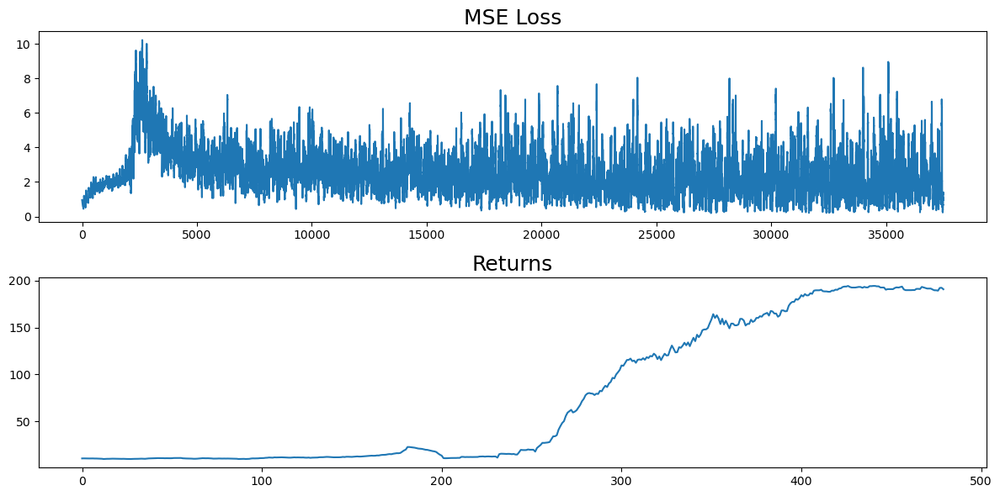

In [14]:
plot_stats(stats)

### Test the resulting agent

In [15]:
test_agent(env, policy, episodes=2)

: 

## Resources

[[1] Playing Atari with Deep Reinforcement Learning](https://www.cs.toronto.edu/~vmnih/docs/dqn.pdf)